# Merged NT Mosaic AGB zonal stats colation v4

This notebook looks for zonal stats subdirectories and the zonal stats csv outputs within them and concatenates all files into one data frame which is exported as a csv to the output directory.

The following conditions apply:

 - run after Seasonal Biomass Zonal Pipeline.
 - env = base

Adding Dp1

## Import modules

In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import pandas as pd
from glob import glob
import os
from calendar import monthrange
from datetime import datetime
import geopandas as gpd
from numpy import random
import numpy as np
from scipy.stats import poisson
# import plotting and stats modules
# import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt

### Define file name to composite

In [2]:
# Dictionary identifies the data structure of the reference image

dict_ = {"dbi_zonal_stats": "seasonal", 
         "dim_zonal_stats": "seasonal",
"dis_zonal_stats": "seasonal",
"dja_zonal_stats": "seasonal",
"dka_zonal_stats": "annual",
"dp1_zonal_stats": "multi_unknown",
"fpc_zonal_stats": "single",
"fpca2_zonal_stats": "seasonal",
"h99a2_zonal_stats": "seasonal",
"pg_zonal_stats": "seasonal",
"ref_zonal_stats": "single",
"stc_zonal_stats": "seasonal",
"th_zonal_stats": "seasonal"
}

### Enter variables

In [3]:
# drive
drive = "D"
# processing date
date = "20230203"

# date of data exports
field_date = "20230202"

In [4]:
dir_ = r"{0}:\cdu\data\zonal_stats\nt_mosaic\rmcgr_nt_mosaic_20230116_0905".format(drive)
output_dir = r"{0}:\cdu\data\zonal_stats\output\{1}".format(drive, date)
no_fire_scar_dir = os.path.join(output_dir, "no_fire_scar_zonal")
fire_scar_dir = os.path.join(output_dir, "fire_scar_zonal_stats")
fire_mask_dir = os.path.join(output_dir, "fire_mask")
fms_dir = os.path.join(fire_mask_dir, "site")
no_fire_scar_basal_dir = os.path.join(output_dir, "no_fire_scar_zonal_basal")
w_no_fire_scar_basal_dir = os.path.join(output_dir, "with_no_fire_scar_zonal_basal")
revised_fire_scar_dir = os.path.join(output_dir, "revised_fire_scar_zonal_stats")
szs_dir = os.path.join(output_dir, "seasonal_zonal_stats")
ftzs_dir = os.path.join(output_dir, "file_type_zonal_stats")

In [5]:
def mk_dir_fn(dir_):
    if not os.path.isdir(dir_):
        os.mkdir(dir_)
        
def export_csv_fn(list_, dir_, file_name):
    
    df_final = pd.concat(list_, axis =0)    
    output_path = os.path.join(dir_, file_name)
    df_final.to_csv(os.path.join(output_path), index=False)
    print("File output to: ", output_path)
    
    return df_final

In [6]:
mk_dir_fn(output_dir)
mk_dir_fn(no_fire_scar_dir)
mk_dir_fn(fire_scar_dir)
mk_dir_fn(fire_mask_dir)
mk_dir_fn(fms_dir)
mk_dir_fn(no_fire_scar_basal_dir)
mk_dir_fn(w_no_fire_scar_basal_dir)
mk_dir_fn(revised_fire_scar_dir)
mk_dir_fn(szs_dir)
mk_dir_fn(ftzs_dir)


In [7]:
basal = r"{0}:\cdu\data\output\{1}\slats_tern_biomass.csv".format(drive, field_date)
basal_df = pd.read_csv(basal)
print(basal_df.shape)
basal_df.drop_duplicates(inplace=True)
print(basal_df.shape)

(167, 21)
(167, 21)


In [8]:
dp1 = r"{0}:\cdu\data\zonal_stats\output\{1}\dp1_zonal_concat.csv".format(drive, field_date)
dp1_df = pd.read_csv(dp1)

## Define Functions

### NT Mosaic functions

In [9]:
def start_seasonal_date(date_):
    """ extract the end dates of the seasonal image zonal stats."""
    
    year = date_[:4]
    month = date_[4:]
    
    start_date = str(year) + str(month) + "01"
    
    return start_date
    

def end_seasonal_date(date_):
    
    """ extract the start dates of the seasonal image zonal stats."""
    #print("date: ", date_)
    year = str(date_[:4])
    month = str(date_[4:])
    #print("month: ", month)
    
    month_, day_range = monthrange(int(year), int(month))
    end_date = str(year) + str(month) + str(day_range)
    #print(end_date)
    return end_date


def im_date_season(df):
    """Collate start date of image into im_date column"""
    
    st_date_list = []
    e_date_list = []
    for i in df.im_name:
        #print(i)
        list_name = i.split("_")
        date = list_name[-2]
        st_date = date[1:7]
        start_date = start_seasonal_date(st_date)
        st_date_list.append(start_date)
        
        e_date = date[7:] 
        end_date = end_seasonal_date(e_date)
        e_date_list.append(end_date)
        
    df["im_s_date"] = st_date_list
    df["im_e_date"] = e_date_list
    
    return df
        
    
def im_date_annual(df):
    """Collate start date of image into im_date column"""
    
    st_date_list = []
    e_date_list = []
    for i in df.im_date:
        print(i)
#         list_name = i.split("_")
#         date = str(i) + "0101" #list_name[-2]
        st_date = str(i) + "01"
        start_date = start_seasonal_date(st_date)
        st_date_list.append(start_date)
        
        e_date = str(i) + "12"
        print(e_date)
        end_date = end_seasonal_date(e_date)
        e_date_list.append(end_date)
        
    df["s_date"] = st_date_list
    df["e_date"] = e_date_list
    
    return df

    
def convert_to_datetime(df, col_nm_s, col_nm_d):
    
    date_list = []
    for i in df[col_nm_s]:
        #print(i)
        datetime_object = datetime.strptime(str(i), '%Y%m%d')
        date_list.append(datetime_object)
        print(datetime_object)
        #df[col_nm_d] =  pd.to_datetime(df[col_nm_s], format='%Y%m%d.%f')
        #date_time = now.strftime("%m/%d/%Y, %H:%M:%S")
    df[col_nm_d] = date_list
    return df        


def convert_to_dt_year(df, col_nm_s, col_nm_d):
    
    date_list = []
    for i in df[col_nm_s]:
        #print(i)
        datetime_object = datetime.strptime(str(i), '%Y')
        date_list.append(datetime_object)
        print(datetime_object)
        #df[col_nm_d] =  pd.to_datetime(df[col_nm_s], format='%Y%m%d.%f')
        #date_time = now.strftime("%m/%d/%Y, %H:%M:%S")
    df[col_nm_d] = date_list
    return df 

In [10]:
basal_df = convert_to_datetime(basal_df, "date", "basal_dt")
basal_df.sort_values(by='basal_dt', inplace=True)

2012-04-17 00:00:00
2012-06-19 00:00:00
2012-06-20 00:00:00
2012-06-21 00:00:00
2012-06-21 00:00:00
2012-06-22 00:00:00
2012-06-22 00:00:00
2012-06-23 00:00:00
2012-06-24 00:00:00
2012-06-24 00:00:00
2012-06-24 00:00:00
2012-06-25 00:00:00
2012-06-26 00:00:00
2012-06-26 00:00:00
2012-06-26 00:00:00
2012-10-09 00:00:00
2012-10-10 00:00:00
2012-10-10 00:00:00
2012-10-11 00:00:00
2012-10-11 00:00:00
2012-10-11 00:00:00
2012-10-11 00:00:00
2012-10-11 00:00:00
2011-10-25 00:00:00
2011-10-26 00:00:00
2011-10-26 00:00:00
2011-10-26 00:00:00
2011-10-27 00:00:00
2011-10-27 00:00:00
2011-10-27 00:00:00
2021-07-13 00:00:00
2013-06-02 00:00:00
2012-06-02 00:00:00
2013-04-13 00:00:00
2013-04-14 00:00:00
2012-07-13 00:00:00
2012-06-05 00:00:00
2012-06-05 00:00:00
2013-07-16 00:00:00
2013-07-16 00:00:00
2013-07-16 00:00:00
2012-07-10 00:00:00
2012-07-10 00:00:00
2012-06-06 00:00:00
2012-05-22 00:00:00
2012-05-23 00:00:00
2012-05-23 00:00:00
2012-05-23 00:00:00
2012-05-24 00:00:00
2013-05-31 00:00:00


### Fire functions

In [11]:


def fire_percent_fn(df):
    """ Calculate the percent cover burnt by fire. """
    df.fillna(0, inplace =True)
    df["area_ha"] = (df.dka_count * (30 *30)*0.0001)
    df["jan_per"] = (df.jan / df.dka_count *100) #(30 *30)/ 1000)
    df["feb_per"] = (df.feb / df.dka_count *100)
    df["mar_per"] = (df.mar / df.dka_count *100)
    df["april_per"] = (df.april / df.dka_count *100)
    df["may_per"] = (df.may / df.dka_count *100)
    df["june_per"] = (df.june / df.dka_count *100)
    df["july_per"] = (df.july / df.dka_count *100)
    df["aug_per"] = (df.aug / df.dka_count *100)
    df["sep_per"] = (df.sep / df.dka_count *100)
    df["oct_per"] = (df.oct / df.dka_count *100)
    df["nov_per"] = (df.nov / df.dka_count *100)
    df["dec_per"] = (df.dec / df.dka_count *100)
    
    return df

def fire_yn_fn(df):
    
    """ Score if fire occured during the year 0 = No, 1 = yes. """
    fire_1_0 = []
    
    for index, row in df.iterrows():
        
        if row.dka_major == 0:
            fire_1_0.append(0)
        else:
            fire_1_0.append(1)
            
    df['burnt'] = fire_1_0
    
    return df
    
    
def fire_intensity_fn(df):
    
    """ Score fire intensity by majority burnt 0 = no fire, 1 = Jan - June, 2 July - December """
    
    list_ = []
    
    for index, row in df.iterrows():
                
        if row.dka_major == 0:
            list_.append(0)
            
            
        elif row.dka_major > 1 and row.dka_major < 7 :
            list_.append(1)
        else:
            list_.append(2)
            
    df['intens'] = list_
    
    return df


def ratio_fire_year_fn(x, y, p, n):

    # data number of fires per data lenght of time = x/y
    # revised time frame i.e. number of fires per time restriction = p/n
    
    final =  (x*n) / (p*y) 
    
    return final



def prop_fire_freq_fn(df):
    list_ = []
    for i in df.site.unique():
        df1 = df[df["site"]==i]

        burnt_sum = df1.burnt.sum()
          # calculate average time between fires over years of data capture
        if burnt_sum > 0:
            
            freq = ratio_fire_year_fn(1, 10, burnt_sum, (len(df1.index)))
            
            frequency = round(freq, 5) #round((len(df1.index)) / burnt_sum, 5)
        else:
            frequency = round(0/10, 5) # round(len(df1.index), 5)
                         
        df1["fire_f"] = frequency
        df1["fire_tot"] = burnt_sum = df1.burnt.sum()

        list_.append(df1)
        
    df2 = pd.concat(list_, axis = 0)
    return df2

    
def fire_previous_year(df):
    list_ = []
    df.dropna(inplace=True)
    for i in df.site.unique():
        years_since_list = []
        print(i)
        df1 = df[df["site"]==i]
        
        df1.sort_values(by="s_date", inplace=True, ascending=True)
#         print(df1)
        
        no_fire_list = []

        loop_x = 1
        for index, row in df1.iterrows():
            x = row["burnt"]
            print(loop_x)
            print("burnt: ", x)
#             print("len of list: ", len(no_fire_list))
            if x == 0:
                if loop_x == 1:
                    print(f"No fire recorded on {str(row['s_date'])}, it is unknown if a fire occured the year before - nan appended")
                    years_since_list.append(np.nan)
                else:
                    
                    no_fire_list.append(1)
                    print(f"No fire recorded on {str(row['s_date'])}, however, fire was recorded {str(len(no_fire_list))} year ago - {str(len(no_fire_list))} appended")
                    years_since_list.append(len(no_fire_list))

            else:
                if loop_x == 1:
                    print(f"Fire recorded on {str(row['s_date'])}, it is unknown if a fire occured the year before - nan appended")
                    years_since_list.append(np.nan)
                else:
                    print(f"Fire recorded on {str(row['s_date'])}, and fire was recorded {str(len(no_fire_list)+1)} year ago - {str(len(no_fire_list)+1)} appended")
                    years_since_list.append(len(no_fire_list)+1)
                    no_fire_list = []
            loop_x += 1
                    
        print("years_since: ", years_since_list)
        df1["since_fire"] = years_since_list
        list_.append(df1)
                
            
    df3 = pd.concat(list_, axis=0)    
    return(df3)

                
    return(df3)  

def fire_gap_fn(df):
    
    list_ = []
    df.dropna(inplace=True)
    
    for i in df.site.unique():
        years_since_list = []
        print(i)
        df1 = df[df["site"]==i]
        
        x = df1.since_fire.mean()
        print("x: ", x)
        
        df1["fire_gap"] = x

        list_.append(df1)
    
    df2 = pd.concat(list_, axis=0) 
    
    return df2
                       
    
def ratio_fire_year_fn(x, y, p, n):

    # data number of fires per data lenght of time = x/y
    # revised time frame i.e. number of fires per time restriction = p/n
    
    final =  (x*n) / (p*y) 
    
    return final


def poisson_fn(df, p, n):
    
    list_ = []
    df.dropna(inplace=True)
    
    for i in df.site.unique():
        years_since_list = []
        print(i)
        df1 = df[df["site"]==i]
        

        x = df1["fire_tot"].tolist()[0] # average number of fires per data total years 
        y = len(df1.index)+1 # total number of years
        n = n # number of year time frame 
        p = p # how many fires per n


        k = np.arange(0, n + 1)
        # print(k)

        m = ratio_fire_year_fn(x, y, p, n)
        print(m)

        pmf = poisson.pmf(k, mu=m)
        pmf = np.round(pmf, 5)

        print(pmf)

        for val, prob in zip(k, pmf):
            if val == p:
                print(f"Within a {n} period, there is a {prob*100} that {val} fires will occur.")
        
        df1[f"fire_pois{p}_{n}"] = prob*100
        
        list_.append(df1)

    
    
    df2 = pd.concat(list_, axis=0) 
    
    return df2


def double_digit_month_fn(d, year_):
    print(d)
    
    if int(d) < 10:
        month_ = f"0{d}"
    else:
        month_ = f"{d}"  
    year_month = f"{str(year_)}{month_}"

                        
    return year_month


def fire_scar_year_month_fn(df, month_list):
    """ Calculate the percent cover burnt by fire. """
    df.fillna(0, inplace =True)
    site_list = []
    burnt_start_list = []
    burnt_end_list = []
    burnt_year_list = []
    
    for index, row in df.iterrows():
        month__ = []
        site_list.append(row.site)
        burnt_year_list.append(str(row.im_date))
        burnt_month_list = []
        for month, d in zip(month_list, month_d_list):
                
            if int(row[f"{month}"]) > 0:
                
                month__.append(d)

                
                if d < 10:
                    month_ = f"0{d}"
                else:
                    month_ = f"{d}"  
                year_month = f"{str(row.im_date)}{month_}"
                burnt_month_list.append(year_month)
                
        acend_month_list = sorted(month__, reverse=False)

        if month__:
            if len(month__) > 1:          
                year_month = double_digit_month_fn(str(month__[0]), str(row.im_date))
                print(f"{row.site} has the following fire scars: {acend_month_list}")
                burnt_start_list.append(year_month)
                burnt_end_list.append(year_month)
                

            else:
                #calculate first fire scar
                year_month = double_digit_month_fn(str(month__[0]), str(row.im_date))
                print(f"{row.site} has the following fire scars: {acend_month_list}")
                burnt_start_list.append(year_month)
                
                        
                # calculate last fire scar        
                year_month = double_digit_month_fn(str(month__[-1]), str(row.im_date))
                print(f"{row.site} has the following fire scars: {acend_month_list}")
                burnt_end_list.append(year_month)
                
        else:
            burnt_start_list.append(0)
            burnt_end_list.append(0)
                           
    return site_list, burnt_start_list, burnt_end_list, burnt_year_list
    

In [12]:
def export_csv_file_fn(df, dir_, file_name):
    
    output_path = os.path.join(dir_, file_name)
    df.to_csv(os.path.join(output_path), index=False)
    print("File output to: ", output_path)
            
            

## Concatinate individual site data per type and export df's and merge data asof with basal

In [13]:
sub_list = next(os.walk(dir_))[1]

In [14]:
# zonal_list = []
sub_dir_list = []
# single_list = []
# year_list = []
# seasonal_list = []
# dja_list = []
# dbi_list = []
# dim_list = []
# dis_list = []
# dka_list = []
# dp0_list = []
# dp1_list = []
# h99a2_list = []
# fpca2_list = []
# stc_list = []



cleaned_df_list = []
cleaned_str_list = []



#create lists for merged ouput data
dka_0112_list = []

dim_0305_list = []
dim_0608_list = []
dim_0911_list = []
dim_1202_list =[]
                    
dis_0305_list = []
dis_0608_list = []
dis_0911_list = []
dis_1202_list =[]

# dbi_0305_list = []
dbi_0608_list = []
dbi_0911_list = []
dbi_1202_list =[]

dja_0305_list = []
dja_0608_list = []
dja_0911_list = []
dja_1202_list =[]

h99a2_0112_list = []
fpca2_0509_list = []

stc_0112_list = []



for sub_dir in sub_list:

    file_list = []
    if "zonal_stats" in sub_dir:
        sub_dir_list.append(sub_dir)
#         print(sub_dir)
#         print("looking in : ", os.path.join(dir_, sub_dir, "*.csv"))
        for file_ in glob(os.path.join(dir_, sub_dir, "*.csv")):
#             print(file_)
            df = pd.read_csv(file_)
            file_list.append(df)
#             print("appended: ", file_)
            
    if len(file_list) > 1:
        df1 = pd.concat(file_list)
#         print("+"*50)
#         print(df1.shape)

        if "date" in df1.columns and "im_date" not in df1.columns:
#             print(df1.columns)
            
            df1.rename(columns = {"date": "im_date"}, inplace = True)
            
#             print(df1.columns)
            

        print("+"*50)
        print(sub_dir)
        print("+"*50)
        
        if sub_dir == "dka_zonal_stats":
#         if sub_dir == "dka_zonal_stats":
#             print(df1.columns)
            dka = df1.copy(deep = True)
            if "date" in dka.columns and "im_date" not in dka.columns:
#                 print(dka.columns)

                dka.rename(columns = {"date": "im_date"}, inplace = True)
            dka = im_date_annual(dka)
            
            var_ = "dka"
            dka_dict = {"count":  "{0}_count".format(var_), 
                        "min": "{0}_min".format(var_), 
                        "max" :"{0}_max".format(var_),
                        "mean": "{0}_mean".format(var_), 
                        "sum": "{0}_sum".format(var_), 
                        "std": "{0}_std".format(var_), 
                        "median": "{0}_med".format(var_),
                         "majority" : "{0}_major".format(var_), 
                        "minority": "{0}_minor".format(var_), 
                        "one": "{0}_one".format(var_), 
                        "two": "{0}_two".format(var_), 
                        "three": "{0}_three".format(var_), 
                        "four": "{0}_four".format(var_), 
                        "five": "{0}_five".format(var_), 
                        "six": "{0}_six".format(var_), 
                        "seven": "{0}_seven".format(var_), 
                        "eight": "{0}_eight".format(var_), 
                         "nine" : "{0}_nine".format(var_), 
                        "ten": "{0}_ten".format(var_)}
                        
                           
            dka.rename(columns = dka_dict, inplace = True)

            dka_s_ = convert_to_datetime(dka, "s_date", "image_s_dt")
            dka_s = convert_to_datetime(dka_s_, "e_date", "image_e_dt")
            dka_s.sort_values(by="s_date", inplace=True)
            dka_s.dropna(subset = ['dka_min'], inplace=True)
            
            # call fire frequency etc functions
            dka_s = fire_percent_fn(dka_s)
            dka_s = fire_yn_fn(dka_s)
            dka_s = fire_intensity_fn(dka_s)
            dka_s = prop_fire_freq_fn(dka_s)
            dka_s = fire_previous_year(dka_s)
            dka_s = fire_gap_fn(dka_s)
            dka_s = poisson_fn(dka_s, 1, 2)
            dka_s = poisson_fn(dka_s, 1, 5)
            dka_s = poisson_fn(dka_s, 1, 10)
            
#             dka_s.to_csv(os.path.join(temp_dir, "s_dkk.csv"), index=False)
            
#             dka_s = fire_fn(dka_s)
#             df = dka_s[dka_s['dka_min'].isnull()]
#             print("+"*100)
#             print(df.shape)
            dka_s.sort_values(by="image_s_dt", inplace=True)
            dka_s.dropna(subset = ['dka_min'], inplace=True)
            print(dka_s.shape)
            dka_s.drop_duplicates(inplace=True)
            print(dka_s.shape)
            
            export_csv_file_fn(dka_s, ftzs_dir, "dka_all_seasons_zonal_stats.csv")
            cleaned_df_list.append(dka_s)
            cleaned_str_list.append("dka_0112")
            

#             basal_df.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\seasonal_zonal_stats\test_basal_dd.csv")
            #merge data with basal datset based on the nearest date to the field data colection
            dka_s_single = pd.merge_asof(basal_df, dka_s, left_on="basal_dt", right_on= "image_s_dt", by="site", direction="forward")
            
            export_csv_file_fn(dka_s_single, revised_fire_scar_dir, "merged_slats_field_agb_nt_mosaic_dka_start.csv")
            
            dka_0112_list.append(dka_s)
            
            print("DKA - Done")
            
            
        elif sub_dir == "dim_zonal_stats":
            
            # REVISED FOR SEASONAL
            
            print(df1.columns)
            dim = df1.copy(deep = True)
            
#             output_path = os.path.join(szs_dir, "dim_all_seasons_zonal_stats.csv")
#             dim.to_csv(os.path.join(output_path), index=False)
#             print("File output to: ", output_path)
            dim_s_ = convert_to_datetime(dim, "s_date", "image_s_dt")
            dim_s = convert_to_datetime(dim_s_, "e_date", "image_e_dt")
            dim_s.sort_values(by="s_date", inplace=True)
            dim_s.dropna(subset = ['b1_dim_min'], inplace=True)
            print(dim_s.shape)
            
            export_csv_file_fn(dim_s, ftzs_dir, "dim_all_seasons_zonal_stats.csv")

            
            dim_0305 = dim_s[dim_s["s_month"]==3]
            print("dim_0305.shape: ", dim_0305.shape)
            dim_0608 = dim_s[dim_s["s_month"]==6]
            print("dim_0608.shape: ", dim_0608.shape)
            dim_0911 = dim_s[dim_s["s_month"]==9]
            print("dim_0911.shape: ", dim_0911.shape)
            dim_1202 = dim_s[dim_s["s_month"]==12]
            print("dim_1202.shape: ", dim_1202.shape)
            print("-"*50)
            
            
            export_csv_file_fn(dim_0305, szs_dir, "dim_0305_zonal_stats.csv")
            export_csv_file_fn(dim_0608, szs_dir, "dim_0608_zonal_stats.csv")
            export_csv_file_fn(dim_0911, szs_dir, "dim_0911_zonal_stats.csv")
            export_csv_file_fn(dim_1202, szs_dir, "dim_1202_zonal_stats.csv")
            
            # append data to list 
            cleaned_df_list.append(dim_0305)
            cleaned_str_list.append("dim_0305")
            
            cleaned_df_list.append(dim_0608)
            cleaned_str_list.append("dim_0608")
            
            cleaned_df_list.append(dim_0911)
            cleaned_str_list.append("dim_0911")
            
            cleaned_df_list.append(dim_1202)
            cleaned_str_list.append("dim_1202")
            
                 
            for df_x, x_str in zip([dim_0305, dim_0608, dim_0911, dim_1202],["dim_0305", "dim_0608", "dim_0911", "dim_1202"]):
            
#                 dim_s = convert_to_datetime(df_x, "s_date", "image_s_dt")
#                 dim_s.sort_values(by="s_date", inplace=True)
#                 dim_s.dropna(subset = ['b1_dim_min'], inplace=True)
#                 print(dim_s.shape)

                #merge data with basal datset based on the nearest date to the field data colection
                dim_s_single = pd.merge_asof(basal_df, df_x, left_on="basal_dt", right_on= "image_s_dt", by="site", direction="forward")
                dim_s_single.rename(columns = {"uid_x": "uid", "uid_y": f"uid_{x_str}"}, inplace = True)
            
                export_csv_file_fn(dim_s_single, revised_fire_scar_dir, f"agb_nt_mosaic_{x_str}_fs_not_ext.csv")
                
                if x_str == "dim_0305":
                    dim_0305_list.append(dim_s_single)
                elif x_str == "dim_0608":
                    dim_0608_list.append(dim_s_single)
                elif x_str == "dim_0911":
                    dim_0911_list.append(dim_s_single)
                elif x_str == "dim_1202":
                    dim_1202_list.append(dim_s_single)
                else:
                    print("DIM error")
                    import sys
                    sys.exit()
                    
            print("DIM Done")
            
            

        elif sub_dir == "dis_zonal_stats":
            
            # WORKING - SEASONAL SPLIT
            print(df1.columns)
            dis_ = df1.copy(deep = True)
            
            var_ = "dis"
            dis_dict = {"count":  "{0}_count".format(var_), 
                        "min": "{0}_min".format(var_), 
                        "max" :"{0}_max".format(var_),
                        "mean": "{0}_mean".format(var_), 
                        "sum": "{0}_sum".format(var_), 
                        "std": "{0}_std".format(var_), 
                        "median": "{0}_med".format(var_),
                         "majority" : "{0}_major".format(var_), 
                        "minority": "{0}_minor".format(var_), 
                        "one": "{0}_one".format(var_), 
                        "two": "{0}_two".format(var_), 
                        "three": "{0}_three".format(var_), 
                        "four": "{0}_four".format(var_), 
                        "five": "{0}_five".format(var_), 
                        "six": "{0}_six".format(var_), 
                        "seven": "{0}_seven".format(var_), 
                        "eight": "{0}_eight".format(var_), 
                         "nine" : "{0}_nine".format(var_), 
                        "ten": "{0}_ten".format(var_)}


            dis_.rename(columns = dis_dict, inplace = True)

            dis_s_ = convert_to_datetime(dis_, "s_date", "image_s_dt")
            dis_s = convert_to_datetime(dis_s_, "e_date", "image_e_dt")
            dis_s.sort_values(by="s_date", inplace=True)
            dis_s.dropna(subset = ['dis_min'], inplace=True)
            
            export_csv_file_fn(dis_s, ftzs_dir, "dis_all_seasons_zonal_stats.csv")       
                
            dis_0305 = dis_s[dis_s["s_month"]==3]
            dis_0608 = dis_s[dis_s["s_month"]==6]
            dis_0911 = dis_s[dis_s["s_month"]==9]
            dis_1202 = dis_s[dis_s["s_month"]==12]
            
            export_csv_file_fn(dis_0305, szs_dir, "dis_0305_zonal_stats.csv")
            export_csv_file_fn(dis_0608, szs_dir, "dis_0608_zonal_stats.csv")
            export_csv_file_fn(dis_0911, szs_dir, "dis_0911_zonal_stats.csv")
            export_csv_file_fn(dis_1202, szs_dir, "dis_1202_zonal_stats.csv")
            
                        
            # append data to list 
            cleaned_df_list.append(dis_0305)
            cleaned_str_list.append("dis_0305")
            
            cleaned_df_list.append(dis_0608)
            cleaned_str_list.append("dis_0608")
            
            cleaned_df_list.append(dis_0911)
            cleaned_str_list.append("dis_0911")
            
            cleaned_df_list.append(dis_1202)
            cleaned_str_list.append("dis_1202")
            
        
            for df_x, x_str in zip([dis_0305, dis_0608, dis_0911, dis_1202],["dis_0305", "dis_0608", "dis_0911", "dis_1202"]):
                                

                #merge data with basal datset based on the nearest date to the field data colection
                dis_s_single = pd.merge_asof(basal_df, dis_s, left_on="basal_dt", right_on= "image_s_dt", by="site", direction="forward")
                dis_s_single.rename(columns = {"uid_x": "uid", "uid_y": f"uid_{x_str}"}, inplace = True)
                export_csv_file_fn(dis_s_single, revised_fire_scar_dir, f"agb_nt_mosaic_{x_str}_fs_not_ext.csv")
                 
                if x_str == "dis_0305":
                    dis_0305_list.append(dis_s_single)
                elif x_str == "dis_0608":
                    dis_0608_list.append(dis_s_single)
                elif x_str == "dis_0911":
                    dis_0911_list.append(dis_s_single)
                elif x_str == "dis_1202":
                    dis_1202_list.append(dis_s_single)
                else:
                    print("dis error")
                    import sys
                    sys.exit()
                    
            print("dis Done")
                
                
        elif sub_dir == "dja_zonal_stats":

            print(df1.columns)
            dja = df1.copy(deep = True)
            
            dja_s_ = convert_to_datetime(dja, "s_date", "image_s_dt")
            dja_s = convert_to_datetime(dja_s_, "e_date", "image_e_dt")
            dja_s.sort_values(by="s_date", inplace=True)
            dja_s.dropna(subset = ['b1_dja_min'], inplace=True)


            export_csv_file_fn(dja_s, ftzs_dir, "dja_all_seasons_zonal_stats.csv")
            
            dja_0305 = dja_s[dja_s["s_month"]==3]
            dja_0608 = dja_s[dja_s["s_month"]==6]
            dja_0911 = dja_s[dja_s["s_month"]==9]
            dja_1202 = dja_s[dja_s["s_month"]==12]
            
            export_csv_file_fn(dja_0305, szs_dir, "dja_0305_zonal_stats.csv")
            export_csv_file_fn(dja_0608, szs_dir, "dja_0608_zonal_stats.csv")
            export_csv_file_fn(dja_0911, szs_dir, "dja_0911_zonal_stats.csv")
            export_csv_file_fn(dja_1202, szs_dir, "dja_1202_zonal_stats.csv")
            
            
            # append data to list 
            cleaned_df_list.append(dja_0305)
            cleaned_str_list.append("dja_0305")
            
            cleaned_df_list.append(dja_0608)
            cleaned_str_list.append("dja_0608")
            
            cleaned_df_list.append(dja_0911)
            cleaned_str_list.append("dja_0911")
            
            cleaned_df_list.append(dja_1202)
            cleaned_str_list.append("dja_1202")
            
            for df_x, x_str in zip([dja_0305, dja_0608, dja_0911, dja_1202],["dja_0305", "dja_0608", "dja_0911", "dja_1202"]):
                                

                #merge data with basal datset based on the nearest date to the field data colection
                dja_s_single = pd.merge_asof(basal_df, dja_s, left_on="basal_dt", right_on= "image_s_dt", by="site", direction="forward")
                dja_s_single.rename(columns = {"uid_x": "uid", "uid_y": f"uid_{x_str}"}, inplace = True)
                export_csv_file_fn(dja_s_single, revised_fire_scar_dir, f"agb_nt_mosaic_{x_str}_fs_not_ext.csv") 

                if x_str == "dja_0305":
                    dja_0305_list.append(dja_s_single)
                elif x_str == "dja_0608":
                    dja_0608_list.append(dja_s_single)
                elif x_str == "dja_0911":
                    dja_0911_list.append(dja_s_single)
                elif x_str == "dja_1202":
                    dja_1202_list.append(dja_s_single)
                else:
                    print("dja error")
                    import sys
                    sys.exit()
                    
            print("DJA Done")
            
        elif sub_dir == "dbi_zonal_stats":

            print(df1.columns)
            dbi = df1.copy(deep = True)
            
            dbi_s_ = convert_to_datetime(dbi, "s_date", "image_s_dt")
            dbi_s = convert_to_datetime(dbi_s_, "e_date", "image_e_dt")
            dbi_s.sort_values(by="s_date", inplace=True)
            dbi_s.dropna(subset = ['b1_dbi_min'], inplace=True)
            export_csv_file_fn(dbi_s, ftzs_dir, "dbi_all_seasons_zonal_stats.csv")
            
#             dbi_0305 = dbi_s[dbi_s["s_month"]==3]
            dbi_0608 = dbi_s[dbi_s["s_month"]==6]
            dbi_0911 = dbi_s[dbi_s["s_month"]==9]
            dbi_1202 = dbi_s[dbi_s["s_month"]==12]
            
#             export_csv_file_fn(dbi_0305, szs_dir, "dbi_0305_zonal_stats.csv")
            export_csv_file_fn(dbi_0608, szs_dir, "dbi_0608_zonal_stats.csv")
            export_csv_file_fn(dbi_0911, szs_dir, "dbi_0911_zonal_stats.csv")
            export_csv_file_fn(dbi_1202, szs_dir, "dbi_1202_zonal_stats.csv")
            
            # append data to list 
#             cleaned_df_list.append(dis_0305)
#             cleaned_str_list.append("dis_0305")
            
            cleaned_df_list.append(dbi_0608)
            cleaned_str_list.append("dbi_0608")
            
            cleaned_df_list.append(dbi_0911)
            cleaned_str_list.append("dbi_0911")
            
            cleaned_df_list.append(dbi_1202)
            cleaned_str_list.append("dbi_1202")
            
            for df_x, x_str in zip([dbi_0608, dbi_0911, dbi_1202],["dbi_0608", "dbi_0911", "dbi_1202"]):
                                

                #merge data with basal datset based on the nearest date to the field data colection
                dbi_s_single = pd.merge_asof(basal_df, dbi_s, left_on="basal_dt", right_on= "image_s_dt", by="site", direction="forward")
                dbi_s_single.rename(columns = {"uid_x": "uid", "uid_y": f"uid_{x_str}"}, inplace = True)
                export_csv_file_fn(dbi_s_single, revised_fire_scar_dir, f"agb_nt_mosaic_{x_str}_fs_not_ext.csv") 
                
#                 if x_str == "dbi_0305":
#                     dbi_0305_list.append(dbi_s_single)
                if x_str == "dbi_0608":
                    dbi_0608_list.append(dbi_s_single)
                elif x_str == "dbi_0911":
                    dbi_0911_list.append(dbi_s_single)
                elif x_str == "dbi_1202":
                    dbi_1202_list.append(dbi_s_single)
                else:
                    print("DBI Error")
                    import sys
                    sys.exit()
                    
            print("DBI Done")
            
        elif sub_dir == "h99a2_zonal_stats":
            
            print(df1.columns)
            h99a2_s = df1.copy(deep = True)
            
            h99a2_s_ = convert_to_datetime(h99a2_s, "s_date", "image_s_dt")
            h99a2_0112 = convert_to_datetime(h99a2_s_, "e_date", "image_e_dt")

            h99a2_0112_df = h99a2_0112[h99a2_0112["s_month"] == 1]
            h99a2_0112_df.sort_values(by="image_s_dt", inplace=True)
            h99a2_0112_df.dropna(subset = ['b1_h99a2_min'], inplace=True)
            
            export_csv_file_fn(h99a2_0112_df, ftzs_dir, "h99a2_all_seasons_zonal_stats.csv")
            
            # append data to list 
            cleaned_df_list.append( h99a2_0112_df)
            cleaned_str_list.append("h99a2_0112")

            h99a2_0112_s = pd.merge_asof(basal_df, h99a2_0112_df, left_on="basal_dt", right_on= "image_s_dt", by="site", direction="nearest")
            h99a2_0112_s.rename(columns = {"uid_x": "uid", "uid_y": "uid_h99a2_0112"}, inplace = True)
            export_csv_file_fn(h99a2_0112_s, revised_fire_scar_dir, f"agb_nt_mosaic_h99a2_0112_fs_not_ext.csv") 
            
            h99a2_0112_list.append(h99a2_0112_s)          
            print("H99A2 - Done")


        elif sub_dir == "fpca2_zonal_stats":
            
            print(df1.columns)
            fpca2_dry_ = df1.copy(deep = True)
            
            fpca2_dry_s_ = convert_to_datetime(fpca2_dry_, "s_date", "image_s_dt")
            fpca2_dry = convert_to_datetime(fpca2_dry_s_, "e_date", "image_e_dt")

            fpca2_dry_df = fpca2_dry[fpca2_dry["s_month"] == 5]
            fpca2_dry_df.sort_values(by="s_date", inplace=True)
            fpca2_dry_df.dropna(subset = ['b1_fpca2_min'], inplace=True)
            
            export_csv_file_fn(fpca2_dry_df, ftzs_dir, "fpca2_all_seasons_zonal_stats.csv")
            
            # append data to list 
            cleaned_df_list.append(fpca2_dry_df)
            cleaned_str_list.append("fpca2_0509")
            
            fpca2_0509 = pd.merge_asof(basal_df, fpca2_dry_df, left_on="basal_dt", right_on= "image_s_dt", by="site", direction="nearest")
            fpca2_0509.rename(columns = {"uid_x": "uid", "uid_y": "uid_fpca2_0509"}, inplace = True)
            export_csv_file_fn(fpca2_0509, revised_fire_scar_dir, f"agb_nt_mosaic_fpca2_0509_fs_not_ext.csv") 

            fpca2_0509_list.append(fpca2_0509)            
            print("FPCA2 - Done")

            
        elif sub_dir == "stc_zonal_stats":
            print(df1.columns)
            stc = df1.copy(deep = True)

            
            var_ = "stc"
            stc_dict = {"count":  "{0}_count".format(var_), 
                        "min": "{0}_min".format(var_), 
                        "max" :"{0}_max".format(var_),
                        "mean": "{0}_mean".format(var_), 
                        "sum": "{0}_sum".format(var_), 
                        "std": "{0}_std".format(var_), 
                        "median": "{0}_med".format(var_),
                         "majority" : "{0}_major".format(var_), 
                        "minority": "{0}_minor".format(var_), 
                        "one": "{0}_one".format(var_), 
                        "two": "{0}_two".format(var_), 
                        "three": "{0}_three".format(var_), 
                        "four": "{0}_four".format(var_), 
                        "five": "{0}_five".format(var_), 
                        "six": "{0}_six".format(var_), 
                        "seven": "{0}_seven".format(var_), 
                        "eight": "{0}_eight".format(var_), 
                         "nine" : "{0}_nine".format(var_), 
                        "ten": "{0}_ten".format(var_),
                        "eleven": "{0}_elev".format(var_), 
                        "twelve": "{0}_twelv".format(var_), 
                        "thirteen": "{0}_thirt".format(var_), 
                        "fourteen": "{0}_fourt".format(var_), 
                        "fifteen": "{0}_fift".format(var_), 
                        "sixteen": "{0}_sixt".format(var_), 
                        "seventeen": "{0}_sevent".format(var_)}
            
       
                           
            stc.rename(columns = stc_dict, inplace = True)

            stc_s_ = convert_to_datetime(stc, "s_date", "image_s_dt")
            stc_s = convert_to_datetime(stc_s_, "e_date", "image_e_dt")
            stc_s.sort_values(by="s_date", inplace=True)
            stc_s.dropna(subset = ['stc_min'], inplace=True)
            export_csv_file_fn(stc_s, ftzs_dir, "stc_all_seasons_zonal_stats.csv")

             # append data to list 
            cleaned_df_list.append(stc_s)
            cleaned_str_list.append("stc_0112")
            

            #merge data with basal datset based on the nearest date to the field data colection
            stc_0112 = pd.merge_asof(basal_df, stc_s, left_on="basal_dt", right_on= "image_s_dt", by="site", direction="forward")
            stc_0112.rename(columns = {"uid_x": "uid", "uid_y": "uid_stc_0112"}, inplace = True)
            export_csv_file_fn(stc_0112, revised_fire_scar_dir, f"agb_nt_mosaic_stc_0112_fs_not_ext.csv") 

            stc_0112_list.append(stc_0112)            
            print("STC - Done")
            

        else:
            print("FAILED")
            print("+"*50)
            print(sub_dir)
            print("+"*50)
            import sys
            sys.exit()
            
# # ------------------------------- Basal ----------------------------------------

stc_0112_basal_nfs = export_csv_fn(stc_0112_list, w_no_fire_scar_basal_dir, "stc_0112_basal_with_y_fire_mask_not_applied.csv")
fpca_0509_basal_nfs = export_csv_fn(fpca2_0509_list, w_no_fire_scar_basal_dir, "fpca2_0509_basal_with_y_fire_mask_not_applied.csv")
h99a_0112_basal_nfs = export_csv_fn(h99a2_0112_list, w_no_fire_scar_basal_dir, "h99a_0112_basal_with_y_fire_mask_not_applied.csv")

dbi_0608_basal_nfs = export_csv_fn(dbi_0608_list, w_no_fire_scar_basal_dir, "dbi_0608_basal_with_y_fire_mask_not_applied.csv")
dbi_0911_basal_nfs = export_csv_fn(dbi_0911_list, w_no_fire_scar_basal_dir, "dbi_0911_basal_with_y_fire_mask_not_applied.csv")
dbi_1202_basal_nfs = export_csv_fn(dbi_1202_list, w_no_fire_scar_basal_dir, "dbi_1202_basal_with_y_fire_mask_not_applied.csv")

dja_0305_basal_nfs = export_csv_fn(dja_0305_list, w_no_fire_scar_basal_dir, "dja_0305_basal_with_y_fire_mask_not_applied.csv")
dja_0608_basal_nfs = export_csv_fn(dja_0608_list, w_no_fire_scar_basal_dir, "dja_0608_basal_with_y_fire_mask_not_applied.csv")
dja_0911_basal_nfs = export_csv_fn(dja_0911_list, w_no_fire_scar_basal_dir, "dja_0911_basal_with_y_fire_mask_not_applied.csv")
dja_1202_basal_nfs = export_csv_fn(dja_1202_list, w_no_fire_scar_basal_dir, "dja_1202_basal_with_y_fire_mask_not_applied.csv")

dis_0305_basal_nfs = export_csv_fn(dis_0305_list, w_no_fire_scar_basal_dir, "dis_0305_basal_with_y_fire_mask_not_applied.csv")
dis_0608_basal_nfs = export_csv_fn(dis_0608_list, w_no_fire_scar_basal_dir, "dis_0608_basal_with_y_fire_mask_not_applied.csv")
dis_0911_basal_nfs = export_csv_fn(dis_0911_list, w_no_fire_scar_basal_dir, "dis_0911_basal_with_y_fire_mask_not_applied.csv")
dis_1202_basal_nfs = export_csv_fn(dis_1202_list, w_no_fire_scar_basal_dir, "dis_1202_basal_with_y_fire_mask_not_applied.csv")

dim_0305_basal_nfs = export_csv_fn(dim_0305_list, w_no_fire_scar_basal_dir, "dim_0305_basal_with_y_fire_mask_not_applied.csv")
dim_0608_basal_nfs = export_csv_fn(dim_0608_list, w_no_fire_scar_basal_dir, "dim_0608_basal_with_y_fire_mask_not_applied.csv")
dim_0911_basal_nfs = export_csv_fn(dim_0911_list, w_no_fire_scar_basal_dir, "dim_0911_basal_with_y_fire_mask_not_applied.csv")
dim_1202_basal_nfs = export_csv_fn(dim_1202_list, w_no_fire_scar_basal_dir, "dim_1202_basal_with_y_fire_mask_not_applied.csv")




++++++++++++++++++++++++++++++++++++++++++++++++++
dbi_zonal_stats
++++++++++++++++++++++++++++++++++++++++++++++++++
Index(['uid', 'site', 'image', 's_day', 's_month', 's_year', 's_date', 'e_day',
       'e_month', 'e_year', 'e_date', 'b1_dbi_count', 'b1_dbi_min',
       'b1_dbi_max', 'b1_dbi_mean', 'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25',
       'b1_dbi_p50', 'b1_dbi_p75', 'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range',
       'b2_dbi_count', 'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med',
       'b2_dbi_std', 'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95',
       'b2_dbi_p99', 'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min',
       'b3_dbi_max', 'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25',
       'b3_dbi_p50', 'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max', 'b4_dbi_mean', 'b4_dbi_med',
       'b4_dbi_std', 'b4_dbi_p25', 'b4_dbi_p50', 'b4_dbi_p75', 'b4_dbi_p95',
       'b4_dbi_p99', 'b4_dbi_range', 'b

File output to:  D:\cdu\data\zonal_stats\output\20230203\file_type_zonal_stats\dbi_all_seasons_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dbi_0608_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dbi_0911_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dbi_1202_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_dbi_0608_fs_not_ext.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_dbi_0911_fs_not_ext.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_dbi_1202_fs_not_ext.csv
DBI Done
++++++++++++++++++++++++++++++++++++++++++++++++++
dim_zonal_stats
++++++++++++++++++++++++++++++++++++++++++++++++++
Index(['uid', 'site', 'image', 's_day', 's_month', 's_year', 's_date', 'e_day'

2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2022-09-01 00:00:00


2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00


2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00


1997-12-01 00:00:00
1998-03-01 00:00:00
1998-06-01 00:00:00
1998-09-01 00:00:00
1998-12-01 00:00:00
1999-03-01 00:00:00
1999-06-01 00:00:00
1999-09-01 00:00:00
1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00


2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2022-09-01 00:00:00
1987-03-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00


2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00


2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2022-09-01 00:00:00
1987-03-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00
1987-12-01 00:00:00
1988-03-01 00:00:00
1988-06-01 00:00:00
1988-09-01 00:00:00
1988-12-01 00:00:00
1989-03-01 00:00:00
1989-06-01 00:00:00
1989-09-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00


2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00


2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2022-09-01 00:00:00
1987-03-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00
1987-12-01 00:00:00
1988-03-01 00:00:00
1988-06-01 00:00:00
1988-09-01 00:00:00
1988-12-01 00:00:00
1989-03-01 00:00:00
1989-06-01 00:00:00
1989-09-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00
1991-12-01 00:00:00
1992-03-01 00:00:00
1992-06-01 00:00:00
1992-09-01 00:00:00
1992-12-01 00:00:00
1993-03-01 00:00:00
1993-06-01 00:00:00
1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00
1995-09-01 00:00:00
1995-12-01 00:00:00
1996-03-01 00:00:00
1996-06-01 00:00:00
1996-09-01 00:00:00
1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00


2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2022-09-01 00:00:00
1987-03-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00
1987-12-01 00:00:00
1988-03-01 00:00:00
1988-06-01 00:00:00
1988-09-01 00:00:00
1988-12-01 00:00:00
1989-03-01 00:00:00
1989-06-01 00:00:00
1989-09-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00
1991-12-01 00:00:00
1992-03-01 00:00:00
1992-06-01 00:00:00
1992-09-01 00:00:00
1992-12-01 00:00:00
1993-03-01 00:00:00
1993-06-01 00:00:00
1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00


1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00
1998-03-01 00:00:00
1998-06-01 00:00:00
1998-09-01 00:00:00
1998-12-01 00:00:00
1999-03-01 00:00:00
1999-06-01 00:00:00
1999-09-01 00:00:00
1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00


2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2022-09-01 00:00:00
1987-03-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00
1987-12-01 00:00:00
1988-03-01 00:00:00
1988-06-01 00:00:00
1988-09-01 00:00:00
1988-12-01 00:00:00
1989-03-01 00:00:00
1989-06-01 00:00:00
1989-09-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00


2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2022-09-01 00:00:00
1987-03-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00


1992-03-01 00:00:00
1992-06-01 00:00:00
1992-09-01 00:00:00
1992-12-01 00:00:00
1993-03-01 00:00:00
1993-06-01 00:00:00
1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00
1995-09-01 00:00:00
1995-12-01 00:00:00
1996-03-01 00:00:00
1996-06-01 00:00:00
1996-09-01 00:00:00
1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00
1998-03-01 00:00:00
1998-06-01 00:00:00
1998-09-01 00:00:00
1998-12-01 00:00:00
1999-03-01 00:00:00
1999-06-01 00:00:00
1999-09-01 00:00:00
1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00


2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00


2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2022-09-01 00:00:00
1987-03-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00
1987-12-01 00:00:00
1988-03-01 00:00:00
1988-06-01 00:00:00
1988-09-01 00:00:00
1988-12-01 00:00:00
1989-03-01 00:00:00
1989-06-01 00:00:00
1989-09-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00
1991-12-01 00:00:00
1992-03-01 00:00:00
1992-06-01 00:00:00
1992-09-01 00:00:00
1992-12-01 00:00:00
1993-03-01 00:00:00
1993-06-01 00:00:00
1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00
1995-09-01 00:00:00
1995-12-01 00:00:00
1996-03-01 00:00:00


2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2022-09-01 00:00:00
1987-03-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00
1987-12-01 00:00:00
1988-03-01 00:00:00
1988-06-01 00:00:00
1988-09-01 00:00:00
1988-12-01 00:00:00
1989-03-01 00:00:00
1989-06-01 00:00:00
1989-09-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00
1991-12-01 00:00:00
1992-03-01 00:00:00
1992-06-01 00:00:00


2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00


1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00


2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00
2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00
2019-02-28 00:00:00
2019-05-31 00:00:00
2019-08-31 00:00:00
2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-11-30 00:00:00
1987-05-31 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00


2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00
2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00
2019-02-28 00:00:00
2019-05-31 00:00:00
2019-08-31 00:00:00
2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-11-30 00:00:00
1987-05-31 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00


2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00
2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00


2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00
2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00
2019-02-28 00:00:00
2019-05-31 00:00:00
2019-08-31 00:00:00
2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-11-30 00:00:00
1987-05-31 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00


2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00
2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00
2019-02-28 00:00:00
2019-05-31 00:00:00
2019-08-31 00:00:00
2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-11-30 00:00:00
1987-05-31 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00


2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00
2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00
2019-02-28 00:00:00
2019-05-31 00:00:00
2019-08-31 00:00:00
2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00


2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-11-30 00:00:00
1987-05-31 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00


1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00


1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00


1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00


1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00


2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00
2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00
2019-02-28 00:00:00
2019-05-31 00:00:00
2019-08-31 00:00:00
2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-11-30 00:00:00
1987-05-31 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00


2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00


1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00


2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-11-30 00:00:00
1987-05-31 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00


2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00
2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00
2019-02-28 00:00:00
2019-05-31 00:00:00
2019-08-31 00:00:00
2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-11-30 00:00:00
1987-05-31 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00


File output to:  D:\cdu\data\zonal_stats\output\20230203\file_type_zonal_stats\dim_all_seasons_zonal_stats.csv
dim_0305.shape:  (5049, 49)
dim_0608.shape:  (5587, 49)
dim_0911.shape:  (5501, 49)
dim_1202.shape:  (3584, 49)
--------------------------------------------------
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dim_0305_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dim_0608_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dim_0911_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dim_1202_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_dim_0305_fs_not_ext.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_dim_0608_fs_not_ext.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised

2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2021-12-01 00:00:00
2022-09-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00
1987-12-01 00:00:00
1988-03-01 00:00:00
1988-06-01 00:00:00
1988-09-01 00:00:00
1988-12-01 00:00:00
1989-03-01 00:00:00
1989-06-01 00:00:00
1989-09-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00
1991-12-01 00:00:00
1992-03-01 00:00:00


1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00
1995-09-01 00:00:00
1995-12-01 00:00:00
1996-03-01 00:00:00
1996-06-01 00:00:00
1996-09-01 00:00:00
1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00
1998-03-01 00:00:00
1998-06-01 00:00:00
1998-09-01 00:00:00
1998-12-01 00:00:00
1999-03-01 00:00:00
1999-06-01 00:00:00
1999-09-01 00:00:00
1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00


2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00


1989-03-01 00:00:00
1989-06-01 00:00:00
1989-09-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00
1991-12-01 00:00:00
1992-03-01 00:00:00
1992-06-01 00:00:00
1992-09-01 00:00:00
1992-12-01 00:00:00
1993-03-01 00:00:00
1993-06-01 00:00:00
1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00
1995-09-01 00:00:00
1995-12-01 00:00:00
1996-03-01 00:00:00
1996-06-01 00:00:00
1996-09-01 00:00:00
1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00
1998-03-01 00:00:00
1998-06-01 00:00:00
1998-09-01 00:00:00
1998-12-01 00:00:00
1999-03-01 00:00:00
1999-06-01 00:00:00
1999-09-01 00:00:00
1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00


1992-09-01 00:00:00
1992-12-01 00:00:00
1993-03-01 00:00:00
1993-06-01 00:00:00
1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00
1995-09-01 00:00:00
1995-12-01 00:00:00
1996-03-01 00:00:00
1996-06-01 00:00:00
1996-09-01 00:00:00
1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00
1998-03-01 00:00:00
1998-06-01 00:00:00
1998-09-01 00:00:00
1998-12-01 00:00:00
1999-03-01 00:00:00
1999-06-01 00:00:00
1999-09-01 00:00:00
1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00


1998-12-01 00:00:00
1999-03-01 00:00:00
1999-06-01 00:00:00
1999-09-01 00:00:00
1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00


2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00


2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00


2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2021-12-01 00:00:00
2022-09-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00
1987-12-01 00:00:00


2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00


2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00


2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00


2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2021-12-01 00:00:00
2022-09-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00
1987-12-01 00:00:00
1988-03-01 00:00:00
1988-06-01 00:00:00
1988-09-01 00:00:00
1988-12-01 00:00:00
1989-03-01 00:00:00
1989-06-01 00:00:00
1989-09-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00


2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2021-12-01 00:00:00
2022-09-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00
1987-12-01 00:00:00
1988-03-01 00:00:00
1988-06-01 00:00:00
1988-09-01 00:00:00
1988-12-01 00:00:00
1989-03-01 00:00:00
1989-06-01 00:00:00
1989-09-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00


2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-03-01 00:00:00
2016-06-01 00:00:00
2016-09-01 00:00:00
2016-12-01 00:00:00
2017-03-01 00:00:00
2017-06-01 00:00:00
2017-09-01 00:00:00
2017-12-01 00:00:00
2018-03-01 00:00:00
2018-06-01 00:00:00
2018-09-01 00:00:00
2018-12-01 00:00:00
2019-03-01 00:00:00
2019-06-01 00:00:00
2019-09-01 00:00:00
2019-12-01 00:00:00
2020-03-01 00:00:00
2020-06-01 00:00:00
2020-09-01 00:00:00
2020-12-01 00:00:00
2021-03-01 00:00:00
2021-06-01 00:00:00
2021-09-01 00:00:00
2021-12-01 00:00:00
2022-09-01 00:00:00
1987-06-01 00:00:00
1987-09-01 00:00:00
1987-12-01 00:00:00
1988-03-01 00:00:00
1988-06-01 00:00:00
1988-09-01 00:00:00
1988-12-01 00:00:00
1989-03-01 00:00:00
1989-06-01 00:00:00
1989-09-01 00:00:00


1988-06-01 00:00:00
1988-09-01 00:00:00
1988-12-01 00:00:00
1989-03-01 00:00:00
1989-06-01 00:00:00
1989-09-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00
1991-12-01 00:00:00
1992-03-01 00:00:00
1992-06-01 00:00:00
1992-09-01 00:00:00
1992-12-01 00:00:00
1993-03-01 00:00:00
1993-06-01 00:00:00
1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00
1995-09-01 00:00:00
1995-12-01 00:00:00
1996-03-01 00:00:00
1996-06-01 00:00:00
1996-09-01 00:00:00
1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00
1998-03-01 00:00:00
1998-06-01 00:00:00
1998-09-01 00:00:00
1998-12-01 00:00:00
1999-03-01 00:00:00
1999-06-01 00:00:00
1999-09-01 00:00:00
1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00


2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00


2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00
2019-02-28 00:00:00
2019-05-31 00:00:00
2019-08-31 00:00:00
2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-02-28 00:00:00
2022-11-30 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00


1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00


2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00


2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-02-28 00:00:00
2022-11-30 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00


2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00


2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00
2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00
2019-02-28 00:00:00
2019-05-31 00:00:00
2019-08-31 00:00:00
2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00


1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00


1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00


1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00


1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00


2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00
2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00
2019-02-28 00:00:00
2019-05-31 00:00:00
2019-08-31 00:00:00
2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-02-28 00:00:00
2022-11-30 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00


2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00
2019-02-28 00:00:00
2019-05-31 00:00:00
2019-08-31 00:00:00
2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-02-28 00:00:00
2022-11-30 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00


2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00
2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00
2019-02-28 00:00:00
2019-05-31 00:00:00
2019-08-31 00:00:00
2019-11-30 00:00:00
2020-02-29 00:00:00
2020-05-31 00:00:00


2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2016-05-31 00:00:00
2016-08-31 00:00:00
2016-11-30 00:00:00
2017-02-28 00:00:00
2017-05-31 00:00:00
2017-08-31 00:00:00
2017-11-30 00:00:00
2018-02-28 00:00:00
2018-05-31 00:00:00
2018-08-31 00:00:00
2018-11-30 00:00:00


1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00


2020-02-29 00:00:00
2020-05-31 00:00:00
2020-08-31 00:00:00
2020-11-30 00:00:00
2021-02-28 00:00:00
2021-05-31 00:00:00
2021-08-31 00:00:00
2021-11-30 00:00:00
2022-02-28 00:00:00
2022-11-30 00:00:00
1987-08-31 00:00:00
1987-11-30 00:00:00
1988-02-29 00:00:00
1988-05-31 00:00:00
1988-08-31 00:00:00
1988-11-30 00:00:00
1989-02-28 00:00:00
1989-05-31 00:00:00
1989-08-31 00:00:00
1989-11-30 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00


1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00


File output to:  D:\cdu\data\zonal_stats\output\20230203\file_type_zonal_stats\dis_all_seasons_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dis_0305_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dis_0608_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dis_0911_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dis_1202_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_dis_0305_fs_not_ext.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_dis_0608_fs_not_ext.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_dis_0911_fs_not_ext.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_d

2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-12-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00
1991-12-01 00:00:00
1992-03-01 00:00:00
1992-06-01 00:00:00
1992-09-01 00:00:00
1992-12-01 00:00:00
1993-03-01 00:00:00
1993-06-01 00:00:00
1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00
1995-09-01 00:00:00
1995-12-01 00:00:00
1996-03-01 00:00:00
1996-06-01 00:00:00
1996-09-01 00:00:00
1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00
1998-03-01 00:00:00
1998-06-01 00:00:00
1998-09-01 00:00:00


1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00


1996-09-01 00:00:00
1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00
1998-03-01 00:00:00
1998-06-01 00:00:00
1998-09-01 00:00:00
1998-12-01 00:00:00
1999-03-01 00:00:00
1999-06-01 00:00:00
1999-09-01 00:00:00
1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00


2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-12-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00


1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00


2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-12-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00
1991-12-01 00:00:00
1992-03-01 00:00:00
1992-06-01 00:00:00
1992-09-01 00:00:00
1992-12-01 00:00:00
1993-03-01 00:00:00
1993-06-01 00:00:00
1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00


2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-12-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00
1991-12-01 00:00:00
1992-03-01 00:00:00
1992-06-01 00:00:00
1992-09-01 00:00:00
1992-12-01 00:00:00
1993-03-01 00:00:00
1993-06-01 00:00:00
1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00
1995-09-01 00:00:00
1995-12-01 00:00:00
1996-03-01 00:00:00
1996-06-01 00:00:00
1996-09-01 00:00:00
1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00
1998-03-01 00:00:00


1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00


1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00
1995-09-01 00:00:00
1995-12-01 00:00:00
1996-03-01 00:00:00
1996-06-01 00:00:00
1996-09-01 00:00:00
1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00
1998-03-01 00:00:00
1998-06-01 00:00:00
1998-09-01 00:00:00
1998-12-01 00:00:00
1999-03-01 00:00:00
1999-06-01 00:00:00
1999-09-01 00:00:00
1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00


1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00
1991-12-01 00:00:00
1992-03-01 00:00:00
1992-06-01 00:00:00
1992-09-01 00:00:00
1992-12-01 00:00:00
1993-03-01 00:00:00
1993-06-01 00:00:00
1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00
1995-09-01 00:00:00
1995-12-01 00:00:00
1996-03-01 00:00:00
1996-06-01 00:00:00
1996-09-01 00:00:00
1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00
1998-03-01 00:00:00
1998-06-01 00:00:00
1998-09-01 00:00:00
1998-12-01 00:00:00
1999-03-01 00:00:00
1999-06-01 00:00:00
1999-09-01 00:00:00
1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00


2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00
2016-12-01 00:00:00
1989-12-01 00:00:00
1990-03-01 00:00:00
1990-06-01 00:00:00
1990-09-01 00:00:00
1990-12-01 00:00:00
1991-03-01 00:00:00
1991-06-01 00:00:00
1991-09-01 00:00:00
1991-12-01 00:00:00
1992-03-01 00:00:00
1992-06-01 00:00:00
1992-09-01 00:00:00
1992-12-01 00:00:00
1993-03-01 00:00:00
1993-06-01 00:00:00
1993-09-01 00:00:00
1993-12-01 00:00:00
1994-03-01 00:00:00
1994-06-01 00:00:00
1994-09-01 00:00:00
1994-12-01 00:00:00
1995-03-01 00:00:00
1995-06-01 00:00:00
1995-09-01 00:00:00
1995-12-01 00:00:00
1996-03-01 00:00:00
1996-06-01 00:00:00
1996-09-01 00:00:00


1996-06-01 00:00:00
1996-09-01 00:00:00
1996-12-01 00:00:00
1997-03-01 00:00:00
1997-06-01 00:00:00
1997-09-01 00:00:00
1997-12-01 00:00:00
1998-03-01 00:00:00
1998-06-01 00:00:00
1998-09-01 00:00:00
1998-12-01 00:00:00
1999-03-01 00:00:00
1999-06-01 00:00:00
1999-09-01 00:00:00
1999-12-01 00:00:00
2000-03-01 00:00:00
2000-06-01 00:00:00
2000-09-01 00:00:00
2000-12-01 00:00:00
2001-03-01 00:00:00
2001-06-01 00:00:00
2001-09-01 00:00:00
2001-12-01 00:00:00
2002-03-01 00:00:00
2002-06-01 00:00:00
2002-09-01 00:00:00
2002-12-01 00:00:00
2003-03-01 00:00:00
2003-06-01 00:00:00
2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00


2003-09-01 00:00:00
2003-12-01 00:00:00
2004-03-01 00:00:00
2004-06-01 00:00:00
2004-09-01 00:00:00
2004-12-01 00:00:00
2005-03-01 00:00:00
2005-06-01 00:00:00
2005-09-01 00:00:00
2005-12-01 00:00:00
2006-03-01 00:00:00
2006-06-01 00:00:00
2006-09-01 00:00:00
2006-12-01 00:00:00
2007-03-01 00:00:00
2007-06-01 00:00:00
2007-09-01 00:00:00
2007-12-01 00:00:00
2008-03-01 00:00:00
2008-06-01 00:00:00
2008-09-01 00:00:00
2008-12-01 00:00:00
2009-03-01 00:00:00
2009-06-01 00:00:00
2009-09-01 00:00:00
2009-12-01 00:00:00
2010-03-01 00:00:00
2010-06-01 00:00:00
2010-09-01 00:00:00
2010-12-01 00:00:00
2011-03-01 00:00:00
2011-06-01 00:00:00
2011-09-01 00:00:00
2011-12-01 00:00:00
2012-03-01 00:00:00
2012-06-01 00:00:00
2012-09-01 00:00:00
2012-12-01 00:00:00
2013-03-01 00:00:00
2013-06-01 00:00:00
2013-09-01 00:00:00
2013-12-01 00:00:00
2014-03-01 00:00:00
2014-06-01 00:00:00
2014-09-01 00:00:00
2014-12-01 00:00:00
2015-03-01 00:00:00
2015-06-01 00:00:00
2015-09-01 00:00:00
2015-12-01 00:00:00


2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2017-02-28 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00


1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00


1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00


1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00


2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2017-02-28 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00


1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00


2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00
2011-05-31 00:00:00
2011-08-31 00:00:00
2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2017-02-28 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00


2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2017-02-28 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00


1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00
2002-11-30 00:00:00
2003-02-28 00:00:00
2003-05-31 00:00:00
2003-08-31 00:00:00
2003-11-30 00:00:00
2004-02-29 00:00:00
2004-05-31 00:00:00
2004-08-31 00:00:00
2004-11-30 00:00:00
2005-02-28 00:00:00
2005-05-31 00:00:00
2005-08-31 00:00:00
2005-11-30 00:00:00
2006-02-28 00:00:00
2006-05-31 00:00:00
2006-08-31 00:00:00
2006-11-30 00:00:00
2007-02-28 00:00:00
2007-05-31 00:00:00
2007-08-31 00:00:00
2007-11-30 00:00:00
2008-02-29 00:00:00
2008-05-31 00:00:00
2008-08-31 00:00:00
2008-11-30 00:00:00
2009-02-28 00:00:00
2009-05-31 00:00:00
2009-08-31 00:00:00
2009-11-30 00:00:00
2010-02-28 00:00:00
2010-05-31 00:00:00
2010-08-31 00:00:00
2010-11-30 00:00:00
2011-02-28 00:00:00


2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2017-02-28 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00


2016-02-29 00:00:00
2017-02-28 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00


1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00
2000-11-30 00:00:00
2001-02-28 00:00:00
2001-05-31 00:00:00
2001-08-31 00:00:00
2001-11-30 00:00:00
2002-02-28 00:00:00
2002-05-31 00:00:00
2002-08-31 00:00:00


2011-11-30 00:00:00
2012-02-29 00:00:00
2012-05-31 00:00:00
2012-08-31 00:00:00
2012-11-30 00:00:00
2013-02-28 00:00:00
2013-05-31 00:00:00
2013-08-31 00:00:00
2013-11-30 00:00:00
2014-02-28 00:00:00
2014-05-31 00:00:00
2014-08-31 00:00:00
2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2017-02-28 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00


2014-11-30 00:00:00
2015-02-28 00:00:00
2015-05-31 00:00:00
2015-08-31 00:00:00
2015-11-30 00:00:00
2016-02-29 00:00:00
2017-02-28 00:00:00
1990-02-28 00:00:00
1990-05-31 00:00:00
1990-08-31 00:00:00
1990-11-30 00:00:00
1991-02-28 00:00:00
1991-05-31 00:00:00
1991-08-31 00:00:00
1991-11-30 00:00:00
1992-02-29 00:00:00
1992-05-31 00:00:00
1992-08-31 00:00:00
1992-11-30 00:00:00
1993-02-28 00:00:00
1993-05-31 00:00:00
1993-08-31 00:00:00
1993-11-30 00:00:00
1994-02-28 00:00:00
1994-05-31 00:00:00
1994-08-31 00:00:00
1994-11-30 00:00:00
1995-02-28 00:00:00
1995-05-31 00:00:00
1995-08-31 00:00:00
1995-11-30 00:00:00
1996-02-29 00:00:00
1996-05-31 00:00:00
1996-08-31 00:00:00
1996-11-30 00:00:00
1997-02-28 00:00:00
1997-05-31 00:00:00
1997-08-31 00:00:00
1997-11-30 00:00:00
1998-02-28 00:00:00
1998-05-31 00:00:00
1998-08-31 00:00:00
1998-11-30 00:00:00
1999-02-28 00:00:00
1999-05-31 00:00:00
1999-08-31 00:00:00
1999-11-30 00:00:00
2000-02-29 00:00:00
2000-05-31 00:00:00
2000-08-31 00:00:00


File output to:  D:\cdu\data\zonal_stats\output\20230203\file_type_zonal_stats\dja_all_seasons_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dja_0305_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dja_0608_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dja_0911_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\seasonal_zonal_stats\dja_1202_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_dja_0305_fs_not_ext.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_dja_0608_fs_not_ext.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_dja_0911_fs_not_ext.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_d

201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
199612
1997
199712
1998
199812
1999
199912
2000
200012
2001
200112
2002
200212
2003
200312
2004
200412
2005
200512
2006
200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
199612
1997
199712
1998
199812
1999
199912
2000
200012
2001
200112
2002
200212
2003
200312
2004
200412
2005
200512
2006
200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
199612
1997
199712
1998
199812
1999
199912
2000
2000

200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
199612
1997
199712
1998
199812
1999
199912
2000
200012
2001
200112
2002
200212
2003
200312
2004
200412
2005
200512
2006
200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
199612
1997
199712
1998
199812
1999
199912
2000
200012
2001
200112
2002
200212
2003
200312
2004
200412
2005
200512
2006
200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
1996

200212
2003
200312
2004
200412
2005
200512
2006
200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
199612
1997
199712
1998
199812
1999
199912
2000
200012
2001
200112
2002
200212
2003
200312
2004
200412
2005
200512
2006
200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
199612
1997
199712
1998
199812
1999
199912
2000
200012
2001
200112
2002
200212
2003
200312
2004
200412
2005
200512
2006
200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
1992

200112
2002
200212
2003
200312
2004
200412
2005
200512
2006
200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
199612
1997
199712
1998
199812
1999
199912
2000
200012
2001
200112
2002
200212
2003
200312
2004
200412
2005
200512
2006
200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
199612
1997
199712
1998
199812
1999
199912
2000
200012
2001
200112
2002
200212
2003
200312
2004
200412
2005
200512
2006
200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
1991

2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
199612
1997
199712
1998
199812
1999
199912
2000
200012
2001
200112
2002
200212
2003
200312
2004
200412
2005
200512
2006
200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
199612
1997
199712
1998
199812
1999
199912
2000
200012
2001
200112
2002
200212
2003
200312
2004
200412
2005
200512
2006
200612
2007
200712
2008
200812
2009
200912
2010
201012
2011
201112
2012
201212
2013
201312
2014
201412
2015
201512
2016
201612
2017
201712
1987
198712
1988
198812
1989
198912
1990
199012
1991
199112
1992
199212
1993
199312
1994
199412
1995
199512
1996
199612
1997

2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
1987-01-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
1987-01-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00


1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
1987-01-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00


2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
1987-01-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
1987-01-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00


1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
1987-01-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00


2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
1987-12-31 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
1987-12-31 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00


1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
1987-12-31 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00


2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
1987-12-31 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
1987-12-31 00:00:00


1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
1987-12-31 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:87: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


agb02
1
burnt:  0
No fire recorded on 19870101, it is unknown if a fire occured the year before - nan appended
2
burnt:  0
No fire recorded on 19880101, however, fire was recorded 1 year ago - 1 appended
3
burnt:  1
Fire recorded on 19890101, and fire was recorded 2 year ago - 2 appended
4
burnt:  0
No fire recorded on 19900101, however, fire was recorded 1 year ago - 1 appended
5
burnt:  0
No fire recorded on 19910101, however, fire was recorded 2 year ago - 2 appended
6
burnt:  1
Fire recorded on 19920101, and fire was recorded 3 year ago - 3 appended
7
burnt:  0
No fire recorded on 19930101, however, fire was recorded 1 year ago - 1 appended
8
burnt:  1
Fire recorded on 19940101, and fire was recorded 2 year ago - 2 appended
9
burnt:  1
Fire recorded on 19950101, and fire was recorded 1 year ago - 1 appended
10
burnt:  0
No fire recorded on 19960101, however, fire was recorded 1 year ago - 1 appended
11
burnt:  1
Fire recorded on 19970101, and fire was recorded 2 year ago - 2 append

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:136: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


27
burnt:  0
No fire recorded on 20130101, however, fire was recorded 26 year ago - 26 appended
28
burnt:  0
No fire recorded on 20140101, however, fire was recorded 27 year ago - 27 appended
29
burnt:  0
No fire recorded on 20150101, however, fire was recorded 28 year ago - 28 appended
30
burnt:  0
No fire recorded on 20160101, however, fire was recorded 29 year ago - 29 appended
31
burnt:  0
No fire recorded on 20170101, however, fire was recorded 30 year ago - 30 appended
years_since:  [nan, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]
ntagfu0009
1
burnt:  0
No fire recorded on 19870101, it is unknown if a fire occured the year before - nan appended
2
burnt:  0
No fire recorded on 19880101, however, fire was recorded 1 year ago - 1 appended
3
burnt:  0
No fire recorded on 19890101, however, fire was recorded 2 year ago - 2 appended
4
burnt:  0
No fire recorded on 19900101, however, fire was recorded 3 year ago - 3 app

12
burnt:  0
No fire recorded on 19980101, however, fire was recorded 10 year ago - 10 appended
13
burnt:  0
No fire recorded on 19990101, however, fire was recorded 11 year ago - 11 appended
14
burnt:  1
Fire recorded on 20000101, and fire was recorded 12 year ago - 12 appended
15
burnt:  1
Fire recorded on 20010101, and fire was recorded 1 year ago - 1 appended
16
burnt:  0
No fire recorded on 20020101, however, fire was recorded 1 year ago - 1 appended
17
burnt:  1
Fire recorded on 20030101, and fire was recorded 2 year ago - 2 appended
18
burnt:  0
No fire recorded on 20040101, however, fire was recorded 1 year ago - 1 appended
19
burnt:  0
No fire recorded on 20050101, however, fire was recorded 2 year ago - 2 appended
20
burnt:  1
Fire recorded on 20060101, and fire was recorded 3 year ago - 3 appended
21
burnt:  0
No fire recorded on 20070101, however, fire was recorded 1 year ago - 1 appended
22
burnt:  0
No fire recorded on 20080101, however, fire was recorded 2 year ago - 2 a

No fire recorded on 20080101, however, fire was recorded 2 year ago - 2 appended
23
burnt:  0
No fire recorded on 20090101, however, fire was recorded 3 year ago - 3 appended
24
burnt:  0
No fire recorded on 20100101, however, fire was recorded 4 year ago - 4 appended
25
burnt:  1
Fire recorded on 20110101, and fire was recorded 5 year ago - 5 appended
26
burnt:  0
No fire recorded on 20120101, however, fire was recorded 1 year ago - 1 appended
27
burnt:  0
No fire recorded on 20130101, however, fire was recorded 2 year ago - 2 appended
28
burnt:  0
No fire recorded on 20140101, however, fire was recorded 3 year ago - 3 appended
29
burnt:  1
Fire recorded on 20150101, and fire was recorded 4 year ago - 4 appended
30
burnt:  0
No fire recorded on 20160101, however, fire was recorded 1 year ago - 1 appended
31
burnt:  0
No fire recorded on 20170101, however, fire was recorded 2 year ago - 2 appended
years_since:  [nan, 1, 2, 1, 2, 3, 4, 5, 6, 7, 1, 2, 1, 1, 1, 1, 2, 3, 1, 2, 1, 2, 3, 4, 

burnt:  0
No fire recorded on 20000101, however, fire was recorded 13 year ago - 13 appended
15
burnt:  0
No fire recorded on 20010101, however, fire was recorded 14 year ago - 14 appended
16
burnt:  0
No fire recorded on 20020101, however, fire was recorded 15 year ago - 15 appended
17
burnt:  0
No fire recorded on 20030101, however, fire was recorded 16 year ago - 16 appended
18
burnt:  0
No fire recorded on 20040101, however, fire was recorded 17 year ago - 17 appended
19
burnt:  0
No fire recorded on 20050101, however, fire was recorded 18 year ago - 18 appended
20
burnt:  0
No fire recorded on 20060101, however, fire was recorded 19 year ago - 19 appended
21
burnt:  0
No fire recorded on 20070101, however, fire was recorded 20 year ago - 20 appended
22
burnt:  0
No fire recorded on 20080101, however, fire was recorded 21 year ago - 21 appended
23
burnt:  0
No fire recorded on 20090101, however, fire was recorded 22 year ago - 22 appended
24
burnt:  0
No fire recorded on 20100101, 

burnt:  1
Fire recorded on 19920101, and fire was recorded 5 year ago - 5 appended
7
burnt:  0
No fire recorded on 19930101, however, fire was recorded 1 year ago - 1 appended
8
burnt:  0
No fire recorded on 19940101, however, fire was recorded 2 year ago - 2 appended
9
burnt:  0
No fire recorded on 19950101, however, fire was recorded 3 year ago - 3 appended
10
burnt:  0
No fire recorded on 19960101, however, fire was recorded 4 year ago - 4 appended
11
burnt:  0
No fire recorded on 19970101, however, fire was recorded 5 year ago - 5 appended
12
burnt:  0
No fire recorded on 19980101, however, fire was recorded 6 year ago - 6 appended
13
burnt:  0
No fire recorded on 19990101, however, fire was recorded 7 year ago - 7 appended
14
burnt:  1
Fire recorded on 20000101, and fire was recorded 8 year ago - 8 appended
15
burnt:  0
No fire recorded on 20010101, however, fire was recorded 1 year ago - 1 appended
16
burnt:  0
No fire recorded on 20020101, however, fire was recorded 2 year ago -

ant01
1
burnt:  0
No fire recorded on 19870101, it is unknown if a fire occured the year before - nan appended
2
burnt:  0
No fire recorded on 19880101, however, fire was recorded 1 year ago - 1 appended
3
burnt:  0
No fire recorded on 19890101, however, fire was recorded 2 year ago - 2 appended
4
burnt:  0
No fire recorded on 19900101, however, fire was recorded 3 year ago - 3 appended
5
burnt:  0
No fire recorded on 19910101, however, fire was recorded 4 year ago - 4 appended
6
burnt:  0
No fire recorded on 19920101, however, fire was recorded 5 year ago - 5 appended
7
burnt:  0
No fire recorded on 19930101, however, fire was recorded 6 year ago - 6 appended
8
burnt:  0
No fire recorded on 19940101, however, fire was recorded 7 year ago - 7 appended
9
burnt:  0
No fire recorded on 19950101, however, fire was recorded 8 year ago - 8 appended
10
burnt:  0
No fire recorded on 19960101, however, fire was recorded 9 year ago - 9 appended
11
burnt:  0
No fire recorded on 19970101, however,

7
burnt:  0
No fire recorded on 19930101, however, fire was recorded 6 year ago - 6 appended
8
burnt:  0
No fire recorded on 19940101, however, fire was recorded 7 year ago - 7 appended
9
burnt:  0
No fire recorded on 19950101, however, fire was recorded 8 year ago - 8 appended
10
burnt:  0
No fire recorded on 19960101, however, fire was recorded 9 year ago - 9 appended
11
burnt:  0
No fire recorded on 19970101, however, fire was recorded 10 year ago - 10 appended
12
burnt:  1
Fire recorded on 19980101, and fire was recorded 11 year ago - 11 appended
13
burnt:  0
No fire recorded on 19990101, however, fire was recorded 1 year ago - 1 appended
14
burnt:  0
No fire recorded on 20000101, however, fire was recorded 2 year ago - 2 appended
15
burnt:  1
Fire recorded on 20010101, and fire was recorded 3 year ago - 3 appended
16
burnt:  1
Fire recorded on 20020101, and fire was recorded 1 year ago - 1 appended
17
burnt:  0
No fire recorded on 20030101, however, fire was recorded 1 year ago - 

burnt:  0
No fire recorded on 20160101, however, fire was recorded 1 year ago - 1 appended
31
burnt:  1
Fire recorded on 20170101, and fire was recorded 2 year ago - 2 appended
years_since:  [nan, 1, 2, 3, 1, 2, 3, 4, 5, 6, 1, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 1, 2, 1, 2]
ntaarp0003
1
burnt:  0
No fire recorded on 19870101, it is unknown if a fire occured the year before - nan appended
2
burnt:  0
No fire recorded on 19880101, however, fire was recorded 1 year ago - 1 appended
3
burnt:  0
No fire recorded on 19890101, however, fire was recorded 2 year ago - 2 appended
4
burnt:  0
No fire recorded on 19900101, however, fire was recorded 3 year ago - 3 appended
5
burnt:  0
No fire recorded on 19910101, however, fire was recorded 4 year ago - 4 appended
6
burnt:  0
No fire recorded on 19920101, however, fire was recorded 5 year ago - 5 appended
7
burnt:  0
No fire recorded on 19930101, however, fire was recorded 6 year ago - 6 appended
8
burnt:  0
No fire recorded on 

ntagfu0029
1
burnt:  0
No fire recorded on 19870101, it is unknown if a fire occured the year before - nan appended
2
burnt:  0
No fire recorded on 19880101, however, fire was recorded 1 year ago - 1 appended
3
burnt:  0
No fire recorded on 19890101, however, fire was recorded 2 year ago - 2 appended
4
burnt:  0
No fire recorded on 19900101, however, fire was recorded 3 year ago - 3 appended
5
burnt:  0
No fire recorded on 19910101, however, fire was recorded 4 year ago - 4 appended
6
burnt:  0
No fire recorded on 19920101, however, fire was recorded 5 year ago - 5 appended
7
burnt:  0
No fire recorded on 19930101, however, fire was recorded 6 year ago - 6 appended
8
burnt:  0
No fire recorded on 19940101, however, fire was recorded 7 year ago - 7 appended
9
burnt:  1
Fire recorded on 19950101, and fire was recorded 8 year ago - 8 appended
10
burnt:  0
No fire recorded on 19960101, however, fire was recorded 1 year ago - 1 appended
11
burnt:  0
No fire recorded on 19970101, however, fi

No fire recorded on 20090101, however, fire was recorded 22 year ago - 22 appended
24
burnt:  0
No fire recorded on 20100101, however, fire was recorded 23 year ago - 23 appended
25
burnt:  0
No fire recorded on 20110101, however, fire was recorded 24 year ago - 24 appended
26
burnt:  0
No fire recorded on 20120101, however, fire was recorded 25 year ago - 25 appended
27
burnt:  0
No fire recorded on 20130101, however, fire was recorded 26 year ago - 26 appended
28
burnt:  0
No fire recorded on 20140101, however, fire was recorded 27 year ago - 27 appended
29
burnt:  0
No fire recorded on 20150101, however, fire was recorded 28 year ago - 28 appended
30
burnt:  0
No fire recorded on 20160101, however, fire was recorded 29 year ago - 29 appended
31
burnt:  0
No fire recorded on 20170101, however, fire was recorded 30 year ago - 30 appended
years_since:  [nan, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]
wh03
1
burnt:  0
N

burnt:  0
No fire recorded on 20080101, however, fire was recorded 1 year ago - 1 appended
23
burnt:  1
Fire recorded on 20090101, and fire was recorded 2 year ago - 2 appended
24
burnt:  0
No fire recorded on 20100101, however, fire was recorded 1 year ago - 1 appended
25
burnt:  1
Fire recorded on 20110101, and fire was recorded 2 year ago - 2 appended
26
burnt:  0
No fire recorded on 20120101, however, fire was recorded 1 year ago - 1 appended
27
burnt:  1
Fire recorded on 20130101, and fire was recorded 2 year ago - 2 appended
28
burnt:  0
No fire recorded on 20140101, however, fire was recorded 1 year ago - 1 appended
29
burnt:  1
Fire recorded on 20150101, and fire was recorded 2 year ago - 2 appended
30
burnt:  1
Fire recorded on 20160101, and fire was recorded 1 year ago - 1 appended
31
burnt:  1
Fire recorded on 20170101, and fire was recorded 1 year ago - 1 appended
years_since:  [nan, 1, 1, 2, 3, 4, 5, 6, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 1]
n

13
burnt:  0
No fire recorded on 19990101, however, fire was recorded 5 year ago - 5 appended
14
burnt:  1
Fire recorded on 20000101, and fire was recorded 6 year ago - 6 appended
15
burnt:  0
No fire recorded on 20010101, however, fire was recorded 1 year ago - 1 appended
16
burnt:  0
No fire recorded on 20020101, however, fire was recorded 2 year ago - 2 appended
17
burnt:  0
No fire recorded on 20030101, however, fire was recorded 3 year ago - 3 appended
18
burnt:  0
No fire recorded on 20040101, however, fire was recorded 4 year ago - 4 appended
19
burnt:  1
Fire recorded on 20050101, and fire was recorded 5 year ago - 5 appended
20
burnt:  0
No fire recorded on 20060101, however, fire was recorded 1 year ago - 1 appended
21
burnt:  0
No fire recorded on 20070101, however, fire was recorded 2 year ago - 2 appended
22
burnt:  0
No fire recorded on 20080101, however, fire was recorded 3 year ago - 3 appended
23
burnt:  1
Fire recorded on 20090101, and fire was recorded 4 year ago - 4

burnt:  0
No fire recorded on 20010101, however, fire was recorded 2 year ago - 2 appended
16
burnt:  1
Fire recorded on 20020101, and fire was recorded 3 year ago - 3 appended
17
burnt:  0
No fire recorded on 20030101, however, fire was recorded 1 year ago - 1 appended
18
burnt:  0
No fire recorded on 20040101, however, fire was recorded 2 year ago - 2 appended
19
burnt:  1
Fire recorded on 20050101, and fire was recorded 3 year ago - 3 appended
20
burnt:  0
No fire recorded on 20060101, however, fire was recorded 1 year ago - 1 appended
21
burnt:  0
No fire recorded on 20070101, however, fire was recorded 2 year ago - 2 appended
22
burnt:  0
No fire recorded on 20080101, however, fire was recorded 3 year ago - 3 appended
23
burnt:  0
No fire recorded on 20090101, however, fire was recorded 4 year ago - 4 appended
24
burnt:  0
No fire recorded on 20100101, however, fire was recorded 5 year ago - 5 appended
25
burnt:  1
Fire recorded on 20110101, and fire was recorded 6 year ago - 6 ap

gulf10
1
burnt:  0
No fire recorded on 19870101, it is unknown if a fire occured the year before - nan appended
2
burnt:  0
No fire recorded on 19880101, however, fire was recorded 1 year ago - 1 appended
3
burnt:  0
No fire recorded on 19890101, however, fire was recorded 2 year ago - 2 appended
4
burnt:  1
Fire recorded on 19900101, and fire was recorded 3 year ago - 3 appended
5
burnt:  0
No fire recorded on 19910101, however, fire was recorded 1 year ago - 1 appended
6
burnt:  0
No fire recorded on 19920101, however, fire was recorded 2 year ago - 2 appended
7
burnt:  0
No fire recorded on 19930101, however, fire was recorded 3 year ago - 3 appended
8
burnt:  0
No fire recorded on 19940101, however, fire was recorded 4 year ago - 4 appended
9
burnt:  0
No fire recorded on 19950101, however, fire was recorded 5 year ago - 5 appended
10
burnt:  0
No fire recorded on 19960101, however, fire was recorded 6 year ago - 6 appended
11
burnt:  1
Fire recorded on 19970101, and fire was recor

10
burnt:  0
No fire recorded on 19960101, however, fire was recorded 2 year ago - 2 appended
11
burnt:  1
Fire recorded on 19970101, and fire was recorded 3 year ago - 3 appended
12
burnt:  0
No fire recorded on 19980101, however, fire was recorded 1 year ago - 1 appended
13
burnt:  0
No fire recorded on 19990101, however, fire was recorded 2 year ago - 2 appended
14
burnt:  0
No fire recorded on 20000101, however, fire was recorded 3 year ago - 3 appended
15
burnt:  0
No fire recorded on 20010101, however, fire was recorded 4 year ago - 4 appended
16
burnt:  0
No fire recorded on 20020101, however, fire was recorded 5 year ago - 5 appended
17
burnt:  0
No fire recorded on 20030101, however, fire was recorded 6 year ago - 6 appended
18
burnt:  0
No fire recorded on 20040101, however, fire was recorded 7 year ago - 7 appended
19
burnt:  0
No fire recorded on 20050101, however, fire was recorded 8 year ago - 8 appended
20
burnt:  0
No fire recorded on 20060101, however, fire was recorde

No fire recorded on 20000101, however, fire was recorded 4 year ago - 4 appended
15
burnt:  1
Fire recorded on 20010101, and fire was recorded 5 year ago - 5 appended
16
burnt:  0
No fire recorded on 20020101, however, fire was recorded 1 year ago - 1 appended
17
burnt:  0
No fire recorded on 20030101, however, fire was recorded 2 year ago - 2 appended
18
burnt:  0
No fire recorded on 20040101, however, fire was recorded 3 year ago - 3 appended
19
burnt:  0
No fire recorded on 20050101, however, fire was recorded 4 year ago - 4 appended
20
burnt:  1
Fire recorded on 20060101, and fire was recorded 5 year ago - 5 appended
21
burnt:  1
Fire recorded on 20070101, and fire was recorded 1 year ago - 1 appended
22
burnt:  0
No fire recorded on 20080101, however, fire was recorded 1 year ago - 1 appended
23
burnt:  1
Fire recorded on 20090101, and fire was recorded 2 year ago - 2 appended
24
burnt:  0
No fire recorded on 20100101, however, fire was recorded 1 year ago - 1 appended
25
burnt:  

No fire recorded on 20030101, however, fire was recorded 2 year ago - 2 appended
18
burnt:  0
No fire recorded on 20040101, however, fire was recorded 3 year ago - 3 appended
19
burnt:  0
No fire recorded on 20050101, however, fire was recorded 4 year ago - 4 appended
20
burnt:  0
No fire recorded on 20060101, however, fire was recorded 5 year ago - 5 appended
21
burnt:  0
No fire recorded on 20070101, however, fire was recorded 6 year ago - 6 appended
22
burnt:  0
No fire recorded on 20080101, however, fire was recorded 7 year ago - 7 appended
23
burnt:  1
Fire recorded on 20090101, and fire was recorded 8 year ago - 8 appended
24
burnt:  0
No fire recorded on 20100101, however, fire was recorded 1 year ago - 1 appended
25
burnt:  0
No fire recorded on 20110101, however, fire was recorded 2 year ago - 2 appended
26
burnt:  0
No fire recorded on 20120101, however, fire was recorded 3 year ago - 3 appended
27
burnt:  0
No fire recorded on 20130101, however, fire was recorded 4 year ago 

1
burnt:  0
No fire recorded on 19870101, it is unknown if a fire occured the year before - nan appended
2
burnt:  0
No fire recorded on 19880101, however, fire was recorded 1 year ago - 1 appended
3
burnt:  0
No fire recorded on 19890101, however, fire was recorded 2 year ago - 2 appended
4
burnt:  0
No fire recorded on 19900101, however, fire was recorded 3 year ago - 3 appended
5
burnt:  0
No fire recorded on 19910101, however, fire was recorded 4 year ago - 4 appended
6
burnt:  0
No fire recorded on 19920101, however, fire was recorded 5 year ago - 5 appended
7
burnt:  0
No fire recorded on 19930101, however, fire was recorded 6 year ago - 6 appended
8
burnt:  0
No fire recorded on 19940101, however, fire was recorded 7 year ago - 7 appended
9
burnt:  0
No fire recorded on 19950101, however, fire was recorded 8 year ago - 8 appended
10
burnt:  0
No fire recorded on 19960101, however, fire was recorded 9 year ago - 9 appended
11
burnt:  0
No fire recorded on 19970101, however, fire 

agb02
x:  1.9
lto05
x:  1.4666666666666666
ntagfu0031
x:  4.9
lim01
x:  2.0
jdr03
x:  1.8
ntagfu0014
x:  15.5
ntaarp0002
x:  2.8
ntastu0001
x:  2.8666666666666667
gulf12
x:  2.3666666666666667
ntamgd0001
x:  15.5
ntagfu0009
x:  5.866666666666666
vrd29
x:  3.033333333333333
umb07
x:  2.2333333333333334
auv08
x:  3.2
wh07
x:  6.733333333333333
amg08
x:  15.5
ant04
x:  15.5
wh02
x:  2.3
ntagfu0023
x:  4.066666666666666
ntagfu0030
x:  8.033333333333333
lim03
x:  3.6333333333333333
buff01
x:  6.833333333333333
ntagfu0002
x:  4.6
jdr04
x:  9.533333333333333
auv07
x:  15.5
ntagfu0008
x:  5.533333333333333
el01
x:  4.2
nttmgd0001
x:  6.733333333333333
vrd31
x:  3.3
auv06
x:  2.466666666666667
legu07
x:  2.533333333333333
hsf02
x:  15.5
ntapck0001
x:  4.9
centa14
x:  1.4
nttpck0001
x:  1.4666666666666666
ant06
x:  15.5
ntagfu0032
x:  3.966666666666667
legu08
x:  2.0
barkely03
x:  15.5
nc01
x:  15.5
wh08
x:  3.1666666666666665
amg06
x:  2.7666666666666666
ntagfu0022
x:  6.0
vrd30
x:  8.033333333

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:159: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


 3.2333333333333334
ntagfu0016
x:  15.5
nt004
x:  1.8
wh13
x:  3.7666666666666666
legu04
x:  1.7666666666666666
amg03
x:  3.8333333333333335
ntagfu0036
x:  4.433333333333334
wh15
x:  6.733333333333333
antgr01
x:  15.5
vrd36
x:  6.9
gulf10
x:  2.3333333333333335
ntastu0003
x:  2.3666666666666667
nt002
x:  5.166666666666667
ntamgd0005
x:  5.6
ntagfu0037
x:  5.9
legu03
x:  5.133333333333334
vrd35
x:  5.533333333333333
ntagfu0017
x:  13.633333333333333
ntagfu0005
x:  6.733333333333333
ntagfu0006
x:  4.933333333333334
nt003
x:  8.133333333333333
legu02
x:  6.066666666666666
auv01
x:  8.3
girra02
x:  2.533333333333333
ntastu0004
x:  1.7666666666666666
ntagfu0018
x:  15.5
hshr01
x:  3.933333333333333
amg01
x:  3.066666666666667
vrd33
x:  4.566666666666666
gulf11
x:  1.7
el02
x:  5.6
legu06
x:  3.9
jdr02
x:  3.1
ant07
x:  15.5
ntagfu0038
x:  3.933333333333333
wedo01
x:  1.4333333333333333
auv03
x:  5.733333333333333
ntagfu0003
x:  8.033333333333333
ntamgd0003
x:  5.133333333333334
nttdac0001
x

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



0.0
[1. 0. 0.]
Within a 2 period, there is a 0.0 that 1 fires will occur.
wh03
0.5806451612903226
[0.55954 0.32489 0.09432]
Within a 2 period, there is a 32.489000000000004 that 1 fires will occur.
barkely01
0.0
[1. 0. 0.]
Within a 2 period, there is a 0.0 that 1 fires will occur.
ntagfu0028
0.3225806451612903
[0.72428 0.23364 0.03768]
Within a 2 period, there is a 23.363999999999997 that 1 fires will occur.
ntadac0002
1.032258064516129
[0.3562  0.36769 0.18978]
Within a 2 period, there is a 36.769 that 1 fires will occur.
lit01
0.12903225806451613
[0.87895 0.11341 0.00732]
Within a 2 period, there is a 11.341 that 1 fires will occur.
ntagfu0015
0.0
[1. 0. 0.]
Within a 2 period, there is a 0.0 that 1 fires will occur.
wedo03
1.1612903225806452
[0.31308 0.36358 0.21111]
Within a 2 period, there is a 36.358000000000004 that 1 fires will occur.
ntagfu0033
0.06451612903225806
[0.93752 0.06049 0.00195]
Within a 2 period, there is a 6.049 that 1 fires will occur.
vrd34
0.3870967741935484
[0

agb02
2.4193548387096775
[0.08898 0.21527 0.26041 0.21001 0.12702 0.06146]
Within a 5 period, there is a 21.526999999999997 that 1 fires will occur.
lto05
2.903225806451613
[0.05485 0.15923 0.23114 0.22368 0.16235 0.09427]
Within a 5 period, there is a 15.923000000000002 that 1 fires will occur.
ntagfu0031
0.6451612903225806
[5.2458e-01 3.3844e-01 1.0917e-01 2.3480e-02 3.7900e-03 4.9000e-04]
Within a 5 period, there is a 33.844 that 1 fires will occur.
lim01
1.7741935483870968
[0.16962 0.30094 0.26696 0.15788 0.07003 0.02485]
Within a 5 period, there is a 30.093999999999998 that 1 fires will occur.
jdr03
2.7419354838709675
[0.06445 0.17671 0.24226 0.22142 0.15178 0.08323]
Within a 5 period, there is a 17.671 that 1 fires will occur.
ntagfu0014
0.0
[1. 0. 0. 0. 0. 0.]
Within a 5 period, there is a 0.0 that 1 fires will occur.
ntaarp0002
1.2903225806451613
[0.27518 0.35507 0.22908 0.09853 0.03178 0.0082 ]
Within a 5 period, there is a 35.507 that 1 fires will occur.
ntastu0001
1.29032258

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[1. 0. 0. 0. 0. 0.]
Within a 5 period, there is a 0.0 that 1 fires will occur.
wedo03
2.903225806451613
[0.05485 0.15923 0.23114 0.22368 0.16235 0.09427]
Within a 5 period, there is a 15.923000000000002 that 1 fires will occur.
ntagfu0033
0.16129032258064516
[8.5104e-01 1.3727e-01 1.1070e-02 6.0000e-04 2.0000e-05 0.0000e+00]
Within a 5 period, there is a 13.727 that 1 fires will occur.
vrd34
0.967741935483871
[0.37994 0.36768 0.17791 0.05739 0.01388 0.00269]
Within a 5 period, there is a 36.768 that 1 fires will occur.
auv02
1.1290322580645162
[0.32335 0.36507 0.20609 0.07756 0.02189 0.00494]
Within a 5 period, there is a 36.507 that 1 fires will occur.
ant09
0.16129032258064516
[8.5104e-01 1.3727e-01 1.1070e-02 6.0000e-04 2.0000e-05 0.0000e+00]
Within a 5 period, there is a 13.727 that 1 fires will occur.
vrd37
0.0
[1. 0. 0. 0. 0. 0.]
Within a 5 period, there is a 0.0 that 1 fires will occur.
ntamgd0002
0.0
[1. 0. 0. 0. 0. 0.]
Within a 5 period, there is a 0.0 that 1 fires will occur

agb02
4.838709677419355
[0.00792 0.03831 0.09268 0.14949 0.18083 0.175   0.14113 0.09756 0.05901
 0.03172 0.01535]
Within a 10 period, there is a 3.8309999999999995 that 1 fires will occur.
lto05
5.806451612903226
[0.00301 0.01747 0.05071 0.09815 0.14247 0.16545 0.16011 0.13281 0.0964
 0.06219 0.03611]
Within a 10 period, there is a 1.7469999999999999 that 1 fires will occur.
ntagfu0031
1.2903225806451613
[2.7518e-01 3.5507e-01 2.2908e-01 9.8530e-02 3.1780e-02 8.2000e-03
 1.7600e-03 3.3000e-04 5.0000e-05 1.0000e-05 0.0000e+00]
Within a 10 period, there is a 35.507 that 1 fires will occur.
lim01
3.5483870967741935
[0.02877 0.10209 0.18113 0.21424 0.19005 0.13487 0.07976 0.04043 0.01793
 0.00707 0.00251]
Within a 10 period, there is a 10.209 that 1 fires will occur.
jdr03
5.483870967741935
[0.00415 0.02278 0.06245 0.11416 0.1565  0.17165 0.15688 0.1229  0.08425
 0.05133 0.02815]
Within a 10 period, there is a 2.278 that 1 fires will occur.
ntagfu0014
0.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
Within a 10 period, there is a 0.0 that 1 fires will occur.
ntagfu0028
1.6129032258064515
[1.9931e-01 3.2146e-01 2.5925e-01 1.3938e-01 5.6200e-02 1.8130e-02
 4.8700e-03 1.1200e-03 2.3000e-04 4.0000e-05 1.0000e-05]
Within a 10 period, there is a 32.146 that 1 fires will occur.
ntadac0002
5.161290322580645
[0.00573 0.0296  0.07638 0.1314  0.16955 0.17502 0.15056 0.11101 0.07162
 0.04107 0.0212 ]
Within a 10 period, there is a 2.96 that 1 fires will occur.
lit01
0.6451612903225806
[5.2458e-01 3.3844e-01 1.0917e-01 2.3480e-02 3.7900e-03 4.9000e-04
 5.0000e-05 0.0000e+00 0.0000e+00 0.0000e+00 0.0000e+00]
Within a 10 period, there is a 33.844 that 1 fires will occur.
ntagfu0015
0.0
[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
Within a 10 period, there is a 0.0 that 1 fires will occur.
wedo03
5.806451612903226
[0.00301 0.01747 0.05071 0.09815 0.14247 0.16545 0.16011 0.13281 0.0964
 0.06219 0.03611]
Within a 10 period, there is a 1.7469999999999999 that 1 fires will o

(5010, 52)
(5010, 52)
File output to:  D:\cdu\data\zonal_stats\output\20230203\file_type_zonal_stats\dka_all_seasons_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\merged_slats_field_agb_nt_mosaic_dka_start.csv
DKA - Done
++++++++++++++++++++++++++++++++++++++++++++++++++
fpca2_zonal_stats
++++++++++++++++++++++++++++++++++++++++++++++++++
Index(['uid', 'site', 'image', 's_day', 's_month', 's_year', 's_date', 'e_day',
       'e_month', 'e_year', 'e_date', 'b1_fpca2_count', 'b1_fpca2_min',
       'b1_fpca2_max', 'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std',
       'b1_fpca2_p25', 'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95',
       'b1_fpca2_p99', 'b1_fpca2_range'],
      dtype='object')
1988-05-01 00:00:00
1989-05-01 00:00:00
1990-05-01 00:00:00
1991-05-01 00:00:00
1992-05-01 00:00:00
1993-05-01 00:00:00
1994-05-01 00:00:00
1995-05-01 00:00:00
1996-05-01 00:00:00
1997-05-01 00:00:00
1998-05-01 00:00:00
1999-05-01 00:00:00
200

2012-05-01 00:00:00
2013-05-01 00:00:00
2014-05-01 00:00:00
2015-05-01 00:00:00
2016-05-01 00:00:00
2017-05-01 00:00:00
2018-05-01 00:00:00
2019-05-01 00:00:00
2020-05-01 00:00:00
2021-05-01 00:00:00
1988-05-01 00:00:00
1989-05-01 00:00:00
1990-05-01 00:00:00
1991-05-01 00:00:00
1992-05-01 00:00:00
1993-05-01 00:00:00
1994-05-01 00:00:00
1995-05-01 00:00:00
1996-05-01 00:00:00
1997-05-01 00:00:00
1998-05-01 00:00:00
1999-05-01 00:00:00
2000-05-01 00:00:00
2001-05-01 00:00:00
2002-05-01 00:00:00
2003-05-01 00:00:00
2004-05-01 00:00:00
2005-05-01 00:00:00
2006-05-01 00:00:00
2007-05-01 00:00:00
2008-05-01 00:00:00
2009-05-01 00:00:00
2010-05-01 00:00:00
2011-05-01 00:00:00
2012-05-01 00:00:00
2013-05-01 00:00:00
2014-05-01 00:00:00
2015-05-01 00:00:00
2016-05-01 00:00:00
2017-05-01 00:00:00
2018-05-01 00:00:00
2019-05-01 00:00:00
2020-05-01 00:00:00
2021-05-01 00:00:00
1988-05-01 00:00:00
1989-05-01 00:00:00
1990-05-01 00:00:00
1991-05-01 00:00:00
1992-05-01 00:00:00
1993-05-01 00:00:00


2002-05-01 00:00:00
2003-05-01 00:00:00
2004-05-01 00:00:00
2005-05-01 00:00:00
2006-05-01 00:00:00
2007-05-01 00:00:00
2008-05-01 00:00:00
2009-05-01 00:00:00
2010-05-01 00:00:00
2011-05-01 00:00:00
2012-05-01 00:00:00
2013-05-01 00:00:00
2014-05-01 00:00:00
2015-05-01 00:00:00
2016-05-01 00:00:00
2017-05-01 00:00:00
2018-05-01 00:00:00
2019-05-01 00:00:00
2020-05-01 00:00:00
2021-05-01 00:00:00
1988-05-01 00:00:00
1989-05-01 00:00:00
1990-05-01 00:00:00
1991-05-01 00:00:00
1992-05-01 00:00:00
1993-05-01 00:00:00
1994-05-01 00:00:00
1995-05-01 00:00:00
1996-05-01 00:00:00
1997-05-01 00:00:00
1998-05-01 00:00:00
1999-05-01 00:00:00
2000-05-01 00:00:00
2001-05-01 00:00:00
2002-05-01 00:00:00
2003-05-01 00:00:00
2004-05-01 00:00:00
2005-05-01 00:00:00
2006-05-01 00:00:00
2007-05-01 00:00:00
2008-05-01 00:00:00
2009-05-01 00:00:00
2010-05-01 00:00:00
2011-05-01 00:00:00
2012-05-01 00:00:00
2013-05-01 00:00:00
2014-05-01 00:00:00
2015-05-01 00:00:00
2016-05-01 00:00:00
2017-05-01 00:00:00


1997-05-01 00:00:00
1998-05-01 00:00:00
1999-05-01 00:00:00
2000-05-01 00:00:00
2001-05-01 00:00:00
2002-05-01 00:00:00
2003-05-01 00:00:00
2004-05-01 00:00:00
2005-05-01 00:00:00
2006-05-01 00:00:00
2007-05-01 00:00:00
2008-05-01 00:00:00
2009-05-01 00:00:00
2010-05-01 00:00:00
2011-05-01 00:00:00
2012-05-01 00:00:00
2013-05-01 00:00:00
2014-05-01 00:00:00
2015-05-01 00:00:00
2016-05-01 00:00:00
2017-05-01 00:00:00
2018-05-01 00:00:00
2019-05-01 00:00:00
2020-05-01 00:00:00
2021-05-01 00:00:00
1988-05-01 00:00:00
1989-05-01 00:00:00
1990-05-01 00:00:00
1991-05-01 00:00:00
1992-05-01 00:00:00
1993-05-01 00:00:00
1994-05-01 00:00:00
1995-05-01 00:00:00
1996-05-01 00:00:00
1997-05-01 00:00:00
1998-05-01 00:00:00
1999-05-01 00:00:00
2000-05-01 00:00:00
2001-05-01 00:00:00
2002-05-01 00:00:00
2003-05-01 00:00:00
2004-05-01 00:00:00
2005-05-01 00:00:00
2006-05-01 00:00:00
2007-05-01 00:00:00
2008-05-01 00:00:00
2009-05-01 00:00:00
2010-05-01 00:00:00
2011-05-01 00:00:00
2012-05-01 00:00:00


2012-09-30 00:00:00
2013-09-30 00:00:00
2014-09-30 00:00:00
2015-09-30 00:00:00
2016-09-30 00:00:00
2017-09-30 00:00:00
2018-09-30 00:00:00
2019-09-30 00:00:00
2020-09-30 00:00:00
2021-09-30 00:00:00
1988-09-30 00:00:00
1989-09-30 00:00:00
1990-09-30 00:00:00
1991-09-30 00:00:00
1992-09-30 00:00:00
1993-09-30 00:00:00
1994-09-30 00:00:00
1995-09-30 00:00:00
1996-09-30 00:00:00
1997-09-30 00:00:00
1998-09-30 00:00:00
1999-09-30 00:00:00
2000-09-30 00:00:00
2001-09-30 00:00:00
2002-09-30 00:00:00
2003-09-30 00:00:00
2004-09-30 00:00:00
2005-09-30 00:00:00
2006-09-30 00:00:00
2007-09-30 00:00:00
2008-09-30 00:00:00
2009-09-30 00:00:00
2010-09-30 00:00:00
2011-09-30 00:00:00
2012-09-30 00:00:00
2013-09-30 00:00:00
2014-09-30 00:00:00
2015-09-30 00:00:00
2016-09-30 00:00:00
2017-09-30 00:00:00
2018-09-30 00:00:00
2019-09-30 00:00:00
2020-09-30 00:00:00
2021-09-30 00:00:00
1988-09-30 00:00:00
1989-09-30 00:00:00
1990-09-30 00:00:00
1991-09-30 00:00:00
1992-09-30 00:00:00
1993-09-30 00:00:00


2005-09-30 00:00:00
2006-09-30 00:00:00
2007-09-30 00:00:00
2008-09-30 00:00:00
2009-09-30 00:00:00
2010-09-30 00:00:00
2011-09-30 00:00:00
2012-09-30 00:00:00
2013-09-30 00:00:00
2014-09-30 00:00:00
2015-09-30 00:00:00
2016-09-30 00:00:00
2017-09-30 00:00:00
2018-09-30 00:00:00
2019-09-30 00:00:00
2020-09-30 00:00:00
2021-09-30 00:00:00
1988-09-30 00:00:00
1989-09-30 00:00:00
1990-09-30 00:00:00
1991-09-30 00:00:00
1992-09-30 00:00:00
1993-09-30 00:00:00
1994-09-30 00:00:00
1995-09-30 00:00:00
1996-09-30 00:00:00
1997-09-30 00:00:00
1998-09-30 00:00:00
1999-09-30 00:00:00
2000-09-30 00:00:00
2001-09-30 00:00:00
2002-09-30 00:00:00
2003-09-30 00:00:00
2004-09-30 00:00:00
2005-09-30 00:00:00
2006-09-30 00:00:00
2007-09-30 00:00:00
2008-09-30 00:00:00
2009-09-30 00:00:00
2010-09-30 00:00:00
2011-09-30 00:00:00
2012-09-30 00:00:00
2013-09-30 00:00:00
2014-09-30 00:00:00
2015-09-30 00:00:00
2016-09-30 00:00:00
2017-09-30 00:00:00
2018-09-30 00:00:00
2019-09-30 00:00:00
2020-09-30 00:00:00


1995-09-30 00:00:00
1996-09-30 00:00:00
1997-09-30 00:00:00
1998-09-30 00:00:00
1999-09-30 00:00:00
2000-09-30 00:00:00
2001-09-30 00:00:00
2002-09-30 00:00:00
2003-09-30 00:00:00
2004-09-30 00:00:00
2005-09-30 00:00:00
2006-09-30 00:00:00
2007-09-30 00:00:00
2008-09-30 00:00:00
2009-09-30 00:00:00
2010-09-30 00:00:00
2011-09-30 00:00:00
2012-09-30 00:00:00
2013-09-30 00:00:00
2014-09-30 00:00:00
2015-09-30 00:00:00
2016-09-30 00:00:00
2017-09-30 00:00:00
2018-09-30 00:00:00
2019-09-30 00:00:00
2020-09-30 00:00:00
2021-09-30 00:00:00
1988-09-30 00:00:00
1989-09-30 00:00:00
1990-09-30 00:00:00
1991-09-30 00:00:00
1992-09-30 00:00:00
1993-09-30 00:00:00
1994-09-30 00:00:00
1995-09-30 00:00:00
1996-09-30 00:00:00
1997-09-30 00:00:00
1998-09-30 00:00:00
1999-09-30 00:00:00
2000-09-30 00:00:00
2001-09-30 00:00:00
2002-09-30 00:00:00
2003-09-30 00:00:00
2004-09-30 00:00:00
2005-09-30 00:00:00
2006-09-30 00:00:00
2007-09-30 00:00:00
2008-09-30 00:00:00
2009-09-30 00:00:00
2010-09-30 00:00:00


2018-09-30 00:00:00
2019-09-30 00:00:00
2020-09-30 00:00:00
2021-09-30 00:00:00
1988-09-30 00:00:00
1989-09-30 00:00:00
1990-09-30 00:00:00
1991-09-30 00:00:00
1992-09-30 00:00:00
1993-09-30 00:00:00
1994-09-30 00:00:00
1995-09-30 00:00:00
1996-09-30 00:00:00
1997-09-30 00:00:00
1998-09-30 00:00:00
1999-09-30 00:00:00
2000-09-30 00:00:00
2001-09-30 00:00:00
2002-09-30 00:00:00
2003-09-30 00:00:00
2004-09-30 00:00:00
2005-09-30 00:00:00
2006-09-30 00:00:00
2007-09-30 00:00:00
2008-09-30 00:00:00
2009-09-30 00:00:00
2010-09-30 00:00:00
2011-09-30 00:00:00
2012-09-30 00:00:00
2013-09-30 00:00:00
2014-09-30 00:00:00
2015-09-30 00:00:00
2016-09-30 00:00:00
2017-09-30 00:00:00
2018-09-30 00:00:00
2019-09-30 00:00:00
2020-09-30 00:00:00
2021-09-30 00:00:00
1988-09-30 00:00:00
1989-09-30 00:00:00
1990-09-30 00:00:00
1991-09-30 00:00:00
1992-09-30 00:00:00
1993-09-30 00:00:00
1994-09-30 00:00:00
1995-09-30 00:00:00
1996-09-30 00:00:00
1997-09-30 00:00:00
1998-09-30 00:00:00
1999-09-30 00:00:00


File output to:  D:\cdu\data\zonal_stats\output\20230203\file_type_zonal_stats\fpca2_all_seasons_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_fpca2_0509_fs_not_ext.csv
FPCA2 - Done
++++++++++++++++++++++++++++++++++++++++++++++++++
h99a2_zonal_stats
++++++++++++++++++++++++++++++++++++++++++++++++++
Index(['uid', 'site', 'image', 's_day', 's_month', 's_year', 's_date', 'e_day',
       'e_month', 'e_year', 'e_date', 'b1_h99a2_count', 'b1_h99a2_min',
       'b1_h99a2_max', 'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std',
       'b1_h99a2_p25', 'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95',
       'b1_h99a2_p99', 'b1_h99a2_range'],
      dtype='object')
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-

2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
2018-01-01 00:00:00
2019-01-01 00:00:00
2020-01-01 00:00:00
2021-05-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
2018-01-01 00:00:00
2019-01-01 00:00:00
2020-01-01 00:00:00
2021-05-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00


1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
2018-01-01 00:00:00
2019-01-01 00:00:00
2020-01-01 00:00:00
2021-05-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00


2020-01-01 00:00:00
2021-05-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
2018-01-01 00:00:00
2019-01-01 00:00:00
2020-01-01 00:00:00
2021-05-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00


2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-09-30 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-09-30 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00


1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-09-30 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00


1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-09-30 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00


2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-09-30 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-09-30 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00


1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-09-30 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:453: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:454: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


File output to:  D:\cdu\data\zonal_stats\output\20230203\file_type_zonal_stats\h99a2_all_seasons_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_h99a2_0112_fs_not_ext.csv
H99A2 - Done
++++++++++++++++++++++++++++++++++++++++++++++++++
stc_zonal_stats
++++++++++++++++++++++++++++++++++++++++++++++++++
Index(['uid', 'site', 'stc_image', 's_day', 's_month', 's_year', 's_date',
       'e_day', 'e_month', 'e_year', 'e_date', 'band', 'count', 'min', 'max',
       'mean', 'sum', 'std', 'median', 'majority', 'minority', 'one', 'two',
       'three', 'four', 'five', 'six', 'seven', 'eight', 'nine', 'ten',
       'eleven', 'twelve', 'thirteen', 'fourteen', 'fifteen', 'sixteen',
       'seventeen'],
      dtype='object')
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 

1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
2018-01-01 00:00:00
2019-01-01 00:00:00
2020-01-01 00:00:00
2021-01-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00


1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
2018-01-01 00:00:00
2019-01-01 00:00:00
2020-01-01 00:00:00
2021-01-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00


1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
2018-01-01 00:00:00
2019-01-01 00:00:00
2020-01-01 00:00:00
2021-01-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00


2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
2018-01-01 00:00:00
2019-01-01 00:00:00
2020-01-01 00:00:00
2021-01-01 00:00:00
1988-01-01 00:00:00
1989-01-01 00:00:00
1990-01-01 00:00:00
1991-01-01 00:00:00
1992-01-01 00:00:00
1993-01-01 00:00:00
1994-01-01 00:00:00
1995-01-01 00:00:00
1996-01-01 00:00:00
1997-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
2000-01-01 00:00:00
2001-01-01 00:00:00
2002-01-01 00:00:00
2003-01-01 00:00:00
2004-01-01 00:00:00
2005-01-01 00:00:00
2006-01-01 00:00:00
2007-01-01 00:00:00
2008-01-01 00:00:00
2009-01-01 00:00:00
2010-01-01 00:00:00
2011-01-01 00:00:00
2012-01-01 00:00:00
2013-01-01 00:00:00
2014-01-01 00:00:00
2015-01-01 00:00:00
2016-01-01 00:00:00
2017-01-01 00:00:00
2018-01-01 00:00:00
2019-01-01 00:00:00


2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-12-31 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-12-31 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00


2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-12-31 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-12-31 00:00:00


1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-12-31 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00


1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-12-31 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00


2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00
2019-12-31 00:00:00
2020-12-31 00:00:00
2021-12-31 00:00:00
1988-12-31 00:00:00
1989-12-31 00:00:00
1990-12-31 00:00:00
1991-12-31 00:00:00
1992-12-31 00:00:00
1993-12-31 00:00:00
1994-12-31 00:00:00
1995-12-31 00:00:00
1996-12-31 00:00:00
1997-12-31 00:00:00
1998-12-31 00:00:00
1999-12-31 00:00:00
2000-12-31 00:00:00
2001-12-31 00:00:00
2002-12-31 00:00:00
2003-12-31 00:00:00
2004-12-31 00:00:00
2005-12-31 00:00:00
2006-12-31 00:00:00
2007-12-31 00:00:00
2008-12-31 00:00:00
2009-12-31 00:00:00
2010-12-31 00:00:00
2011-12-31 00:00:00
2012-12-31 00:00:00
2013-12-31 00:00:00
2014-12-31 00:00:00
2015-12-31 00:00:00
2016-12-31 00:00:00
2017-12-31 00:00:00
2018-12-31 00:00:00


File output to:  D:\cdu\data\zonal_stats\output\20230203\file_type_zonal_stats\stc_all_seasons_zonal_stats.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\revised_fire_scar_zonal_stats\agb_nt_mosaic_stc_0112_fs_not_ext.csv
STC - Done
File output to:  D:\cdu\data\zonal_stats\output\20230203\with_no_fire_scar_zonal_basal\stc_0112_basal_with_y_fire_mask_not_applied.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\with_no_fire_scar_zonal_basal\fpca2_0509_basal_with_y_fire_mask_not_applied.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\with_no_fire_scar_zonal_basal\h99a_0112_basal_with_y_fire_mask_not_applied.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\with_no_fire_scar_zonal_basal\dbi_0608_basal_with_y_fire_mask_not_applied.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\with_no_fire_scar_zonal_basal\dbi_0911_basal_with_y_fire_mask_not_applied.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\with_no_fire_scar_

## DP1  and season

In [15]:
dp1_0112_list = []
dp1_0509_list = []


dp1_annual = dp1_df[dp1_df["s_month"]==1]
dp1_dry = dp1_df[dp1_df["s_month"]==5]


for df, var_ in zip([dp1_annual, dp1_dry], ["dp1_0112", "dp1_0509"]):
    
    

    print(df.columns)
    dp1 = df.copy(deep = True)

    dp1_s = convert_to_datetime(dp1, "s_date", "image_s_dt")
    dp1_s.sort_values(by="s_date", inplace=True)
    dp1_s.dropna(subset=['b1_dp1_min'], inplace=True)
    
    export_csv_file_fn(dp1_s, ftzs_dir, f"{var_}_all_seasons_zonal_stats.csv")

    # merge data with basal datset based on the nearest date to the field data colection
    dp1_s_single = pd.merge_asof(basal_df, dp1_s, left_on="basal_dt", right_on="image_s_dt", by="site", direction="forward")
    
    export_csv_file_fn(dp1_s_single, revised_fire_scar_dir, f"agb_nt_mosaic_{var_}_fs_not_ext.csv") 
#     output_path = os.path.join(revised_fire_scar_dir, f"agb_nt_mosaic_{var_}_fs_not_ext.csv")
#     dp1_s_single.to_csv(os.path.join(output_path), index=False)
#     print("File output to: ", output_path)

    if var_ == "dp1_0112":
        dp1_0112_list.append(dp1_s_single)
        
        # append data to list 
        cleaned_df_list.append(dp1_s)
        cleaned_str_list.append("dp1_0112")

    elif var_ == "dp1_0509":
        dp1_0509_list.append(dp1_s_single)
        
        # append data to list 
        cleaned_df_list.append(dp1_s)
        cleaned_str_list.append("dp1_0509")
        
    else:
        import sys
        sys.exit()
        
# concatinate data here
dp1_0112_basal_nfs = export_csv_fn(dp1_0112_list, w_no_fire_scar_basal_dir, "dp1_0112_basal_with_y_fire_mask_not_applied.csv")
dp1_0509_basal_nfs = export_csv_fn(dp1_0509_list, w_no_fire_scar_basal_dir, "dp1_0509_basal_with_y_fire_mask_not_applied.csv")


Index(['uid', 'site', 'image', 's_day', 's_month', 's_year', 's_date', 'e_day',
       'e_month', 'e_year', 'e_date', 'b1_dp1_min', 'b1_dp1_max',
       'b1_dp1_mean', 'b1_dp1_count', 'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25',
       'b1_dp1_p50', 'b1_dp1_p75', 'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range',
       'b2_dp1_min', 'b2_dp1_max', 'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std',
       'b2_dp1_med', 'b2_dp1_p25', 'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95',
       'b2_dp1_p99', 'b2_dp1_range', 'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean',
       'b3_dp1_count', 'b3_dp1_med', 'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75',
       'b3_dp1_p95', 'b3_dp1_p99', 'b3_dp1_range', 'b3_dp1_std', 'image_s_dt',
       'image_e_dt'],
      dtype='object')
1988-01-01 00:00:00
1988-01-01 00:00:00
1988-01-01 00:00:00
1988-01-01 00:00:00
1988-01-01 00:00:00
1988-01-01 00:00:00
1988-01-01 00:00:00
1988-01-01 00:00:00
1988-01-01 00:00:00
1988-01-01 00:00:00
1988-01-01 00:00:00
1988-01-01 00:00:00
1988-01-01 00:00

1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00
1995-01-01 00:00:00


1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1998-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00
1999-01-01 00:00:00


2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00
2004-01-01 00:00:00


2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00
2013-01-01 00:00:00


2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00
2016-01-01 00:00:00


2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00
2021-01-01 00:00:00


1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1995-05-01 00:00:00
1996-05-01 00:00:00
1996-05-01 00:00:00
1996-05-01 00:00:00
1996-05-01 00:00:00
1996-05-01 00:00:00
1996-05-01 00:00:00
1996-05-01 00:00:00
1996-05-01 00:00:00
1996-05-01 00:00:00
1996-05-01 00:00:00
1996-05-01 00:00:00
1996-05-01 00:00:00


2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00


2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00
2013-05-01 00:00:00


2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00
2020-05-01 00:00:00


In [16]:
cleaned_df_list[-1]

,uid,site,image,s_day,s_month,s_year,s_date,e_day,e_month,e_year,...,b3_dp1_med,b3_dp1_p25,b3_dp1_p50,b3_dp1_p75,b3_dp1_p95,b3_dp1_p99,b3_dp1_range,b3_dp1_std,image_s_dt,image_e_dt
169,4,el01,lztmre_p103r072_m198805198809_dp1m3.img,1,5,1988,19880501,30,9,1988,...,54.0,52.00,54.0,56.00,58.00,58.00,16.0,5.845754,1988-05-01,1988-09-30
265,3,barkely03,lztmre_p102r072_m198805198809_dp1m3.img,1,5,1988,19880501,30,9,1988,...,67.0,66.00,67.0,72.00,73.80,74.76,13.0,4.055175,1988-05-01,1988-09-30
266,5,vrd23,lztmre_p105r072_m198805198809_dp1m2.img,1,5,1988,19880501,30,9,1988,...,26.0,25.00,26.0,28.25,30.00,30.00,6.0,2.054805,1988-05-01,1988-09-30
267,5,vrd33,lztmre_p105r071_m198805198809_dp1m2.img,1,5,1988,19880501,30,9,1988,...,36.0,36.00,36.0,38.00,41.80,42.76,10.0,2.779999,1988-05-01,1988-09-30
268,3,ntaarp0003,lztmre_p105r069_m198805198809_dp1m2.img,1,5,1988,19880501,30,9,1988,...,45.0,41.75,45.0,47.50,50.90,51.78,16.0,4.284176,1988-05-01,1988-09-30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10213,6,lim04,lztmre_p102r071_m202105202109_dp1m3.img,1,5,2021,20210501,30,9,2021,...,53.0,51.75,53.0,54.00,55.00,55.00,6.0,1.831438,2021-05-01,2021-09-30
10212,13,ntagfu0029,lztmre_p102r071_m202105202109_dp1m3.img,1,5,2021,20210501,30,9,2021,...,76.0,72.00,76.0,81.25,83.00,83.00,20.0,6.645801,2021-05-01,2021-09-30
10211,1,auv01,lztmre_p106r071_m202105202109_dp1m2.img,1,5,2021,20210501,30,9,2021,...,62.0,61.00,62.0,72.00,75.60,77.52,21.0,6.683313,2021-05-01,2021-09-30
10224,11,ntagfu0023,lztmre_p102r072_m202105202109_dp1m3.img,1,5,2021,20210501,30,9,2021,...,75.0,71.75,75.0,78.00,81.00,81.00,16.0,4.358451,2021-05-01,2021-09-30


## List output df's and order before merge asof with basal

In [17]:
# define month list as per seasonal zonal stats
month_list = ["jan", "feb", "mar", "april", "may", "june", "july", "aug", "sep", "oct", "nov", "dec"]
month_d_list = np.arange(1, 13).tolist()

### Run Scar Year Month Function 

In [18]:
site_list, burnt_start_list, burnt_end_list, burnt_year_list = fire_scar_year_month_fn(dka_s, month_list)

5
legu07 has the following fire scars: [5]
5
legu07 has the following fire scars: [5]
6
nttpck0001 has the following fire scars: [6]
6
nttpck0001 has the following fire scars: [6]
4
vrd36 has the following fire scars: [4]
4
vrd36 has the following fire scars: [4]
3
ntastu0003 has the following fire scars: [3]
3
ntastu0003 has the following fire scars: [3]
7
legu08 has the following fire scars: [7]
7
legu08 has the following fire scars: [7]
7
hshr01 has the following fire scars: [7]
7
hshr01 has the following fire scars: [7]
4
amg01 has the following fire scars: [4]
4
amg01 has the following fire scars: [4]
5
vrd29 has the following fire scars: [5, 7]
9
ntastu0001 has the following fire scars: [9]
9
ntastu0001 has the following fire scars: [9]
4
jdr04 has the following fire scars: [4]
4
jdr04 has the following fire scars: [4]
9
gulf11 has the following fire scars: [9]
9
gulf11 has the following fire scars: [9]
9
lim03 has the following fire scars: [9, 10]
5
jdr02 has the following fire 

5
ntapck0002 has the following fire scars: [5]
5
ntapck0002 has the following fire scars: [5]
11
hshr01 has the following fire scars: [11]
11
hshr01 has the following fire scars: [11]
10
vrd32 has the following fire scars: [10]
10
vrd32 has the following fire scars: [10]
9
vrd29 has the following fire scars: [9]
9
vrd29 has the following fire scars: [9]
6
lim03 has the following fire scars: [6]
6
lim03 has the following fire scars: [6]
11
nttdac0001 has the following fire scars: [11]
11
nttdac0001 has the following fire scars: [11]
6
ntagfu0027 has the following fire scars: [6]
6
ntagfu0027 has the following fire scars: [6]
12
ntagfu0040 has the following fire scars: [12]
12
ntagfu0040 has the following fire scars: [12]
5
ntastu0005 has the following fire scars: [5]
5
ntastu0005 has the following fire scars: [5]
7
wedo01 has the following fire scars: [7]
7
wedo01 has the following fire scars: [7]
9
lit01 has the following fire scars: [9]
9
lit01 has the following fire scars: [9]
12
nta

8
ntapck0002 has the following fire scars: [8]
8
ntapck0002 has the following fire scars: [8]
9
centa13 has the following fire scars: [9]
9
centa13 has the following fire scars: [9]
5
ntagfu0039 has the following fire scars: [5, 11]
9
nttstu0001 has the following fire scars: [9]
9
nttstu0001 has the following fire scars: [9]
8
gulf10 has the following fire scars: [8]
8
gulf10 has the following fire scars: [8]
10
vrd29 has the following fire scars: [10]
10
vrd29 has the following fire scars: [10]
5
auv03 has the following fire scars: [5]
5
auv03 has the following fire scars: [5]
7
jdr03 has the following fire scars: [7]
7
jdr03 has the following fire scars: [7]
9
gulf12 has the following fire scars: [9]
9
gulf12 has the following fire scars: [9]
9
wh04 has the following fire scars: [9]
9
wh04 has the following fire scars: [9]
10
ntagfu0040 has the following fire scars: [10]
10
ntagfu0040 has the following fire scars: [10]
5
ntagfu0038 has the following fire scars: [5]
5
ntagfu0038 has t

5
lim08 has the following fire scars: [5]
5
lim08 has the following fire scars: [5]
5
ntagfu0026 has the following fire scars: [5]
5
ntagfu0026 has the following fire scars: [5]
8
ntagfu0031 has the following fire scars: [8, 10]
8
ntagfu0032 has the following fire scars: [8]
8
ntagfu0032 has the following fire scars: [8]
5
ntagfu0027 has the following fire scars: [5]
5
ntagfu0027 has the following fire scars: [5]
5
wh02 has the following fire scars: [5]
5
wh02 has the following fire scars: [5]
10
ntaarp0002 has the following fire scars: [10]
10
ntaarp0002 has the following fire scars: [10]
9
centa13 has the following fire scars: [9]
9
centa13 has the following fire scars: [9]
4
umb07 has the following fire scars: [4]
4
umb07 has the following fire scars: [4]
7
legu01 has the following fire scars: [7]
7
legu01 has the following fire scars: [7]
4
vrd30 has the following fire scars: [4, 5]
8
vrd26 has the following fire scars: [8]
8
vrd26 has the following fire scars: [8]
3
wh13 has the f

7
legu07 has the following fire scars: [7, 11]
7
ntagfu0038 has the following fire scars: [7, 8, 10]
10
wh03 has the following fire scars: [10]
10
wh03 has the following fire scars: [10]
7
vrd26 has the following fire scars: [7]
7
vrd26 has the following fire scars: [7]
7
ntadac0001 has the following fire scars: [7]
7
ntadac0001 has the following fire scars: [7]
7
hshr01 has the following fire scars: [7]
7
hshr01 has the following fire scars: [7]
6
ntagfu0035 has the following fire scars: [6, 8]
7
ntagfu0006 has the following fire scars: [7, 8, 10]
4
centa13 has the following fire scars: [4]
4
centa13 has the following fire scars: [4]
5
nttdac0001 has the following fire scars: [5]
5
nttdac0001 has the following fire scars: [5]
10
amg08 has the following fire scars: [10]
10
amg08 has the following fire scars: [10]
5
lim06 has the following fire scars: [5]
5
lim06 has the following fire scars: [5]
8
wh13 has the following fire scars: [8]
8
wh13 has the following fire scars: [8]
6
nt004 h

9
lto05 has the following fire scars: [9]
4
larr15 has the following fire scars: [4]
4
larr15 has the following fire scars: [4]
9
wh06 has the following fire scars: [9]
9
wh06 has the following fire scars: [9]
5
gulf10 has the following fire scars: [5]
5
gulf10 has the following fire scars: [5]
6
ntagfu0029 has the following fire scars: [6]
6
ntagfu0029 has the following fire scars: [6]
9
legu01 has the following fire scars: [9]
9
legu01 has the following fire scars: [9]
4
wh08 has the following fire scars: [4]
4
wh08 has the following fire scars: [4]
5
nttdab0001 has the following fire scars: [5]
5
nttdab0001 has the following fire scars: [5]
10
wh05 has the following fire scars: [10]
10
wh05 has the following fire scars: [10]
5
amg05 has the following fire scars: [5, 10]
2
lim04 has the following fire scars: [2]
2
lim04 has the following fire scars: [2]
10
wh06 has the following fire scars: [10]
10
wh06 has the following fire scars: [10]
6
girra02 has the following fire scars: [6]
6


auv06 has the following fire scars: [4]
4
wh03 has the following fire scars: [4]
4
wh03 has the following fire scars: [4]
7
agb02 has the following fire scars: [7]
7
agb02 has the following fire scars: [7]
8
wedo01 has the following fire scars: [8, 9]
10
ntapck0002 has the following fire scars: [10]
10
ntapck0002 has the following fire scars: [10]
9
legu08 has the following fire scars: [9]
9
legu08 has the following fire scars: [9]
4
legu07 has the following fire scars: [4]
4
legu07 has the following fire scars: [4]
8
gulf10 has the following fire scars: [8]
8
gulf10 has the following fire scars: [8]
10
el01 has the following fire scars: [10]
10
el01 has the following fire scars: [10]
7
ntagfu0041 has the following fire scars: [7]
7
ntagfu0041 has the following fire scars: [7]
5
vrd17 has the following fire scars: [5]
5
vrd17 has the following fire scars: [5]
6
lit01 has the following fire scars: [6]
6
lit01 has the following fire scars: [6]
7
ntastu0005 has the following fire scars: [

In [19]:
#dka_s["site_check"] = site_list
dka_s.loc[:, "bnt_st_ym"] = burnt_start_list
dka_s.loc[:, "bn_end_ym"] = burnt_end_list
dka_s.loc[:,"bn_end_ym"] = burnt_year_list

In [20]:
dka_s.sample(20)

,uid,site,dka_image,im_date,band,dka_count,dka_min,dka_max,dka_mean,dka_sum,...,intens,fire_f,fire_tot,since_fire,fire_gap,fire_pois1_2,fire_pois1_5,fire_pois1_10,bnt_st_ym,bn_end_ym
3,53,legu03,lztmre_nt_1990_dkaa2.tif,1990,1,16.0,0.0,0.0,0.0,0.0,...,0,0.62000,5,3.0,5.133333,3.768,0.127,0.001,0,1990
4,114,ntagfu0035,lztmre_nt_1991_dkaa2.tif,1991,1,25.0,0.0,0.0,0.0,0.0,...,0,3.10000,1,4.0,8.833333,0.195,0.000,0.000,0,1991
25,29,barkely06,lztmre_nt_2012_dkaa2.tif,2012,1,20.0,0.0,0.0,0.0,0.0,...,0,0.00000,0,25.0,15.500000,0.000,0.000,0.000,0,2012
27,58,legu08,lztmre_nt_2014_dkaa2.tif,2014,1,25.0,4.0,4.0,4.0,100.0,...,1,0.22143,14,1.0,2.000000,16.531,5.115,1.063,201404,2014
30,63,lim08,lztmre_nt_2017_dkaa2.tif,2017,1,20.0,0.0,0.0,0.0,0.0,...,0,0.34444,9,3.0,3.266667,9.432,1.258,0.064,0,2017
20,34,el01,lztmre_nt_2007_dkaa2.tif,2007,1,16.0,0.0,0.0,0.0,0.0,...,0,0.51667,6,1.0,4.200000,5.087,0.269,0.003,0,2007
13,46,jdr02,lztmre_nt_2000_dkaa2.tif,2000,1,16.0,0.0,0.0,0.0,0.0,...,0,0.34444,9,3.0,3.100000,9.432,1.258,0.064,0,2000
22,19,auv05,lztmre_nt_2009_dkaa2.tif,2009,1,20.0,0.0,0.0,0.0,0.0,...,0,0.77500,4,2.0,5.000000,2.572,0.049,0.000,0,2009
18,132,ntastu0005,lztmre_nt_2005_dkaa2.tif,2005,1,16.0,0.0,0.0,0.0,0.0,...,0,0.22143,14,1.0,1.766667,16.531,5.115,1.063,0,2005
20,85,ntagfu0006,lztmre_nt_2007_dkaa2.tif,2007,1,16.0,7.0,10.0,9.0,144.0,...,2,0.77500,4,2.0,4.933333,2.572,0.049,0.000,200707,2007


In [21]:
# print out readable fire scar info per site
for s, d in zip(site_list, burnt_start_list):
    print(f"{s} was burnt on {d}")

agb02 was burnt on 0
ntapck0001 was burnt on 0
ntagfu0005 was burnt on 0
hsf02 was burnt on 0
ntagfu0006 was burnt on 0
legu07 was burnt on 198805
nt003 was burnt on 0
legu02 was burnt on 0
auv06 was burnt on 0
auv01 was burnt on 0
vrd31 was burnt on 0
girra02 was burnt on 0
nttmgd0001 was burnt on 0
ntastu0004 was burnt on 0
el01 was burnt on 0
ntagfu0018 was burnt on 0
ntagfu0017 was burnt on 0
centa14 was burnt on 0
vrd35 was burnt on 0
nttpck0001 was burnt on 198806
ntagfu0022 was burnt on 0
antgr01 was burnt on 0
amg06 was burnt on 0
vrd36 was burnt on 198804
wh08 was burnt on 0
gulf10 was burnt on 0
nc01 was burnt on 0
ntagfu0008 was burnt on 0
ntastu0003 was burnt on 198803
nt002 was burnt on 0
legu08 was burnt on 198807
ntamgd0005 was burnt on 0
ntagfu0032 was burnt on 0
ntagfu0037 was burnt on 0
ant06 was burnt on 0
legu03 was burnt on 0
barkely03 was burnt on 0
wh15 was burnt on 0
hshr01 was burnt on 198807
amg01 was burnt on 198804
ntamgd0003 was burnt on 0
auv08 was burnt o

ntadac0001 was burnt on 199105
ntagfu0015 was burnt on 0
barkely06 was burnt on 0
ant07 was burnt on 0
ntagfu0023 was burnt on 0
wh07 was burnt on 0
ntaarp0003 was burnt on 0
wedo01 was burnt on 199105
vrd17 was burnt on 0
ntagfu0001 was burnt on 0
ntagfu0032 was burnt on 0
nttdab0001 was burnt on 199108
ant06 was burnt on 0
ntaarp0001 was burnt on 0
nttstu0001 was burnt on 0
ant04 was burnt on 0
umb07 was burnt on 199108
ntagfu0016 was burnt on 0
jdr02 was burnt on 0
ntamgd0003 was burnt on 0
nttdac0001 was burnt on 0
ntagfu0028 was burnt on 0
ant03 was burnt on 0
ntapck0002 was burnt on 199105
ntagfu0038 was burnt on 0
lit01 was burnt on 0
ant02 was burnt on 0
auv03 was burnt on 0
nt004 was burnt on 199109
ntagfu0011 was burnt on 0
legu06 was burnt on 0
wh02 was burnt on 0
ntadac0002 was burnt on 0
legu04 was burnt on 0
ntagfu0037 was burnt on 0
wh03 was burnt on 0
barkely03 was burnt on 0
ntagfu0012 was burnt on 0
amg08 was burnt on 0
vrd26 was burnt on 0
legu03 was burnt on 199103


legu06 was burnt on 0
wh05 was burnt on 0
ntagfu0030 was burnt on 0
legu05 was burnt on 199608
nt003 was burnt on 0
ntagfu0037 was burnt on 0
ntagfu0015 was burnt on 0
ntagfu0023 was burnt on 0
ant02 was burnt on 0
ntagfu0006 was burnt on 0
vrd24 was burnt on 0
ntagfu0033 was burnt on 0
buff01 was burnt on 0
hshr01 was burnt on 199608
lim06 was burnt on 0
auv07 was burnt on 0
ant09 was burnt on 0
centa14 was burnt on 199605
lim01 was burnt on 0
vrd22 was burnt on 0
girra02 was burnt on 0
ntagfu0018 was burnt on 0
ntapck0001 was burnt on 0
ntagfu0025 was burnt on 0
girra01 was burnt on 199605
vrd37 was burnt on 0
barkely04 was burnt on 0
ntagfu0019 was burnt on 0
ntagfu0017 was burnt on 0
ntagfu0007 was burnt on 0
ntagfu0008 was burnt on 0
ntastu0004 was burnt on 0
ntamgd0002 was burnt on 0
el01 was burnt on 0
lim09 was burnt on 0
ntagfu0028 was burnt on 0
auv02 was burnt on 199611
jdr04 was burnt on 0
ntagfu0035 was burnt on 199611
gulf11 was burnt on 0
barkely02 was burnt on 0
lim08 w

ntagfu0023 was burnt on 0
ntagfu0033 was burnt on 0
ant04 was burnt on 0
vrd26 was burnt on 200005
auv02 was burnt on 0
legu06 was burnt on 200009
lim08 was burnt on 0
vrd20 was burnt on 0
ant02 was burnt on 0
ntagfu0020 was burnt on 0
ntagfu0002 was burnt on 0
amg08 was burnt on 0
ntagfu0032 was burnt on 200006
wedo03 was burnt on 200008
ntagfu0028 was burnt on 0
ntagfu0015 was burnt on 0
ant09 was burnt on 0
el02 was burnt on 0
ntagfu0035 was burnt on 0
ntagfu0026 was burnt on 200007
ntagfu0019 was burnt on 0
vrd34 was burnt on 0
nt004 was burnt on 0
lim03 was burnt on 200007
wh02 was burnt on 200009
legu08 was burnt on 200008
hsf01 was burnt on 0
ntagfu0027 was burnt on 0
ntagfu0038 was burnt on 0
hshr01 was burnt on 200009
legu03 was burnt on 0
auv09 was burnt on 0
gulf11 was burnt on 200009
wh03 was burnt on 0
ntagfu0002 was burnt on 200111
larr15 was burnt on 200109
auv05 was burnt on 200105
barkely07 was burnt on 0
nc02 was burnt on 0
ntagfu0004 was burnt on 200104
ntagfu0027 wa

girra02 was burnt on 0
ntagfu0018 was burnt on 0
barkely04 was burnt on 0
ntagfu0015 was burnt on 0
ant06 was burnt on 0
ntamgd0005 was burnt on 0
ntagfu0024 was burnt on 0
wh05 was burnt on 0
ntagfu0021 was burnt on 200502
lim08 was burnt on 0
girra01 was burnt on 200507
agb02 was burnt on 0
ntagfu0041 was burnt on 200506
ntagfu0032 was burnt on 0
auv01 was burnt on 0
vrd34 was burnt on 200501
ntagfu0033 was burnt on 0
nttdab0001 was burnt on 0
legu01 was burnt on 0
ntagfu0027 was burnt on 0
nttmgd0001 was burnt on 0
el02 was burnt on 0
ntastu0004 was burnt on 0
ntastu0005 was burnt on 0
wh09 was burnt on 0
nt002 was burnt on 0
jdr01 was burnt on 0
lim04 was burnt on 0
wh02 was burnt on 200502
wh07 was burnt on 0
ntastu0003 was burnt on 0
ntamgd0002 was burnt on 0
ntaarp0002 was burnt on 0
ntamgd0004 was burnt on 0
vrd31 was burnt on 0
ntagfu0026 was burnt on 200505
ntagfu0030 was burnt on 0
nttpck0001 was burnt on 0
el01 was burnt on 0
auv03 was burnt on 0
ntagfu0037 was burnt on 0
n

jdr01 was burnt on 0
auv06 was burnt on 0
vrd20 was burnt on 0
ntagfu0033 was burnt on 0
ntagfu0041 was burnt on 0
ntagfu0034 was burnt on 0
nc02 was burnt on 0
ant02 was burnt on 0
ant04 was burnt on 0
nt001 was burnt on 0
auv07 was burnt on 0
ntagfu0018 was burnt on 0
ntagfu0004 was burnt on 0
vrd31 was burnt on 0
ntagfu0026 was burnt on 0
wh05 was burnt on 0
gulf12 was burnt on 0
barkely01 was burnt on 0
ntastu0002 was burnt on 0
nt003 was burnt on 0
ntamgd0004 was burnt on 0
lim06 was burnt on 200806
lit01 was burnt on 0
ntagfu0014 was burnt on 0
lim08 was burnt on 200805
legu02 was burnt on 0
ntapck0002 was burnt on 200804
wedo03 was burnt on 0
ntagfu0028 was burnt on 200805
ntagfu0015 was burnt on 0
wh04 was burnt on 0
barkely02 was burnt on 0
ntagfu0006 was burnt on 0
ntagfu0038 was burnt on 0
ntagfu0020 was burnt on 0
el01 was burnt on 0
vrd37 was burnt on 0
ntaarp0002 was burnt on 0
girra02 was burnt on 200802
auv02 was burnt on 0
vrd22 was burnt on 0
ant09 was burnt on 0
hshr

wh09 was burnt on 201311
girra01 was burnt on 201304
ntagfu0004 was burnt on 0
nt003 was burnt on 0
auv01 was burnt on 0
jdr01 was burnt on 0
ntaarp0002 was burnt on 0
ntamgd0002 was burnt on 0
vrd32 was burnt on 201304
vrd26 was burnt on 201304
ntagfu0014 was burnt on 0
ntagfu0016 was burnt on 0
jdr04 was burnt on 0
ntagfu0028 was burnt on 201307
jdr02 was burnt on 201307
auv07 was burnt on 0
ntagfu0018 was burnt on 0
ntapck0002 was burnt on 0
nttstu0001 was burnt on 0
nttdac0001 was burnt on 0
jdr03 was burnt on 201307
ntagfu0015 was burnt on 0
amg08 was burnt on 0
ant02 was burnt on 0
ntagfu0001 was burnt on 0
ntagfu0026 was burnt on 0
ntagfu0005 was burnt on 0
wh02 was burnt on 0
lit01 was burnt on 0
ntagfu0021 was burnt on 0
ntastu0001 was burnt on 0
centa13 was burnt on 201307
ntagfu0033 was burnt on 0
nt004 was burnt on 201309
legu05 was burnt on 201305
hsf01 was burnt on 0
ntagfu0010 was burnt on 0
ntadac0002 was burnt on 201309
wh13 was burnt on 201304
ntastu0004 was burnt on 

ant04 was burnt on 0
el01 was burnt on 0
auv01 was burnt on 0
ant07 was burnt on 0
nttmgd0001 was burnt on 0
legu02 was burnt on 0
vrd31 was burnt on 201711
nt003 was burnt on 0
amg08 was burnt on 0
auv06 was burnt on 0
ntagfu0006 was burnt on 0
ntagfu0038 was burnt on 0
amg03 was burnt on 0
vrd29 was burnt on 0
vrd30 was burnt on 0
ant01 was burnt on 0
girra01 was burnt on 201706
wh09 was burnt on 0
jdr01 was burnt on 0
ntamgd0002 was burnt on 0
ntaarp0002 was burnt on 201705
barkely02 was burnt on 0
vrd37 was burnt on 0
barkely04 was burnt on 0
ant09 was burnt on 0
amg05 was burnt on 0
auv02 was burnt on 0
ntagfu0014 was burnt on 0
vrd22 was burnt on 0
vrd34 was burnt on 0
lim09 was burnt on 0
ntagfu0033 was burnt on 0
ntagfu0021 was burnt on 0
ntagfu0027 was burnt on 0
wedo03 was burnt on 201709
lim08 was burnt on 0
jdr03 was burnt on 0
ntagfu0015 was burnt on 0
ntagfu0026 was burnt on 201706
lit01 was burnt on 0
ntagfu0034 was burnt on 0
ant02 was burnt on 0
ntadac0002 was burnt on

In [22]:
dka_s_nfire = dka_s[dka_s["burnt"] == 0]

In [23]:
dka_s_nfire.to_csv(os.path.join(fire_mask_dir, "dkk_with_fire_scars_years_removed.csv"), index=False)

## Fire mask

In [24]:
fire_mask = pd.DataFrame()
fire_mask["site"] = site_list
fire_mask["bnt_st_ym"] = burnt_start_list
fire_mask["bn_end_ym"] = burnt_end_list
fire_mask["bn_year"] = burnt_year_list

In [25]:
fire_mask

,site,bnt_st_ym,bn_end_ym,bn_year
0,agb02,0,0,1988
1,ntapck0001,0,0,1988
2,ntagfu0005,0,0,1988
3,hsf02,0,0,1988
4,ntagfu0006,0,0,1988
...,...,...,...,...
5005,ntastu0002,0,0,2017
5006,nc02,0,0,2017
5007,ntamgd0004,0,0,2017
5008,jdr05,201710,201710,2017


In [26]:
dbi_s_merge_list = []

In [27]:
def fire_month_mask(df):
    
    list_ = []
    site_list = []
    st_list = []
    end_list = []
    y_list = []
    ym_list = []
    
    fire_mask_dir = os.path.join(output_dir, "fire_mask")

    mk_dir_fn(fire_mask_dir)
#     if not os.path.isdir(fire_mask_dir):
#         os.mkdir(fire_mask_dir)
    
    for i in df.site.unique():

        
        df_site = df[df["site"]==i]
    
        for index, row in df_site.iterrows():
            st = (row['bnt_st_ym'])
            end =(row['bn_end_ym'])
            year = (row['bn_year'])
            
            if st == 0 and end == 0:
#                 print(i)
#                 print(st)
                
                for n in range(1,13):
                    
                    if n < 10:
                        z = "0" + str(n)
                    else:
                        z = str(n)
                        
                    ym = str(year) + z  
                    
                    # load values to lists
                    site_list.append(str(i))
                    st_list.append(int(st))
                    end_list.append(int(end))
                    y_list.append(int(year))
                    ym_list.append(int(ym))
                    
                    
            else:
                # st != 0 and end != 0
                
                # convert to string 
                st_ = str(st)
                end_ = str(end)
                
                # seperate month
                st_month = st_[4:]
                end_month = end_[4:]
                
                #convert_to_int
                st_int_month = int(st_month)
                end_int_month = int(end_month)
                
                
                # start date
                if st_int_month > 10:
                    st_m_str = st_month[1:]
                else:
                    st_m_str = st_month
                    
                for n in range(1,int(st_m_str)):
#                     print(n)
                    
                    if n < 10:
                        z = "0" + str(n)
                    else:
                        z = str(n)
                        
                    ym = str(year) + z 
                    
                    # load values to lists
                    site_list.append(str(i))
                    st_list.append(int(st))
                    end_list.append(int(end))
                    y_list.append(int(year))
                    ym_list.append(int(ym))
                    

                    
    fire_ym_mask = pd.DataFrame()

    fire_ym_mask["site"] = site_list
    fire_ym_mask["st_fs"] = st_list
    fire_ym_mask["end_fs"] = end_list
    fire_ym_mask["year"] = y_list
    fire_ym_mask["ym_bfr_fs"] = ym_list


    output_path = os.path.join(fire_mask_dir, "fire_ym_before_fire_scar.csv")
    fire_ym_mask.to_csv(os.path.join(output_path), index=False)
    print("File output to: ", output_path)
    
    return fire_ym_mask


In [28]:
fire_ym_mask = fire_month_mask(fire_mask)

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\fire_ym_before_fire_scar.csv


In [29]:
def seasonal_fpca2_ym(df):
    
    list_ = []
    
    uid_list = []
    site_list = []
    image_list = []
    st_list = []
    end_list = []
    y_list = []
    ym_list = []

    count_list = []
    min_list = []
    max_list = []
    mean_list = []
    med_list = []
    std_list = []
    p25_list = []
    p50_list = []
    p75_list = []
    p95_list = []
    p99_list = []
    range_list = []
    image_s_dt_list = []
    dt_year_list = []

    print(df.columns)
    print("init seasonal_fpca2_"*20)
    for i in df.site.unique():
        
        df_site = df[df["site"]==i]
        print('working on site: ', i)
        for index, row in df_site.iterrows():
            
            st = (row['s_month'])
            end =(row['e_month'])
            year = (row['s_year'])
            uid = (row['uid'])
            image = (row['image'])
            count_ = (row['b1_fpca2_count'])
            min_ = (row['b1_fpca2_min'])
            max_ = (row['b1_fpca2_max'])
            mean_ = (row['b1_fpca2_mean'])
            med_ = (row['b1_fpca2_med'])
            std_ = (row['b1_fpca2_std'])
            p25_ = (row['b1_fpca2_p25'])
            p50_ = (row['b1_fpca2_p50'])
            p75_ = (row['b1_fpca2_p75'])
            p95_ = (row['b1_fpca2_p95'])
            p99_ = (row['b1_fpca2_p99'])
            range_ = (row['b1_fpca2_range'])
            image_s_dt = (row['image_s_dt'])
            dt_year = (row['dt_year'])
            
                
            # convert to string 
            st_month = str(st)
            end_month = str(end)

            print("st_month: ", st_month)
            
            #convert_to_int
            st_int_month = int(st_month)
            end_int_month = int(end_month)

            print("st_int_month: ", str(st_int_month))
            for n in range(1,int(st_int_month)):
                print(n)

                if n < 10:
                    z = "0" + str(n)
                else:
                    z = str(n)

                ym = str(year) + z 

                # load values to lists
                site_list.append(str(i))
                st_list.append(int(st))
                end_list.append(int(end))
                y_list.append(int(year))
                ym_list.append(int(ym))
                uid_list.append(int(uid))
                image_list = str(image)
                count_list.append(int(count_))
                min_list.append(float(min_))
                max_list.append(float(max_))
                mean_list.append(float(mean_))
                med_list.append(float(med_))
                std_list.append(float(std_))
                p25_list.append(float(p25_))
                p50_list.append(float(p50_))
                p75_list.append(float(p75_))
                p95_list.append(float(p95_))
                p99_list.append(float(p99_))
                range_list.append(float(range_))
                image_s_dt_list.append(str(image_s_dt))
                dt_year_list.append(int(dt_year))
                

                    
        data = {'uid': uid_list,
                'site': site_list,
                'image': image_list,
                'image_s_dt': image_s_dt_list,
                'dt_year' : dt_year_list,
                'dt_ym' : ym_list,
                  'fpca2_count' : count_list,
                    'fpca2_min': min_list,
                   'fpca2_max' : max_list,
                    'fpca2_mean' : mean_list,
                    'fpca2_med': med_list,
                    'fpca2_std': std_list,
                    'fpca2_p25' : p25_list,
                    'fpca2_p50' : p50_list,
                    'fpca2_p75' : p75_list,
                    'fpca2_p95' : p95_list,
                    'fpca2_p99' : p99_list,
                  'fpca2_range' : range_list,



               }
        
    if len(mean_list)> 0:
        out_df = pd.DataFrame.from_dict(data, orient='columns')
        print("out_df len : ", out_df.shape)
        list_.append(out_df)

        print("out_df: ", out_df)
    else:
        out_df = out_df = pd.DataFrame()
        
    return out_df
            


In [30]:
def seasonal_var_ym(df, var_):
    
    list_ = []
    
    uid_list = []
    site_list = []
    image_list = []
    st_list = []
    end_list = []
    y_list = []
    ym_list = []

    count_list = []
    min_list = []
    max_list = []
    mean_list = []
    med_list = []
    std_list = []
    p25_list = []
    p50_list = []
    p75_list = []
    p95_list = []
    p99_list = []
    range_list = []
    image_s_dt_list = []
    dt_year_list = []

    print(df.columns)
    print("init seasonal_var_"*20)
    print("var_: ", var_)
    print(df)
    for i in df.site.unique():
        
        df_site = df[df["site"]==i]
        print('working on site: ', i)
        for index, row in df_site.iterrows():

            
            st = (row['s_month'])
            end =(row['e_month'])
            year = (row['s_year'])
            uid = (row['uid'])
            
            if var_ == "dis":
                image = (row[f'{var_}_image'])
            else:
                
                image = (row['image'])
            count_ = (row[f'b1_{var_}_count'])
            min_ = (row[f'b1_{var_}_min'])
            max_ = (row[f'b1_{var_}_max'])
            mean_ = (row[f'b1_{var_}_mean'])
            med_ = (row[f'b1_{var_}_med'])
            std_ = (row[f'b1_{var_}_std'])
            p25_ = (row[f'b1_{var_}_p25'])
            p50_ = (row[f'b1_{var_}_p50'])
            p75_ = (row[f'b1_{var_}_p75'])
            p95_ = (row[f'b1_{var_}_p95'])
            p99_ = (row[f'b1_{var_}_p99'])
            range_ = (row[f'b1_{var_}_range'])
            image_s_dt = (row[f'image_s_dt'])
            dt_year = (row['dt_year'])
            
                
            # convert to string 
            st_month = str(st)
            end_month = str(end)

            print("st_month: ", st_month)
            
            #convert_to_int
            st_int_month = int(st_month)
            end_int_month = int(end_month)

            print("st_int_month: ", str(st_int_month))
            for n in range(1,int(st_int_month)):
                print(n)

                if n < 10:
                    z = "0" + str(n)
                else:
                    z = str(n)

                ym = str(year) + z 

                # load values to lists
                site_list.append(str(i))
                st_list.append(int(st))
                end_list.append(int(end))
                y_list.append(int(year))
                ym_list.append(int(ym))
                uid_list.append(int(uid))
                image_list = str(image)
                count_list.append(int(count_))
                min_list.append(float(min_))
                max_list.append(float(max_))
                mean_list.append(float(mean_))
                med_list.append(float(med_))
                std_list.append(float(std_))
                p25_list.append(float(p25_))
                p50_list.append(float(p50_))
                p75_list.append(float(p75_))
                p95_list.append(float(p95_))
                p99_list.append(float(p99_))
                range_list.append(float(range_))
                image_s_dt_list.append(str(image_s_dt))
                dt_year_list.append(int(dt_year))
                

                    
        data = {'uid': uid_list,
                'site': site_list,
                'image': image_list,
                'image_s_dt': image_s_dt_list,
                'dt_year' : dt_year_list,
                'dt_ym' : ym_list,
                  f'{var_}_count' : count_list,
                    f'{var_}_min': min_list,
                   f'{var_}_max' : max_list,
                    f'{var_}_mean' : mean_list,
                    f'{var_}_med': med_list,
                    f'{var_}_std': std_list,
                    f'{var_}_p25' : p25_list,
                    f'{var_}_p50' : p50_list,
                    f'{var_}_p75' : p75_list,
                    f'{var_}_p95' : p95_list,
                    f'{var_}_p99' : p99_list,
                  f'{var_}_range' : range_list,



               }
        
    if len(mean_list)> 0:
        out_df = pd.DataFrame.from_dict(data, orient='columns')
        print("out_df len : ", out_df.shape)
        list_.append(out_df)

        print("out_df: ", out_df)
    else:
        out_df = out_df = pd.DataFrame()
        
    return out_df
            


In [31]:
def seasonal_dis_ym(df, var_):
    
    list_ = []
    
    uid_list = []
    site_list = []
    image_list = []
    st_list = []
    end_list = []
    y_list = []
    ym_list = []

    count_list = []
    min_list = []
    max_list = []
    mean_list = []
    med_list = []
    std_list = []
    major_list = []
    minor_list = []
#     range_list = []
    one_list = []
    two_list = []
    three_list = []
    four_list = []
    five_list = []
    six_list = []
    seven_list = []
    eight_list = []
    nine_list = []
    ten_list = []
    image_s_dt_list = []
    dt_year_list = []
    


    print(df.columns)
    print("init seasonal_var_"*20)
    print("var_: ", var_)
    print(df)
    for i in df.site.unique():
        
        df_site = df[df["site"]==i]
        print('working on site: ', i)
        for index, row in df_site.iterrows():

            
            
            
            st = (row['s_month'])
            end =(row['e_month'])
            year = (row['s_year'])
            uid = (row['uid'])
            image = (row[f'{var_}_image'])
            count_ = (row[f'{var_}_count'])
            min_ = (row[f'{var_}_min'])
            max_ = (row[f'{var_}_max'])
            mean_ = (row[f'{var_}_mean'])
            med_ = (row[f'{var_}_med'])
            std_ = (row[f'{var_}_std']) 
            major_ = (row[f'{var_}_major'])
            minor_ = (row[f'{var_}_minor'])
#             range_ = (row[f'{var_}_range'])
            one_ = (row[f'{var_}_one'])
            two_ = (row[f'{var_}_two'])
            three_ = (row[f'{var_}_three'])
            four_ = (row[f'{var_}_four'])
            five_ = (row[f'{var_}_five'])
            six_ = (row[f'{var_}_six'])
            seven_ = (row[f'{var_}_seven'])
            eight_ = (row[f'{var_}_eight'])
            nine_ = (row[f'{var_}_nine'])
            ten_ = (row[f'{var_}_ten'])
            image_s_dt = (row[f'image_s_dt'])
            dt_year = (row['dt_year'])
            
                
            # convert to string 
            st_month = str(st)
            end_month = str(end)

            print("st_month: ", st_month)
            
            #convert_to_int
            st_int_month = int(st_month)
            end_int_month = int(end_month)

            print("st_int_month: ", str(st_int_month))
            for n in range(1,int(st_int_month)):
                print(n)

                if n < 10:
                    z = "0" + str(n)
                else:
                    z = str(n)

                ym = str(year) + z 

                # load values to lists
                site_list.append(str(i))
                st_list.append(int(st))
                end_list.append(int(end))
                y_list.append(int(year))
                ym_list.append(int(ym))
                uid_list.append(int(uid))
                image_list = str(image)
                count_list.append(int(count_))
                min_list.append(float(min_))
                max_list.append(float(max_))
                mean_list.append(float(mean_))
                med_list.append(float(med_))
                std_list.append(float(std_))
                major_list.append(float(major_))
                minor_list.append(float(minor_))
                one_list.append(float(one_))
                two_list.append(float(two_))
                three_list.append(float(three_))
                four_list.append(float(four_))
                five_list.append(float(five_))
                six_list.append(float(six_))
                seven_list.append(float(seven_))
                eight_list.append(float(eight_))
                nine_list.append(float(nine_))
                ten_list.append(float(ten_))
#                 range_list.append(float(range_))
                image_s_dt_list.append(str(image_s_dt))
                dt_year_list.append(int(dt_year))
                

                    
        data = {'uid': uid_list,
                'site': site_list,
                'image': image_list,
                'image_s_dt': image_s_dt_list,
                'dt_year' : dt_year_list,
                'dt_ym' : ym_list,
                  f'{var_}_count' : count_list,
                    f'{var_}_min': min_list,
                   f'{var_}_max' : max_list,
                    f'{var_}_mean' : mean_list,
                    f'{var_}_med': med_list,
                    f'{var_}_std': std_list,
                    f'{var_}_major' : major_list,
                    f'{var_}_minor' : minor_list,
#                     f'{var_}_range' : range_list,
                    f'{var_}_one' : one_list,
                    f'{var_}_two' : two_list,
                    f'{var_}_three' : three_list,
                    f'{var_}_four': four_list,
                    f'{var_}_five': five_list,
                    f'{var_}_six' : six_list,
                    f'{var_}_seven' : seven_list,
                    f'{var_}_eight' : eight_list,
                    f'{var_}_nine' : nine_list,
                    f'{var_}_ten' : ten_list,

               }
        
    if len(mean_list)> 0:
        out_df = pd.DataFrame.from_dict(data, orient='columns')
        print("out_df len : ", out_df.shape)
        list_.append(out_df)

        print("out_df: ", out_df)
    else:
        out_df = out_df = pd.DataFrame()
        
    print('-'*50)    
    print(out_df.columns)
    print('-'*50)  
        
    return out_df
            


In [32]:
def seasonal_dbi_ym(df):
    
    print(df.columns)
    
    list_ = []
    
    uid_list = []
    site_list = []
    image_list = []
    st_list = []
    end_list = []
    y_list = []
    ym_list = []

    b1_count_list = []
    b1_min_list = []
    b1_max_list = []
    b1_mean_list = []
    b1_med_list = []
    b1_std_list = []
    b1_p25_list = []
    b1_p50_list = []
    b1_p75_list = []
    b1_p95_list = []
    b1_p99_list = []
    b1_range_list = []
    
 
    b2_count_list = []
    b2_min_list = []
    b2_max_list = []
    b2_mean_list = []
    b2_med_list = []
    b2_std_list = []
    b2_p25_list = []
    b2_p50_list = []
    b2_p75_list = []
    b2_p95_list = []
    b2_p99_list = []
    b2_range_list = []
    
    b3_count_list = []
    b3_min_list = []
    b3_max_list = []
    b3_mean_list = []
    b3_med_list = []
    b3_std_list = []
    b3_p25_list = []
    b3_p50_list = []
    b3_p75_list = []
    b3_p95_list = []
    b3_p99_list = []
    b3_range_list = []
    
    b4_count_list = []
    b4_min_list = []
    b4_max_list = []
    b4_mean_list = []
    b4_med_list = []
    b4_std_list = []
    b4_p25_list = []
    b4_p50_list = []
    b4_p75_list = []
    b4_p95_list = []
    b4_p99_list = []
    b4_range_list = []
    
    b5_count_list = []
    b5_min_list = []
    b5_max_list = []
    b5_mean_list = []
    b5_med_list = []
    b5_std_list = []
    b5_p25_list = []
    b5_p50_list = []
    b5_p75_list = []
    b5_p95_list = []
    b5_p99_list = []
    b5_range_list = []
    
    b6_count_list = []
    b6_min_list = []
    b6_max_list = []
    b6_mean_list = []
    b6_med_list = []
    b6_std_list = []
    b6_p25_list = []
    b6_p50_list = []
    b6_p75_list = []
    b6_p95_list = []
    b6_p99_list = []
    b6_range_list = []
    
    
    
    image_s_dt_list = []
    dt_year_list = []
    
#     ['uid', 'site', 'image', 's_day', 's_month', 's_year', 's_date', 'e_day', 'e_month', 'e_year', 
#      'e_date', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean', 'b1_dbi_med', 'b1_dbi_std',
#      'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75', 'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
#      'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std', 'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 
#      'b2_dbi_p95', 'b2_dbi_p99', 'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max', 'b3_dbi_mean', 'b3_dbi_med', 
#      'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50', 'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range', 'b4_dbi_count', 
#      'b4_dbi_min', 'b4_dbi_max', 'b4_dbi_mean', 'b4_dbi_med', 'b4_dbi_std', 'b4_dbi_p25', 'b4_dbi_p50', 'b4_dbi_p75', 
#      'b4_dbi_p95', 'b4_dbi_p99', 'b4_dbi_range', 'b5_dbi_count', 'b5_dbi_min', 'b5_dbi_max', 'b5_dbi_mean', 'b5_dbi_med', 
#      'b5_dbi_std', 'b5_dbi_p25', 'b5_dbi_p50', 'b5_dbi_p75', 'b5_dbi_p95', 'b5_dbi_p99', 'b5_dbi_range', 'b6_dbi_count', 
#      'b6_dbi_min', 'b6_dbi_max', 'b6_dbi_mean', 'b6_dbi_med', 'b6_dbi_std', 'b6_dbi_p25', 'b6_dbi_p50', 'b6_dbi_p75', 
#      'b6_dbi_p95', 'b6_dbi_p99', 
#      'b6_dbi_range', 'image_s_dt', 'image_e_dt', 'dt_year', 'dt_ym']

    print(df.columns)
    print("init seasonal_fpca2_"*20)
    for i in df.site.unique():
        
        df_site = df[df["site"]==i]
        print('working on site: ', i)
        for index, row in df_site.iterrows():
            
            st = (row['s_month'])
            end =(row['e_month'])
            year = (row['s_year'])
            uid = (row['uid'])
            image = (row['image'])
            count_1 = (row['b1_dbi_count'])
            min_1 = (row['b1_dbi_min'])
            max_1 = (row['b1_dbi_max'])
            mean_1 = (row['b1_dbi_mean'])
            med_1 = (row['b1_dbi_med'])
            std_1 = (row['b1_dbi_std'])
            p25_1 = (row['b1_dbi_p25'])
            p50_1 = (row['b1_dbi_p50'])
            p75_1 = (row['b1_dbi_p75'])
            p95_1 = (row['b1_dbi_p95'])
            p99_1 = (row['b1_dbi_p99'])
            range_1 = (row['b1_dbi_range'])
            
            count_2 = (row['b2_dbi_count'])
            min_2 = (row['b2_dbi_min'])
            max_2 = (row['b2_dbi_max'])
            mean_2 = (row['b2_dbi_mean'])
            med_2 = (row['b2_dbi_med'])
            std_2 = (row['b2_dbi_std'])
            p25_2 = (row['b2_dbi_p25'])
            p50_2 = (row['b2_dbi_p50'])
            p75_2 = (row['b2_dbi_p75'])
            p95_2 = (row['b2_dbi_p95'])
            p99_2 = (row['b2_dbi_p99'])
            range_2 = (row['b2_dbi_range'])
            
            
            count_3 = (row['b3_dbi_count'])
            min_3 = (row['b3_dbi_min'])
            max_3 = (row['b3_dbi_max'])
            mean_3 = (row['b3_dbi_mean'])
            med_3 = (row['b3_dbi_med'])
            std_3 = (row['b3_dbi_std'])
            p25_3 = (row['b3_dbi_p25'])
            p50_3 = (row['b3_dbi_p50'])
            p75_3 = (row['b3_dbi_p75'])
            p95_3 = (row['b3_dbi_p95'])
            p99_3 = (row['b3_dbi_p99'])
            range_3 = (row['b3_dbi_range'])
            
            count_4 = (row['b4_dbi_count'])
            min_4 = (row['b4_dbi_min'])
            max_4 = (row['b4_dbi_max'])
            mean_4 = (row['b4_dbi_mean'])
            med_4 = (row['b4_dbi_med'])
            std_4 = (row['b4_dbi_std'])
            p25_4 = (row['b4_dbi_p25'])
            p50_4 = (row['b4_dbi_p50'])
            p75_4 = (row['b4_dbi_p75'])
            p95_4 = (row['b4_dbi_p95'])
            p99_4 = (row['b4_dbi_p99'])
            range_4 = (row['b4_dbi_range'])
            
            count_5 = (row['b5_dbi_count'])
            min_5 = (row['b5_dbi_min'])
            max_5 = (row['b5_dbi_max'])
            mean_5 = (row['b5_dbi_mean'])
            med_5 = (row['b5_dbi_med'])
            std_5 = (row['b5_dbi_std'])
            p25_5 = (row['b5_dbi_p25'])
            p50_5 = (row['b5_dbi_p50'])
            p75_5 = (row['b5_dbi_p75'])
            p95_5 = (row['b5_dbi_p95'])
            p99_5 = (row['b5_dbi_p99'])
            range_5 = (row['b5_dbi_range'])
            
            
            count_6 = (row['b6_dbi_count'])
            min_6 = (row['b6_dbi_min'])
            max_6 = (row['b6_dbi_max'])
            mean_6 = (row['b6_dbi_mean'])
            med_6 = (row['b6_dbi_med'])
            std_6 = (row['b6_dbi_std'])
            p25_6 = (row['b6_dbi_p25'])
            p50_6 = (row['b6_dbi_p50'])
            p75_6 = (row['b6_dbi_p75'])
            p95_6 = (row['b6_dbi_p95'])
            p99_6 = (row['b6_dbi_p99'])
            range_6 = (row['b6_dbi_range'])
            
            image_s_dt = (row['image_s_dt'])
            dt_year = (row['dt_year'])
            
                
            # convert to string 
            st_month = str(st)
            end_month = str(end)

            print("st_month: ", st_month)
            
            #convert_to_int
            st_int_month = int(st_month)
            end_int_month = int(end_month)

            print("st_int_month: ", str(st_int_month))
            for n in range(1,int(st_int_month)):
                print(n)

                if n < 10:
                    z = "0" + str(n)
                else:
                    z = str(n)

                ym = str(year) + z 

                # load values to lists
                site_list.append(str(i))
                st_list.append(int(st))
                end_list.append(int(end))
                y_list.append(int(year))
                ym_list.append(int(ym))
                uid_list.append(int(uid))
                image_list = str(image)
                b1_count_list.append(int(count_1))
                b1_min_list.append(float(min_1))
                b1_max_list.append(float(max_1))
                b1_mean_list.append(float(mean_1))
                b1_med_list.append(float(med_1))
                b1_std_list.append(float(std_1))
                b1_p25_list.append(float(p25_1))
                b1_p50_list.append(float(p50_1))
                b1_p75_list.append(float(p75_1))
                b1_p95_list.append(float(p95_1))
                b1_p99_list.append(float(p99_1))
                b1_range_list.append(float(range_1))
                

                b2_count_list.append(int(count_2))
                b2_min_list.append(float(min_2))
                b2_max_list.append(float(max_2))
                b2_mean_list.append(float(mean_2))
                b2_med_list.append(float(med_2))
                b2_std_list.append(float(std_2))
                b2_p25_list.append(float(p25_2))
                b2_p50_list.append(float(p50_2))
                b2_p75_list.append(float(p75_2))
                b2_p95_list.append(float(p95_2))
                b2_p99_list.append(float(p99_2))
                b2_range_list.append(float(range_2))
                
                b3_count_list.append(int(count_3))
                b3_min_list.append(float(min_3))
                b3_max_list.append(float(max_3))
                b3_mean_list.append(float(mean_3))
                b3_med_list.append(float(med_3))
                b3_std_list.append(float(std_3))
                b3_p25_list.append(float(p25_3))
                b3_p50_list.append(float(p50_3))
                b3_p75_list.append(float(p75_3))
                b3_p95_list.append(float(p95_3))
                b3_p99_list.append(float(p99_3))
                b3_range_list.append(float(range_3))
                
                b4_count_list.append(int(count_4))
                b4_min_list.append(float(min_4))
                b4_max_list.append(float(max_4))
                b4_mean_list.append(float(mean_4))
                b4_med_list.append(float(med_4))
                b4_std_list.append(float(std_4))
                b4_p25_list.append(float(p25_4))
                b4_p50_list.append(float(p50_4))
                b4_p75_list.append(float(p75_4))
                b4_p95_list.append(float(p95_4))
                b4_p99_list.append(float(p99_4))
                b4_range_list.append(float(range_4))
                
                b5_count_list.append(int(count_5))
                b5_min_list.append(float(min_5))
                b5_max_list.append(float(max_5))
                b5_mean_list.append(float(mean_5))
                b5_med_list.append(float(med_5))
                b5_std_list.append(float(std_5))
                b5_p25_list.append(float(p25_5))
                b5_p50_list.append(float(p50_5))
                b5_p75_list.append(float(p75_5))
                b5_p95_list.append(float(p95_5))
                b5_p99_list.append(float(p99_5))
                b5_range_list.append(float(range_5))
                
                b6_count_list.append(int(count_6))
                b6_min_list.append(float(min_6))
                b6_max_list.append(float(max_6))
                b6_mean_list.append(float(mean_6))
                b6_med_list.append(float(med_6))
                b6_std_list.append(float(std_6))
                b6_p25_list.append(float(p25_6))
                b6_p50_list.append(float(p50_6))
                b6_p75_list.append(float(p75_6))
                b6_p95_list.append(float(p95_6))
                b6_p99_list.append(float(p99_6))
                b6_range_list.append(float(range_6))
                
                image_s_dt_list.append(str(image_s_dt))
                dt_year_list.append(int(dt_year))
                

                    
        data = {'uid': uid_list,
                'site': site_list,
                'image': image_list,
                'image_s_dt': image_s_dt_list,
                'dt_year' : dt_year_list,
                'dt_ym' : ym_list,
                  'b1_dbi_count' : b1_count_list,
                    'b1_dbi_min': b1_min_list,
                   'b1_dbi_max' : b1_max_list,
                    'b1_dbi_mean' : b1_mean_list,
                    'b1_dbi_med': b1_med_list,
                    'b1_dbi_std': b1_std_list,
                    'b1_dbi_p25' : b1_p25_list,
                    'b1_dbi_p50' : b1_p50_list,
                    'b1_dbi_p75' : b1_p75_list,
                    'b1_dbi_p95' : b1_p95_list,
                    'b1_dbi_p99' : b1_p99_list,
                  'b1_dbi_range' : b1_range_list,

                  'b2_dbi_count' : b2_count_list,
                    'b2_dbi_min': b2_min_list,
                   'b2_dbi_max' : b2_max_list,
                    'b2_dbi_mean' : b2_mean_list,
                    'b2_dbi_med': b2_med_list,
                    'b2_dbi_std': b2_std_list,
                    'b2_dbi_p25' : b2_p25_list,
                    'b2_dbi_p50' : b2_p50_list,
                    'b2_dbi_p75' : b2_p75_list,
                    'b2_dbi_p95' : b2_p95_list,
                    'b2_dbi_p99' : b2_p99_list,
                  'b2_dbi_range' : b2_range_list,
                
                    'b3_dbi_count' : b3_count_list,
                    'b3_dbi_min': b3_min_list,
                   'b3_dbi_max' : b3_max_list,
                    'b3_dbi_mean' : b3_mean_list,
                    'b3_dbi_med': b3_med_list,
                    'b3_dbi_std': b3_std_list,
                    'b3_dbi_p25' : b3_p25_list,
                    'b3_dbi_p50' : b3_p50_list,
                    'b3_dbi_p75' : b3_p75_list,
                    'b3_dbi_p95' : b3_p95_list,
                    'b3_dbi_p99' : b3_p99_list,
                  'b3_dbi_range' : b3_range_list,
                
                    'b4_dbi_count' : b4_count_list,
                    'b4_dbi_min': b4_min_list,
                   'b4_dbi_max' : b4_max_list,
                    'b4_dbi_mean' : b4_mean_list,
                    'b4_dbi_med': b4_med_list,
                    'b4_dbi_std': b4_std_list,
                    'b4_dbi_p25' : b4_p25_list,
                    'b4_dbi_p50' : b4_p50_list,
                    'b4_dbi_p75' : b4_p75_list,
                    'b4_dbi_p95' : b4_p95_list,
                    'b4_dbi_p99' : b4_p99_list,
                  'b4_dbi_range' : b4_range_list,
                
                    'b5_dbi_count' : b5_count_list,
                    'b5_dbi_min': b5_min_list,
                   'b5_dbi_max' : b5_max_list,
                    'b5_dbi_mean' : b5_mean_list,
                    'b5_dbi_med': b5_med_list,
                    'b5_dbi_std': b5_std_list,
                    'b5_dbi_p25' : b5_p25_list,
                    'b5_dbi_p50' : b5_p50_list,
                    'b5_dbi_p75' : b5_p75_list,
                    'b5_dbi_p95' : b5_p95_list,
                    'b5_dbi_p99' : b5_p99_list,
                  'b5_dbi_range' : b5_range_list,
                
                    'b6_dbi_count' : b6_count_list,
                    'b6_dbi_min': b6_min_list,
                   'b6_dbi_max' : b6_max_list,
                    'b6_dbi_mean' : b6_mean_list,
                    'b6_dbi_med': b6_med_list,
                    'b6_dbi_std': b6_std_list,
                    'b6_dbi_p25' : b6_p25_list,
                    'b6_dbi_p50' : b6_p50_list,
                    'b6_dbi_p75' : b6_p75_list,
                    'b6_dbi_p95' : b6_p95_list,
                    'b6_dbi_p99' : b6_p99_list,
                  'b6_dbi_range' : b6_range_list,

               }
        
    if len(b1_mean_list)> 0:
        out_df = pd.DataFrame.from_dict(data, orient='columns')
        print("out_df len : ", out_df.shape)
        list_.append(out_df)

        print("out_df: ", out_df)
    else:
        out_df = out_df = pd.DataFrame()
        
    return out_df
            


In [33]:
def seasonal_dim_ym(df):
    print(df.columns)

    list_ = []

    uid_list = []
    site_list = []
    image_list = []
    st_list = []
    end_list = []
    y_list = []
    ym_list = []

    b1_count_list = []
    b1_min_list = []
    b1_max_list = []
    b1_mean_list = []
    b1_med_list = []
    b1_std_list = []
    b1_p25_list = []
    b1_p50_list = []
    b1_p75_list = []
    b1_p95_list = []
    b1_p99_list = []
    b1_range_list = []

    b2_count_list = []
    b2_min_list = []
    b2_max_list = []
    b2_mean_list = []
    b2_med_list = []
    b2_std_list = []
    b2_p25_list = []
    b2_p50_list = []
    b2_p75_list = []
    b2_p95_list = []
    b2_p99_list = []
    b2_range_list = []

    b3_count_list = []
    b3_min_list = []
    b3_max_list = []
    b3_mean_list = []
    b3_med_list = []
    b3_std_list = []
    b3_p25_list = []
    b3_p50_list = []
    b3_p75_list = []
    b3_p95_list = []
    b3_p99_list = []
    b3_range_list = []

    image_s_dt_list = []
    dt_year_list = []

    print(df.columns)
    print("init seasonal_fpca2_" * 20)
    for i in df.site.unique():

        df_site = df[df["site"] == i]
        print('working on site: ', i)
        for index, row in df_site.iterrows():

            st = (row['s_month'])
            end = (row['e_month'])
            year = (row['s_year'])
            uid = (row['uid'])
            image = (row['image'])
            count_1 = (row['b1_dim_count'])
            min_1 = (row['b1_dim_min'])
            max_1 = (row['b1_dim_max'])
            mean_1 = (row['b1_dim_mean'])
            med_1 = (row['b1_dim_med'])
            std_1 = (row['b1_dim_std'])
            p25_1 = (row['b1_dim_p25'])
            p50_1 = (row['b1_dim_p50'])
            p75_1 = (row['b1_dim_p75'])
            p95_1 = (row['b1_dim_p95'])
            p99_1 = (row['b1_dim_p99'])
            range_1 = (row['b1_dim_range'])

            count_2 = (row['b2_dim_count'])
            min_2 = (row['b2_dim_min'])
            max_2 = (row['b2_dim_max'])
            mean_2 = (row['b2_dim_mean'])
            med_2 = (row['b2_dim_med'])
            std_2 = (row['b2_dim_std'])
            p25_2 = (row['b2_dim_p25'])
            p50_2 = (row['b2_dim_p50'])
            p75_2 = (row['b2_dim_p75'])
            p95_2 = (row['b2_dim_p95'])
            p99_2 = (row['b2_dim_p99'])
            range_2 = (row['b2_dim_range'])

            count_3 = (row['b3_dim_count'])
            min_3 = (row['b3_dim_min'])
            max_3 = (row['b3_dim_max'])
            mean_3 = (row['b3_dim_mean'])
            med_3 = (row['b3_dim_med'])
            std_3 = (row['b3_dim_std'])
            p25_3 = (row['b3_dim_p25'])
            p50_3 = (row['b3_dim_p50'])
            p75_3 = (row['b3_dim_p75'])
            p95_3 = (row['b3_dim_p95'])
            p99_3 = (row['b3_dim_p99'])
            range_3 = (row['b3_dim_range'])


            image_s_dt = (row['image_s_dt'])
            dt_year = (row['dt_year'])

            # convert to string
            st_month = str(st)
            end_month = str(end)

            print("st_month: ", st_month)

            # convert_to_int
            st_int_month = int(st_month)
            end_int_month = int(end_month)

            print("st_int_month: ", str(st_int_month))
            for n in range(1, int(st_int_month)):
                print(n)

                if n < 10:
                    z = "0" + str(n)
                else:
                    z = str(n)

                ym = str(year) + z

                # load values to lists
                site_list.append(str(i))
                st_list.append(int(st))
                end_list.append(int(end))
                y_list.append(int(year))
                ym_list.append(int(ym))
                uid_list.append(int(uid))
                image_list = str(image)
                b1_count_list.append(int(count_1))
                b1_min_list.append(float(min_1))
                b1_max_list.append(float(max_1))
                b1_mean_list.append(float(mean_1))
                b1_med_list.append(float(med_1))
                b1_std_list.append(float(std_1))
                b1_p25_list.append(float(p25_1))
                b1_p50_list.append(float(p50_1))
                b1_p75_list.append(float(p75_1))
                b1_p95_list.append(float(p95_1))
                b1_p99_list.append(float(p99_1))
                b1_range_list.append(float(range_1))

                b2_count_list.append(int(count_2))
                b2_min_list.append(float(min_2))
                b2_max_list.append(float(max_2))
                b2_mean_list.append(float(mean_2))
                b2_med_list.append(float(med_2))
                b2_std_list.append(float(std_2))
                b2_p25_list.append(float(p25_2))
                b2_p50_list.append(float(p50_2))
                b2_p75_list.append(float(p75_2))
                b2_p95_list.append(float(p95_2))
                b2_p99_list.append(float(p99_2))
                b2_range_list.append(float(range_2))

                b3_count_list.append(int(count_3))
                b3_min_list.append(float(min_3))
                b3_max_list.append(float(max_3))
                b3_mean_list.append(float(mean_3))
                b3_med_list.append(float(med_3))
                b3_std_list.append(float(std_3))
                b3_p25_list.append(float(p25_3))
                b3_p50_list.append(float(p50_3))
                b3_p75_list.append(float(p75_3))
                b3_p95_list.append(float(p95_3))
                b3_p99_list.append(float(p99_3))
                b3_range_list.append(float(range_3))


                image_s_dt_list.append(str(image_s_dt))
                dt_year_list.append(int(dt_year))

        data = {'uid': uid_list,
                'site': site_list,
                'image': image_list,
                'image_s_dt': image_s_dt_list,
                'dt_year': dt_year_list,
                'dt_ym': ym_list,
                'b1_dim_count': b1_count_list,
                'b1_dim_min': b1_min_list,
                'b1_dim_max': b1_max_list,
                'b1_dim_mean': b1_mean_list,
                'b1_dim_med': b1_med_list,
                'b1_dim_std': b1_std_list,
                'b1_dim_p25': b1_p25_list,
                'b1_dim_p50': b1_p50_list,
                'b1_dim_p75': b1_p75_list,
                'b1_dim_p95': b1_p95_list,
                'b1_dim_p99': b1_p99_list,
                'b1_dim_range': b1_range_list,

                'b2_dim_count': b2_count_list,
                'b2_dim_min': b2_min_list,
                'b2_dim_max': b2_max_list,
                'b2_dim_mean': b2_mean_list,
                'b2_dim_med': b2_med_list,
                'b2_dim_std': b2_std_list,
                'b2_dim_p25': b2_p25_list,
                'b2_dim_p50': b2_p50_list,
                'b2_dim_p75': b2_p75_list,
                'b2_dim_p95': b2_p95_list,
                'b2_dim_p99': b2_p99_list,
                'b2_dim_range': b2_range_list,

                'b3_dim_count': b3_count_list,
                'b3_dim_min': b3_min_list,
                'b3_dim_max': b3_max_list,
                'b3_dim_mean': b3_mean_list,
                'b3_dim_med': b3_med_list,
                'b3_dim_std': b3_std_list,
                'b3_dim_p25': b3_p25_list,
                'b3_dim_p50': b3_p50_list,
                'b3_dim_p75': b3_p75_list,
                'b3_dim_p95': b3_p95_list,
                'b3_dim_p99': b3_p99_list,
                'b3_dim_range': b3_range_list,


                }

    if len(b1_mean_list) > 0:
        out_df = pd.DataFrame.from_dict(data, orient='columns')
        print("out_df len : ", out_df.shape)
        list_.append(out_df)

        print("out_df: ", out_df)
    else:
        out_df = out_df = pd.DataFrame()

    return out_df


In [34]:
def seasonal_dp1_ym(df):
    print(df.columns)

    list_ = []

    uid_list = []
    site_list = []
    image_list = []
    st_list = []
    end_list = []
    y_list = []
    ym_list = []

    b1_count_list = []
    b1_min_list = []
    b1_max_list = []
    b1_mean_list = []
    b1_med_list = []
    b1_std_list = []
    b1_p25_list = []
    b1_p50_list = []
    b1_p75_list = []
    b1_p95_list = []
    b1_p99_list = []
    b1_range_list = []

    b2_count_list = []
    b2_min_list = []
    b2_max_list = []
    b2_mean_list = []
    b2_med_list = []
    b2_std_list = []
    b2_p25_list = []
    b2_p50_list = []
    b2_p75_list = []
    b2_p95_list = []
    b2_p99_list = []
    b2_range_list = []

    b3_count_list = []
    b3_min_list = []
    b3_max_list = []
    b3_mean_list = []
    b3_med_list = []
    b3_std_list = []
    b3_p25_list = []
    b3_p50_list = []
    b3_p75_list = []
    b3_p95_list = []
    b3_p99_list = []
    b3_range_list = []

    image_s_dt_list = []
    dt_year_list = []

    print(df.columns)
    print("init seasonal_fpca2_" * 20)
    for i in df.site.unique():

        df_site = df[df["site"] == i]
        print('working on site: ', i)
        for index, row in df_site.iterrows():

            st = (row['s_month'])
            end = (row['e_month'])
            year = (row['s_year'])
            uid = (row['uid'])
            image = (row['image'])
            count_1 = (row['b1_dp1_count'])
            min_1 = (row['b1_dp1_min'])
            max_1 = (row['b1_dp1_max'])
            mean_1 = (row['b1_dp1_mean'])
            med_1 = (row['b1_dp1_med'])
            std_1 = (row['b1_dp1_std'])
            p25_1 = (row['b1_dp1_p25'])
            p50_1 = (row['b1_dp1_p50'])
            p75_1 = (row['b1_dp1_p75'])
            p95_1 = (row['b1_dp1_p95'])
            p99_1 = (row['b1_dp1_p99'])
            range_1 = (row['b1_dp1_range'])

            count_2 = (row['b2_dp1_count'])
            min_2 = (row['b2_dp1_min'])
            max_2 = (row['b2_dp1_max'])
            mean_2 = (row['b2_dp1_mean'])
            med_2 = (row['b2_dp1_med'])
            std_2 = (row['b2_dp1_std'])
            p25_2 = (row['b2_dp1_p25'])
            p50_2 = (row['b2_dp1_p50'])
            p75_2 = (row['b2_dp1_p75'])
            p95_2 = (row['b2_dp1_p95'])
            p99_2 = (row['b2_dp1_p99'])
            range_2 = (row['b2_dp1_range'])

            count_3 = (row['b3_dp1_count'])
            min_3 = (row['b3_dp1_min'])
            max_3 = (row['b3_dp1_max'])
            mean_3 = (row['b3_dp1_mean'])
            med_3 = (row['b3_dp1_med'])
            std_3 = (row['b3_dp1_std'])
            p25_3 = (row['b3_dp1_p25'])
            p50_3 = (row['b3_dp1_p50'])
            p75_3 = (row['b3_dp1_p75'])
            p95_3 = (row['b3_dp1_p95'])
            p99_3 = (row['b3_dp1_p99'])
            range_3 = (row['b3_dp1_range'])


            image_s_dt = (row['image_s_dt'])
            dt_year = (row['dt_year'])

            # convert to string
            st_month = str(st)
            end_month = str(end)

            print("st_month: ", st_month)

            # convert_to_int
            st_int_month = int(st_month)
            end_int_month = int(end_month)

            print("st_int_month: ", str(st_int_month))
            for n in range(1, int(st_int_month)):
                print(n)

                if n < 10:
                    z = "0" + str(n)
                else:
                    z = str(n)

                ym = str(year) + z

                # load values to lists
                site_list.append(str(i))
                st_list.append(int(st))
                end_list.append(int(end))
                y_list.append(int(year))
                ym_list.append(int(ym))
                uid_list.append(int(uid))
                image_list = str(image)
                b1_count_list.append(int(count_1))
                b1_min_list.append(float(min_1))
                b1_max_list.append(float(max_1))
                b1_mean_list.append(float(mean_1))
                b1_med_list.append(float(med_1))
                b1_std_list.append(float(std_1))
                b1_p25_list.append(float(p25_1))
                b1_p50_list.append(float(p50_1))
                b1_p75_list.append(float(p75_1))
                b1_p95_list.append(float(p95_1))
                b1_p99_list.append(float(p99_1))
                b1_range_list.append(float(range_1))

                b2_count_list.append(int(count_2))
                b2_min_list.append(float(min_2))
                b2_max_list.append(float(max_2))
                b2_mean_list.append(float(mean_2))
                b2_med_list.append(float(med_2))
                b2_std_list.append(float(std_2))
                b2_p25_list.append(float(p25_2))
                b2_p50_list.append(float(p50_2))
                b2_p75_list.append(float(p75_2))
                b2_p95_list.append(float(p95_2))
                b2_p99_list.append(float(p99_2))
                b2_range_list.append(float(range_2))

                b3_count_list.append(int(count_3))
                b3_min_list.append(float(min_3))
                b3_max_list.append(float(max_3))
                b3_mean_list.append(float(mean_3))
                b3_med_list.append(float(med_3))
                b3_std_list.append(float(std_3))
                b3_p25_list.append(float(p25_3))
                b3_p50_list.append(float(p50_3))
                b3_p75_list.append(float(p75_3))
                b3_p95_list.append(float(p95_3))
                b3_p99_list.append(float(p99_3))
                b3_range_list.append(float(range_3))


                image_s_dt_list.append(str(image_s_dt))
                dt_year_list.append(int(dt_year))

        data = {'uid': uid_list,
                'site': site_list,
                'image': image_list,
                'image_s_dt': image_s_dt_list,
                'dt_year': dt_year_list,
                'dt_ym': ym_list,
                'b1_dp1_count': b1_count_list,
                'b1_dp1_min': b1_min_list,
                'b1_dp1_max': b1_max_list,
                'b1_dp1_mean': b1_mean_list,
                'b1_dp1_med': b1_med_list,
                'b1_dp1_std': b1_std_list,
                'b1_dp1_p25': b1_p25_list,
                'b1_dp1_p50': b1_p50_list,
                'b1_dp1_p75': b1_p75_list,
                'b1_dp1_p95': b1_p95_list,
                'b1_dp1_p99': b1_p99_list,
                'b1_dp1_range': b1_range_list,

                'b2_dp1_count': b2_count_list,
                'b2_dp1_min': b2_min_list,
                'b2_dp1_max': b2_max_list,
                'b2_dp1_mean': b2_mean_list,
                'b2_dp1_med': b2_med_list,
                'b2_dp1_std': b2_std_list,
                'b2_dp1_p25': b2_p25_list,
                'b2_dp1_p50': b2_p50_list,
                'b2_dp1_p75': b2_p75_list,
                'b2_dp1_p95': b2_p95_list,
                'b2_dp1_p99': b2_p99_list,
                'b2_dp1_range': b2_range_list,

                'b3_dp1_count': b3_count_list,
                'b3_dp1_min': b3_min_list,
                'b3_dp1_max': b3_max_list,
                'b3_dp1_mean': b3_mean_list,
                'b3_dp1_med': b3_med_list,
                'b3_dp1_std': b3_std_list,
                'b3_dp1_p25': b3_p25_list,
                'b3_dp1_p50': b3_p50_list,
                'b3_dp1_p75': b3_p75_list,
                'b3_dp1_p95': b3_p95_list,
                'b3_dp1_p99': b3_p99_list,
                'b3_dp1_range': b3_range_list,


                }

    if len(b1_mean_list) > 0:
        out_df = pd.DataFrame.from_dict(data, orient='columns')
        print("out_df len : ", out_df.shape)
        list_.append(out_df)

        print("out_df: ", out_df)
    else:
        out_df = out_df = pd.DataFrame()

    return out_df

In [35]:
def year_month_fn(var_filt, var_col):
    ym_list = []
    y_list = []
    for i in var_filt[var_col].tolist():
        n = int(i.month)
        if n < 10:
            z = "0" + str(n)
        else:
            z = str(n)
        x = str(i.year) + z
        ym_list.append(int(x))
        y_list.append(int(i.year))

    return ym_list, y_list

## List output df feature structure

In [36]:
stc_s_merge_list = ['uid', 'site',  'dt_year',  'stc_image', 'image_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean', 
                  'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one', 'stc_two', 'stc_three', 
                  'stc_four', 'stc_five', 'stc_six', 'stc_seven', 'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 
                  'stc_twelv', 'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent']

In [37]:
fpca2_y_merge_list = ['uid', 'site', 'dt_year', 'image', 'image_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 
                      'b1_fpca2_max', 'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25', 
                      'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99', 'b1_fpca2_range']

In [38]:
fpca2_ym_merge_list = ['uid', 'site', 'dt_year', 'dt_ym', 'image', 'image_s_dt',  'fpca2_count', 
'fpca2_min', 'fpca2_max', 'fpca2_mean', 'fpca2_med', 'fpca2_std', 'fpca2_p25', 'fpca2_p50', 'fpca2_p75', 'fpca2_p95', 
'fpca2_p99', 'fpca2_range']



In [39]:
h99a_merge_list = ['uid', 'site', 'dt_year',  'image', 'image_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 
                   'b1_h99a2_max', 'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
                   'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99', 'b1_h99a2_range']

In [40]:
dbi_y_merge_list = ['uid', 'site', 'dt_year',  'image', 'image_s_dt', 'b1_dbi_count', 'b1_dbi_min', 
                    'b1_dbi_max', 'b1_dbi_mean', 'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75', 
                    'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count', 'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean',
                    'b2_dbi_med', 'b2_dbi_std', 'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99', 
                    'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max', 'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std',
                    'b3_dbi_p25', 'b3_dbi_p50', 'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range', 'b4_dbi_count', 
                    'b4_dbi_min', 'b4_dbi_max', 'b4_dbi_mean', 'b4_dbi_med', 'b4_dbi_std', 'b4_dbi_p25', 'b4_dbi_p50', 
                    'b4_dbi_p75', 'b4_dbi_p95', 'b4_dbi_p99', 'b4_dbi_range', 'b5_dbi_count', 'b5_dbi_min', 'b5_dbi_max',
                    'b5_dbi_mean', 'b5_dbi_med', 'b5_dbi_std', 'b5_dbi_p25', 'b5_dbi_p50', 'b5_dbi_p75', 'b5_dbi_p95', 
                    'b5_dbi_p99', 'b5_dbi_range', 'b6_dbi_count', 'b6_dbi_min', 'b6_dbi_max', 'b6_dbi_mean', 'b6_dbi_med',
                    'b6_dbi_std', 'b6_dbi_p25', 'b6_dbi_p50', 'b6_dbi_p75', 'b6_dbi_p95', 'b6_dbi_p99', 'b6_dbi_range', 
                     ]

In [41]:
dbi_ym_merge_list = ['uid', 'site', 'dt_year', 'dt_ym', 'image', 'image_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean', 'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75', 
 'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count', 'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 
 'b2_dbi_med', 'b2_dbi_std', 'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99', 'b2_dbi_range',
 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max', 'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
 'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range', 'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max', 'b4_dbi_mean',
 'b4_dbi_med', 'b4_dbi_std', 'b4_dbi_p25', 'b4_dbi_p50', 'b4_dbi_p75', 'b4_dbi_p95', 'b4_dbi_p99', 'b4_dbi_range',
 'b5_dbi_count', 'b5_dbi_min', 'b5_dbi_max', 'b5_dbi_mean', 'b5_dbi_med', 'b5_dbi_std', 'b5_dbi_p25', 'b5_dbi_p50',
 'b5_dbi_p75', 'b5_dbi_p95', 'b5_dbi_p99', 'b5_dbi_range', 'b6_dbi_count', 'b6_dbi_min', 'b6_dbi_max', 'b6_dbi_mean',
 'b6_dbi_med', 'b6_dbi_std', 'b6_dbi_p25', 'b6_dbi_p50', 'b6_dbi_p75', 'b6_dbi_p95', 'b6_dbi_p99', 'b6_dbi_range' 
 ]

In [42]:
dja_y_merge_list =  ['uid', 'site', 'dt_year', 'image', 'image_s_dt', 'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med', 
 'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95', 'b1_dja_p99', 'b1_dja_range', 'image_s_dt']

In [43]:
dja_y_merge_list = ['uid', 'site', 'dt_year',  'image', 'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med', 'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95', 'b1_dja_p99', 'b1_dja_range', 'image_s_dt', 'image_e_dt']

In [44]:
dja_ym_merge_list =['uid', 'site',  'dt_ym',  'image', 'image_s_dt',
                    'dja_count', 'dja_min', 'dja_max', 'dja_mean', 'dja_med', 'dja_std', 'dja_p25', 'dja_p50', 'dja_p75', 
                    'dja_p95', 'dja_p99', 'dja_range']

In [45]:
dis_y_merge_list = ['uid', 'site', 'dt_year',  'dis_image', 'image_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum', 'dis_std', 'dis_med', 'dis_major',
                    'dis_minor', 'dis_one', 'dis_two', 'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven', 
                    'dis_eight', 'dis_nine', 'dis_ten']

In [46]:
dis_ym_merge_list = ['uid', 'site', 'dt_year', 'dt_ym', 'image', 'image_s_dt', 
 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_med', 'dis_std', 'dis_major', 'dis_minor', 
 'dis_one', 'dis_two', 'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven', 'dis_eight', 
 'dis_nine', 'dis_ten']

In [47]:
dja_ym_merge_list = ['uid','site',  'dt_ym',  'image', 'image_s_dt', 'dja_count', 'dja_min', 'dja_max', 'dja_mean', 'dja_med', 
                     'dja_std', 'dja_p25', 'dja_p50', 'dja_p75', 'dja_p95', 'dja_p99', 'dja_range']

In [48]:
dim_y_merge_list = ['uid', 'site',  'dt_year',  'image', 'image_s_dt', 
                    'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range']

In [49]:
dim_ym_merge_list = ['uid', 'site',  'dt_year', 'dt_ym', 'image', 'image_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean', 'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75', 
 'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count', 'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 
 'b2_dim_med', 'b2_dim_std', 'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99', 'b2_dim_range',
 'b3_dim_count', 'b3_dim_min', 'b3_dim_max', 'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
 'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range']

In [50]:
dp1_y_merge_list = ['uid', 'site', 'dt_year',  'image', 'image_s_dt',
                    'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count', 'b1_dp1_std', 'b1_dp1_med', 
                    'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75', 'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 
                    'b2_dp1_min', 'b2_dp1_max', 'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 
                    'b2_dp1_p25', 'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range', 
                    'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med', 'b3_dp1_p25', 
                    'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99', 'b3_dp1_range', 'b3_dp1_std']

In [51]:
dp1_ym_merge_list = ['uid', 'site', 'dt_year', 'dt_ym', 'image', 'image_s_dt', 'b1_dp1_count', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_med', 'b1_dp1_std', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75', 
 'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_count', 'b2_dp1_min', 'b2_dp1_max', 'b2_dp1_mean', 
 'b2_dp1_med', 'b2_dp1_std', 'b2_dp1_p25', 'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
 'b3_dp1_count', 'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_med', 'b3_dp1_std', 'b3_dp1_p25', 'b3_dp1_p50',
 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99', 'b3_dp1_range']

In [52]:
def clean_y_fn(var_df, fire_occ):
    
    # filter variable df by same site
    var_filt = var_df[var_df["site"]== i]
    #test = convert_to_dt_year(test, "s_year", "bn_y")
    var_filt['dt_year'] = var_filt['s_year'].astype(int)
    var_filt.sort_values(by="dt_year", inplace=True)

    #merge fire scar and variable data on the nearest unburnt date
    y_merge = pd.merge(fire_occ, var_filt, on = ["site", "dt_year"], how= "inner")
    
    return y_merge, var_filt



def append_y_merge(merge_df, merge_list, column_dict):
    
    merge_fire_mask = merge_df[merge_list]
    merge_fire_mask.rename(columns=column_dict, inplace=True)

    return merge_fire_mask


def clean_ym_fn(df):
    
    print(df)
    
    df.dropna(subset = ["image_s_dt"], inplace=True)
    df.sort_values(by="image_s_dt", inplace=True)

    ym_list, y_list = year_month_fn(df, "image_s_dt")

    df.loc[:, "dt_ym"] = ym_list
    df.loc[:, "dt_ym"] = var_filt["dt_ym"].astype(int)
    df.loc[:, "dt_year"] = y_list
    df.loc[:, "dt_year"] = var_filt["dt_year"].astype(int)

    df_ym = df.copy(deep = True)
    print("var_filt_ym: ", df_ym.shape)
    
    return(df_ym)



In [53]:
fire_mask

,site,bnt_st_ym,bn_end_ym,bn_year
0,agb02,0,0,1988
1,ntapck0001,0,0,1988
2,ntagfu0005,0,0,1988
3,hsf02,0,0,1988
4,ntagfu0006,0,0,1988
...,...,...,...,...
5005,ntastu0002,0,0,2017
5006,nc02,0,0,2017
5007,ntamgd0004,0,0,2017
5008,jdr05,201710,201710,2017


In [54]:
def export_var_fire_scar_zonal_fn(df, dir_, var_, site):
    exp_dir = os.path.join(dir_, var_)
    mk_dir_fn(exp_dir)
    output_path = os.path.join(exp_dir, f"{site}_agb_nt_mosaic_{var_}_fire_scar_zonal.csv")
    df.to_csv((output_path), index=False)

In [55]:
# define list orders for export dataframe's
df_list_ = [dka_0112_list,
dim_0305_list,
dim_0608_list,
dim_0911_list,
dim_1202_list,
dis_0305_list,
dis_0608_list,
dis_0911_list,
dis_1202_list,
dbi_0608_list,
dbi_0911_list,
dbi_1202_list,
dja_0305_list,
dja_0608_list,
dja_0911_list,
dja_1202_list,       
h99a2_0112_list,
fpca2_0509_list,
stc_0112_list,
dp1_0112_list,
dp1_0509_list]

# df_list_ = [dka_0112_list[0],
# dim_0305_list[0],
# dim_0608_list[0],
# dim_0911_list[0],
# dim_1202_list[0],
# dis_0305_list[0],
# dis_0608_list[0],
# dis_0911_list[0],
# dis_1202_list[0],
# dja_0305_list[0],
# dja_0608_list[0],
# dja_0911_list[0],
# dja_1202_list[0],         
# dbi_0608_list[0],
# dbi_0911_list[0],
# dbi_1202_list[0],
# h99a2_0112_list[0],
# fpca2_0509_list[0],
# stc_0112_list[0],
# dp1_0112_list[0],
# dp1_0509_list[0]]

df_str_list_ = ["dka_0112_list",
"dim_0305_list",
"dim_0608_list",
"dim_0911_list",
"dim_1202_list",
"dis_0305_list",
"dis_0608_list",
"dis_0911_list",
"dis_1202_list",
"dbi_0608_list",
"dbi_0911_list",
"dbi_1202_list",
"dja_0305_list",
"dja_0608_list",
"dja_0911_list",
"dja_1202_list", 
"h99a2_0112_list",
"fpca2_0509_list",
"stc_0112_list",
"dp1_0112_list",
"dp1_0509_list"]

In [56]:
def export_csv_fn(list_, dir_, file_name):
    
    df_final = pd.concat(list_, axis =0)    
    output_path = os.path.join(dir_, file_name)
    df_final.to_csv(os.path.join(output_path), index=False)
    print("File output to: ", output_path)
    
    return df_final

In [57]:
# fpca2_0509_fire_mask.columns

In [58]:
def basal_merge_fire_year(basal_df, var_df, var_col, var_, i):

    basal_filt = basal_df[basal_df["site"]== i]
    # merge previous output with basal
    basal_nfy = pd.merge_asof(basal_filt, var_df, left_on="basal_dt", right_on= var_col, by="site", direction="nearest")
    column_dict ={'uid_x': 'uid', 'uid_y': f'uid_{var_}'}
    basal_nfy.rename(columns=column_dict, inplace=True)
    print(basal_nfy.columns)
    
    return basal_nfy




# create lists for output df's

fire_list = []

dka_0112_list2 = []

dim_0305_list2 = []
dim_0608_list2 = []
dim_0911_list2 = []
dim_1202_list2 =[]
                    
dis_0305_list2 = []
dis_0608_list2 = []
dis_0911_list2 = []
dis_1202_list2 =[]

# dbi_0305_list = []
dbi_0608_list2 = []
dbi_0911_list2 = []
dbi_1202_list2 =[]

dja_0305_list2 = []
dja_0608_list2 = []
dja_0911_list2 = []
dja_1202_list2 =[]


h99a2_0112_list2 = []
fpca2_0509_list2 = []

stc_0112_list2 = []
dp1_0112_list2 = []
dp1_0509_list2 = []

# basal output lists
dka_0112_basal_list = []

dim_0305_basal_list = []
dim_0608_basal_list = []
dim_0911_basal_list = []
dim_1202_basal_list =[]
                    
dis_0305_basal_list = []
dis_0608_basal_list = []
dis_0911_basal_list = []
dis_1202_basal_list =[]

# dbi_0305_list = []
dbi_0608_basal_list = []
dbi_0911_basal_list = []
dbi_1202_basal_list =[]

dja_0305_basal_list = []
dja_0608_basal_list = []
dja_0911_basal_list = []
dja_1202_basal_list =[]


h99a2_0112_basal_list = []
fpca2_0509_basal_list = []

stc_0112_basal_list = []
dp1_0112_basal_list = []
dp1_0509_basal_list = []


def concat_export_csv_fn(list_, dir_, file_name):
    if len(list_) > 0:
    
        df_final = pd.concat(list_, axis =0)
        print("df_final: ", df_final)
        output_path = os.path.join(dir_, file_name)
        df_final.to_csv(os.path.join(output_path), index=False)
        print("File output to: ", output_path)
    
    else:
        df_final = None
    
    return df_final


# ensure that bnt_st_ym is an int
fire_mask.loc[:, "bnt_st_ym"] = fire_mask.loc[:, "bnt_st_ym"].astype(int)

for var_, var_df in zip(cleaned_str_list, cleaned_df_list):
    print("var: ", var_)
    for i in fire_mask.site.unique():

        # filter fire mask by site
        fire_occ = fire_mask[(fire_mask["site"]==i) & (fire_mask["bnt_st_ym"]==0)]

        #fire_occ = convert_to_dt_year(fire_occ, "bn_year", "bn_y")
        fire_occ.loc[:, 'dt_year'] = fire_occ.loc[:,'bn_year'].astype(int)
        fire_occ.sort_values(by="dt_year", inplace=True)
        #print(fire_occ)
        fire_list.append(fire_occ)
        
        fire_occ_ym = fire_ym_mask[fire_ym_mask["site"]==i]
        fire_occ_ym.loc[:, 'dt_ym'] = fire_occ_ym.loc[:, "ym_bfr_fs"].astype(int)
        fire_occ_ym.sort_values(by='dt_ym', inplace=True)
        
        # export csv per site to dir
        export_csv_file_fn(fire_occ_ym, fms_dir, f"fire_mask_ym_per_{i}.csv") 
        
        if var_ == "stc_0112":
            
            # WORKING

            # filter variable df by same site
            var_filt = var_df[var_df["site"]== i]
            print("stc len: ", var_filt.shape)
            #test = convert_to_dt_year(test, "s_year", "bn_y")
            var_filt.dropna(subset=["s_year"], inplace=True)
            print("stc len dropna: ", var_filt.shape)
            var_filt['dt_year'] = var_filt['s_year'].astype(int)
            var_filt.sort_values(by="dt_year", inplace=True)
            print("-"*50)
            print(i)
            print(var_filt.shape)

            #merge fire scar and variable data on the nearest unburnt date
            stc_merge = pd.merge(fire_occ, var_filt, on = ["site", "dt_year"], how= "inner")

            stc_s_fire_mask = stc_merge[stc_s_merge_list]
            stc_s_fire_mask.rename(columns={'dt_year': 'dt_no_a_fs', 'image_s_dt': 'stc_s_dt'}, inplace=True)
            # append df to list
            
            stc_0112_list2.append(stc_s_fire_mask)
            
            # export site df to csv
            export_var_fire_scar_zonal_fn(stc_s_fire_mask, fire_scar_dir, var_, i)
            
            # call the basal merge function to merge no fire year zonal with site basal
            stc_basal_nfy = basal_merge_fire_year(basal_df, stc_s_fire_mask, "stc_s_dt", var_, i) 
            stc_0112_basal_list.append(stc_basal_nfy)
            stc_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
        
            
        elif var_ == "fpca2_0509":
            
            # WORKING 

            # filter variable df by same site
            var_filt = var_df[var_df["site"]== i]

            var_filt.dropna(subset = ["image_s_dt"], inplace=True)
            var_filt.sort_values(by="image_s_dt", inplace=True)
        
            ym_list, y_list = year_month_fn(var_filt, "image_s_dt")
     
            var_filt.loc[:, "dt_ym"] = ym_list
            var_filt.loc[:, "dt_ym"] = var_filt["dt_ym"].astype(int)
            var_filt.loc[:, "dt_year"] = y_list
            var_filt.loc[:, "dt_year"] = var_filt["dt_year"].astype(int)
            
            var_filt_ym = var_filt.copy(deep = True)
            print("var_filt_ym: ", var_filt_ym.shape)       

            
            # merge fire scar and variable data on the nearest unburnt date
            fpca2_0509_merge = pd.merge(fire_occ, var_filt, on = ["site", "dt_year"], how= "inner")
            fpca2_0509_fire_mask = fpca2_0509_merge[fpca2_y_merge_list]
            fpca2_0509_fire_mask.rename(columns={'dt_year': 'dt_no_a_fs', 'dt_ym': 'dt_be_ym_fs', 
                                                 'image_s_dt': 'fpca2_s_dt'}, inplace=True)

            fpca2_0509_list2.append(fpca2_0509_fire_mask)
            
            # export file
            export_var_fire_scar_zonal_fn(fpca2_0509_fire_mask, fire_scar_dir, var_, i)
            
            # call the basal merge function to merge no fire year zonal with site basal
            fpca2_0509_basal_nfy = basal_merge_fire_year(basal_df, fpca2_0509_fire_mask, "fpca2_s_dt", var_, i) 
            fpca2_0509_basal_list.append(fpca2_0509_basal_nfy)
            fpca2_0509_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
             
   
        elif var_ == "h99a2_0112":
            
            # WORKING
            
            # filter variable df by same site
            var_filt = var_df[var_df["site"]== i]
            #test = convert_to_dt_year(test, "s_year", "bn_y")
            var_filt['dt_year'] = var_filt['s_year'].astype(int)
            var_filt.sort_values(by="dt_year", inplace=True)

            #merge fire scar and variable data on the nearest unburnt date
            h99a_0112_merge = pd.merge(fire_occ, var_filt, on = ["site", "dt_year"], how= "inner")
            
            h99a_0112_fire_mask = h99a_0112_merge[h99a_merge_list]
            h99a_0112_fire_mask.rename(columns={'dt_year': 'dt_no_a_fs', 'image_s_dt': 'h99a_s_dt',
                                                'image_e_dt': 'h99a_e_dt'}, inplace=True)
            
            h99a_0112_fire_mask.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_merge_fire_mask.csv".format(i, var_))

            h99a2_0112_list2.append(h99a_0112_fire_mask)  
            # export file
            export_var_fire_scar_zonal_fn(h99a_0112_fire_mask, fire_scar_dir, var_, i)
            
            # call the basal merge function to merge no fire year zonal with site basal
            h99a2_basal_nfy = basal_merge_fire_year(basal_df, h99a_0112_fire_mask, "h99a_s_dt", var_, i) 
            h99a2_0112_basal_list.append(h99a2_basal_nfy)
            h99a2_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            



        elif var_ == "dbi_0608" or var_ == "dbi_0911" or var_ == "dbi_1202":
            
            # NOT WORKING -SEASONAL
            
            # filter variable df by same site
            var_filt = var_df[var_df["site"]== i]
            #test = convert_to_dt_year(test, "s_year", "bn_y")
            var_filt['dt_year'] = var_filt['s_year'].astype(int)
            var_filt.sort_values(by="dt_year", inplace=True)
            var_filt.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}.csv".format(i, var_))
            fire_occ.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_fire_occ.csv".format(i, var_))
            #merge fire scar and variable data on the nearest unburnt date
            dbi_merge = pd.merge(fire_occ, var_filt, on = ["site", "dt_year"], how= "inner")
            dbi_s_fire_mask = dbi_merge[dbi_y_merge_list]
            dbi_s_fire_mask.rename(columns={'dt_year': 'dt_no_a_fs', 'image_s_dt': 'dbi_s_dt'}, inplace=True)
            dbi_s_fire_mask.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_mask.csv".format(i, var_))
            
    
            # call the basal merge function to merge no fire year zonal with site basal
            dbi_basal_nfy = basal_merge_fire_year(basal_df, dbi_s_fire_mask, "dbi_s_dt", var_, i)
            
            
            if var_ == "dbi_0608":
                dbi_0608_list2.append(dbi_s_fire_mask)
                dbi_0608_basal_list.append(dbi_basal_nfy)
                dbi_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            elif var_ == "dbi_0911":
                dbi_0911_list2.append(dbi_s_fire_mask)
                dbi_0911_basal_list.append(dbi_basal_nfy)
                dbi_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            
            elif var_ == "dbi_1202":
                dbi_1202_list2.append(dbi_s_fire_mask)
                dbi_1202_basal_list.append(dbi_basal_nfy)
                dbi_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            else:
                print("ERROR")
                
            var_split_list = var_.split("_")
            var_str = var_split_list[0] + "_" + var_split_list[1]
            # export file
#             export_var_fire_scar_zonal_fn(dbi_s_fire_mask, fire_scar_dir, var_, i)
            export_var_fire_scar_zonal_fn(dbi_s_fire_mask, fire_scar_dir, var_str, i)
    
#             # NOTE insufficent data to mask
            
        elif var_ == "dja_0305" or var_ == "dja_0608" or var_ == "dja_0911" or var_ == "dja_1202":
        
            # filter variable df by same site
            var_filt = var_df[var_df["site"]== i]
            #test = convert_to_dt_year(test, "s_year", "bn_y")
            var_filt['dt_year'] = var_filt['s_year'].astype(int)
            var_filt.sort_values(by="dt_year", inplace=True)
            var_filt.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}.csv".format(i, var_))
            fire_occ.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_fire_occ.csv".format(i, var_))
            #merge fire scar and variable data on the nearest unburnt date
            dja_merge = pd.merge(fire_occ, var_filt, on = ["site", "dt_year"], how= "inner")
            dja_s_fire_mask = dja_merge[dja_y_merge_list]
            dja_s_fire_mask.rename(columns={'dt_year': 'dt_no_a_fs', 'image_s_dt': 'dja_s_dt'}, inplace=True)
            dja_s_fire_mask.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_mask.csv".format(i, var_))           
            
            
            # WORKING
            dja_y_merge, var_filt = clean_y_fn(var_df, fire_occ)
            
            column_dict ={'dt_year': 'dt_no_a_fs', 'image_s_dt': 'dja_s_dt'}
            dja_y_merge_fire_mask = append_y_merge(dja_y_merge, dja_y_merge_list, column_dict)
            
            # call the basal merge function to merge no fire year zonal with site basal
            dja_basal_nfy = basal_merge_fire_year(basal_df, dja_s_fire_mask, "dja_s_dt", var_, i)


            if var_ == "dja_0305":
                dja_0305_list2.append(dja_y_merge_fire_mask)
                
                dja_0305_basal_list.append(dja_basal_nfy)
                dja_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            elif var_ == "dja_0608":
                dja_0608_list2.append(dja_y_merge_fire_mask)
                
                dja_0608_basal_list.append(dja_basal_nfy)
                dja_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            elif var_ == "dja_0911":
                dja_0911_list2.append(dja_y_merge_fire_mask)
                
                dja_0911_basal_list.append(dja_basal_nfy)
                dja_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            elif var_ == "dja_1202":
                dja_1202_list2.append(dja_y_merge_fire_mask)
                
                dja_1202_basal_list.append(dja_basal_nfy)
                dja_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            else:
                print("ERROR")
                
            
        elif var_ == "dis_0305" or var_ == "dis_0608" or var_ == "dis_0911" or var_ == "dis_1202":
        
            # filter variable df by same site
            var_filt = var_df[var_df["site"]== i]
            #test = convert_to_dt_year(test, "s_year", "bn_y")
            var_filt['dt_year'] = var_filt['s_year'].astype(int)
            var_filt.sort_values(by="dt_year", inplace=True)
            var_filt.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}.csv".format(i, var_))
            fire_occ.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_fire_occ.csv".format(i, var_))
            #merge fire scar and variable data on the nearest unburnt date
            dis_merge = pd.merge(fire_occ, var_filt, on = ["site", "dt_year"], how= "inner")
            dis_s_fire_mask = dis_merge[dis_y_merge_list]
            dis_s_fire_mask.rename(columns={'dt_year': 'dt_no_a_fs', 'image_s_dt': 'dis_s_dt'}, inplace=True)
            dis_s_fire_mask.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_mask.csv".format(i, var_))           
            

                        
            # WORKING
            dis_y_merge, var_filt = clean_y_fn(var_df, fire_occ)
            
            column_dict ={'dt_year': 'dt_no_a_fs', 'image_s_dt': 'dis_s_dt'}
            dis_y_merge_fire_mask = append_y_merge(dis_y_merge, dis_y_merge_list, column_dict)
            
            # call the basal merge function to merge no fire year zonal with site basal
            dis_basal_nfy = basal_merge_fire_year(basal_df, dis_y_merge_fire_mask, "dis_s_dt", var_, i)    
            
            
            if var_ == "dis_0305":
                dis_0305_list2.append(dis_y_merge_fire_mask)
                dis_0305_basal_list.append(dis_basal_nfy)
                dis_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            elif var_ == "dis_0608":
                dis_0608_list2.append(dis_y_merge_fire_mask)
                dis_0608_basal_list.append(dis_basal_nfy)
                dis_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            elif var_ == "dis_0911":
                dis_0911_list2.append(dis_y_merge_fire_mask)
                dis_0911_basal_list.append(dis_basal_nfy)
                dis_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            elif var_ == "dis_1202":
                dis_1202_list2.append(dis_y_merge_fire_mask)
                dis_1202_basal_list.append(dis_basal_nfy)
                dis_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            else:
                print("ERROR")        

                
        elif var_ == "dim_0305" or var_ == "dim_0608" or var_ == "dim_0911" or var_ == "dim_1202":
        
            # filter variable df by same site
            var_filt = var_df[var_df["site"]== i]
            #test = convert_to_dt_year(test, "s_year", "bn_y")
            var_filt['dt_year'] = var_filt['s_year'].astype(int)
            var_filt.sort_values(by="dt_year", inplace=True)
            var_filt.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}.csv".format(i, var_))
            fire_occ.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_fire_occ.csv".format(i, var_))
            #merge fire scar and variable data on the nearest unburnt date
            dim_merge = pd.merge(fire_occ, var_filt, on = ["site", "dt_year"], how= "inner")
            dim_s_fire_mask = dim_merge[dim_y_merge_list]
            dim_s_fire_mask.rename(columns={'dt_year': 'dt_no_a_fs', 'image_s_dt': 'dim_s_dt'}, inplace=True)
            dim_s_fire_mask.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_mask.csv".format(i, var_))           
            
            
            #WORKING
            dim_y_merge, var_filt = clean_y_fn(var_df, fire_occ)
            
            column_dict ={'dt_year': 'dt_no_a_fs', 'image_s_dt': 'dim_s_dt'}
            dim_y_merge_fire_mask = append_y_merge(dim_y_merge, dim_y_merge_list, column_dict)
            
            
            # call the basal merge function to merge no fire year zonal with site basal
            dim_basal_nfy = basal_merge_fire_year(basal_df, dim_y_merge_fire_mask, "dim_s_dt", var_, i)
                
            
            if var_ == "dim_0305":
                dim_0305_list2.append(dim_y_merge_fire_mask)
                dim_0305_basal_list.append(dim_basal_nfy)
                dim_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            
            
            elif var_ == "dim_0608":
                dim_0608_list2.append(dim_y_merge_fire_mask)
                dim_0608_basal_list.append(dim_basal_nfy)
                dim_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            elif var_ == "dim_0911":
                dim_0911_list2.append(dim_y_merge_fire_mask)
                
                dim_0911_basal_list.append(dim_basal_nfy)
                dim_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            
            elif var_ == "dim_1202":
                dim_1202_list2.append(dim_y_merge_fire_mask)
                dim_1202_basal_list.append(dim_basal_nfy)
                dim_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            else:
                print("ERROR")
                
                
        elif var_ == "dp1_0112" or var_ == "dp1_0509": # or var_ == "dp1_0911" or var_ == "dp1_1202":
        
            # filter variable df by same site
            var_df.dropna(subset=["b1_dp1_mean"], inplace = True)
            var_filt = var_df[var_df["site"]== i]
            #test = convert_to_dt_year(test, "s_year", "bn_y")
            var_filt['dt_year'] = var_filt['s_year'].astype(int)
            var_filt.sort_values(by="dt_year", inplace=True)
            var_filt.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}.csv".format(i, var_))
            fire_occ.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_fire_occ.csv".format(i, var_))
            #merge fire scar and variable data on the nearest unburnt date
            dp1_merge = pd.merge(fire_occ, var_filt, on = ["site", "dt_year"], how= "inner")
            dp1_s_fire_mask = dp1_merge[dp1_y_merge_list]
            dp1_s_fire_mask.rename(columns={'dt_year': 'dt_no_a_fs', 'image_s_dt': 'dp1_s_dt',
                                            'uid_x': 'uid'}, inplace=True)

            # call the basal merge function to merge no fire year zonal with site basal
            dp1_basal_nfy = basal_merge_fire_year(basal_df, dp1_s_fire_mask, "dp1_s_dt", var_, i)
                
                
            # append and export data    
            if var_ == "dp1_0112":
                dp1_0112_list2.append(dp1_s_fire_mask)
                dp1_s_fire_mask.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_merge_fire_mask.csv".format(i, var_))
                dp1_0112_basal_list.append(dp1_basal_nfy)
                dp1_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
            
            elif var_ == "dp1_0509":
                dp1_0509_list2.append(dp1_s_fire_mask)
                dp1_s_fire_mask.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_fire_mask.csv".format(i, var_))
                dp1_0509_basal_list.append(dp1_basal_nfy)
                dp1_basal_nfy.to_csv(r"D:\cdu\data\zonal_stats\output\20230128\scratch\{0}_{1}_y_basal_merge_fire_mask.csv".format(i, var_))
           
            else:
                print("ERROR")
                
# complete outputs
stc_0112_y = export_csv_fn(stc_0112_list2, fire_scar_dir, "stc_0112_fire_mask.csv")
fpca_0509_y = export_csv_fn(fpca2_0509_list2, fire_scar_dir, "fpca2_0509_fire_mask.csv")
h99a_0112_y = export_csv_fn(h99a2_0112_list2, fire_scar_dir, "h99a_0112_fire_mask.csv")

dbi_0608_y = export_csv_fn(dbi_0608_list2, fire_scar_dir, "dbi_0608_fire_mask.csv")
dbi_0911_y = export_csv_fn(dbi_0911_list2, fire_scar_dir, "dbi_0911_fire_mask.csv")
dbi_1202_y = export_csv_fn(dbi_1202_list2, fire_scar_dir, "dbi_1202_fire_mask.csv")


dja_0305_y = export_csv_fn(dja_0305_list2, fire_scar_dir, "dja_0305_fire_mask.csv")
dja_0608_y = export_csv_fn(dja_0608_list2, fire_scar_dir, "dja_0608_fire_mask.csv")
dja_0911_y = export_csv_fn(dja_0911_list2, fire_scar_dir, "dja_0911_fire_mask.csv")
dja_1202_y = export_csv_fn(dja_1202_list2, fire_scar_dir, "dja_1202_fire_mask.csv")

dis_0305_y = export_csv_fn(dis_0305_list2, fire_scar_dir, "dis_0305_fire_mask.csv")
dis_0608_y = export_csv_fn(dis_0608_list2, fire_scar_dir, "dis_0608_fire_mask.csv")
dis_0911_y = export_csv_fn(dis_0911_list2, fire_scar_dir, "dis_0911_fire_mask.csv")
dis_1202_y = export_csv_fn(dis_1202_list2, fire_scar_dir, "dis_1202_fire_mask.csv")

dim_0305_y = export_csv_fn(dim_0305_list2, fire_scar_dir, "dim_0305_fire_mask.csv")
dim_0608_y = export_csv_fn(dim_0608_list2, fire_scar_dir, "dim_0608_fire_mask.csv")
dim_0911_y = export_csv_fn(dim_0911_list2, fire_scar_dir, "dim_0911_fire_mask.csv")
dim_1202_y = export_csv_fn(dim_1202_list2, fire_scar_dir, "dim_1202_fire_mask.csv")

dp1_0112_y = export_csv_fn(dp1_0112_list2, fire_scar_dir, "dp1_0112_fire_mask.csv")
dp1_0509_y = export_csv_fn(dp1_0509_list2, fire_scar_dir, "dp1_0509_fire_mask.csv")

# # ------------------------------- Basal ----------------------------------------

stc_0112_basal_y = export_csv_fn(stc_0112_basal_list, no_fire_scar_basal_dir, "stc_0112_basal_with_y_fire_mask_applied.csv")
fpca_0509_basal_y = export_csv_fn(fpca2_0509_basal_list, no_fire_scar_basal_dir, "fpca2_0509_basal_with_y_fire_mask_applied.csv")
h99a_0112_basal_y = export_csv_fn(h99a2_0112_basal_list, no_fire_scar_basal_dir, "h99a_0112_basal_with_y_fire_mask_applied.csv")

dbi_0608_basal_y = export_csv_fn(dbi_0608_basal_list, no_fire_scar_basal_dir, "dbi_0608_basal_with_y_fire_mask_applied.csv")
dbi_0911_basal_y = export_csv_fn(dbi_0911_basal_list, no_fire_scar_basal_dir, "dbi_0911_basal_with_y_fire_mask_applied.csv")
dbi_1202_basal_y = export_csv_fn(dbi_1202_basal_list, no_fire_scar_basal_dir, "dbi_1202_basal_with_y_fire_mask_applied.csv")


dja_0305_basal_y = export_csv_fn(dja_0305_basal_list, no_fire_scar_basal_dir, "dja_0305_basal_with_y_fire_mask_applied.csv")
dja_0608_basal_y = export_csv_fn(dja_0608_basal_list, no_fire_scar_basal_dir, "dja_0608_basal_with_y_fire_mask_applied.csv")
dja_0911_basal_y = export_csv_fn(dja_0911_basal_list, no_fire_scar_basal_dir, "dja_0911_basal_with_y_fire_mask_applied.csv")
dja_1202_basal_y = export_csv_fn(dja_1202_basal_list, no_fire_scar_basal_dir, "dja_1202_basal_with_y_fire_mask_applied.csv")

dis_0305_basal_y = export_csv_fn(dis_0305_basal_list, no_fire_scar_basal_dir, "dis_0305_basal_with_y_fire_mask_applied.csv")
dis_0608_basal_y = export_csv_fn(dis_0608_basal_list, no_fire_scar_basal_dir, "dis_0608_basal_with_y_fire_mask_applied.csv")
dis_0911_basal_y = export_csv_fn(dis_0911_basal_list, no_fire_scar_basal_dir, "dis_0911_basal_with_y_fire_mask_applied.csv")
dis_1202_basal_y = export_csv_fn(dis_1202_basal_list, no_fire_scar_basal_dir, "dis_1202_basal_with_y_fire_mask_applied.csv")

dim_0305_basal_y = export_csv_fn(dim_0305_basal_list, no_fire_scar_basal_dir, "dim_0305_basal_with_y_fire_mask_applied.csv")
dim_0608_basal_y = export_csv_fn(dim_0608_basal_list, no_fire_scar_basal_dir, "dim_0608_basal_with_y_fire_mask_applied.csv")
dim_0911_basal_y = export_csv_fn(dim_0911_basal_list, no_fire_scar_basal_dir, "dim_0911_basal_with_y_fire_mask_applied.csv")
dim_1202_basal_y = export_csv_fn(dim_1202_basal_list, no_fire_scar_basal_dir, "dim_1202_basal_with_y_fire_mask_applied.csv")

dp1_0112_basal_y = export_csv_fn(dp1_0112_basal_list, no_fire_scar_basal_dir, "dp1_0112_basal_with_y_fire_mask_applied.csv")
dp1_0509_basal_y = export_csv_fn(dp1_0509_basal_list, no_fire_scar_basal_dir, "dp1_0509_basal_with_y_fire_mask_applied.csv")


# Fire mask output csv
export_csv_fn(fire_list, fire_mask_dir, "fire_mask.csv")

var:  dbi_0608
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0018.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0022.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd33.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0036.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0026.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0013.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg10.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0011.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd24.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0014.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0608', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0018.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa14.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttpck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_antgr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0009.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0021.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0023.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd30.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hsf01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd25.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd16.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0035.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh13.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd37.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0029.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p9

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ep01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0020.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_0911', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0017.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_antgr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf10.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0037.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd32.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_buff01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd30.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0026.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd17.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0040.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_larr15.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd25.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd34.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0019.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttstu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd37.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_db

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0041.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:229: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0029.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ep01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p9

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dbi_1202', 'dt_no_a_fs', 'image',
       'dbi_s_dt', 'b1_dbi_count', 'b1_dbi_min', 'b1_dbi_max', 'b1_dbi_mean',
       'b1_dbi_med', 'b1_dbi_std', 'b1_dbi_p25', 'b1_dbi_p50', 'b1_dbi_p75',
       'b1_dbi_p95', 'b1_dbi_p99', 'b1_dbi_range', 'b2_dbi_count',
       'b2_dbi_min', 'b2_dbi_max', 'b2_dbi_mean', 'b2_dbi_med', 'b2_dbi_std',
       'b2_dbi_p25', 'b2_dbi_p50', 'b2_dbi_p75', 'b2_dbi_p95', 'b2_dbi_p99',
       'b2_dbi_range', 'b3_dbi_count', 'b3_dbi_min', 'b3_dbi_max',
       'b3_dbi_mean', 'b3_dbi_med', 'b3_dbi_std', 'b3_dbi_p25', 'b3_dbi_p50',
       'b3_dbi_p75', 'b3_dbi_p95', 'b3_dbi_p99', 'b3_dbi_range',
       'b4_dbi_count', 'b4_dbi_min', 'b4_dbi_max

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0017.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttpck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_antgr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p9

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0037.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa13.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0012.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg10.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0010.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0041.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0305', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
var:  dim_0608
File outpu

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd32.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0030.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0036.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0012.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0024.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd34.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p9

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0034.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0608', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


var:  dim_0911
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd31.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttpck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hshr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0023.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd16.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0025.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd20.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd22.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p9

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdab0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_0911', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
var:  dim_1202
File outpu

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0017.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0022.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_umb07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd29.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf11.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0023.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg10.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd34.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0019.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0035.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_di

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd37.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim_p75', 'b3_dim_p95', 'b3_dim_p99', 'b3_dim_range'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0020.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dim_1202', 'dt_no_a_fs', 'image',
       'dim_s_dt', 'b1_dim_count', 'b1_dim_min', 'b1_dim_max', 'b1_dim_mean',
       'b1_dim_med', 'b1_dim_std', 'b1_dim_p25', 'b1_dim_p50', 'b1_dim_p75',
       'b1_dim_p95', 'b1_dim_p99', 'b1_dim_range', 'b2_dim_count',
       'b2_dim_min', 'b2_dim_max', 'b2_dim_mean', 'b2_dim_med', 'b2_dim_std',
       'b2_dim_p25', 'b2_dim_p50', 'b2_dim_p75', 'b2_dim_p95', 'b2_dim_p99',
       'b2_dim_range', 'b3_dim_count', 'b3_dim_min', 'b3_dim_max',
       'b3_dim_mean', 'b3_dim_med', 'b3_dim_std', 'b3_dim_p25', 'b3_dim_p50',
       'b3_dim

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:382: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hsf02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0006.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd31.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0018.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa14.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0022.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0008.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0037.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hshr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_umb07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf12.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0021.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0023.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0030.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa13.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0012.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0028.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0026.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0033.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd17.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0013.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0040.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg10.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0039.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0011.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd16.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0027.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0019.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0010.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh13.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0007.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0004.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd37.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0034.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0029.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdab0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0020.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0305', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
var:  dis_0608
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hsf02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
    

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd31.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0018.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa14.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
    

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttpck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0022.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0037.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hshr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
    

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_umb07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd29.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd33.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf11.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_buff01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
     

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0030.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd30.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0012.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hsf01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0015.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0033.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0024.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg10.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_larr15.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd25.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0011.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd16.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd34.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0025.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0035.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd26.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttstu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0016.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0007.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd37.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd24.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0041.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0034.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0014.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdab0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0031.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0608', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
var:  dis_0911
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0006.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0017.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa14.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttpck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_antgr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0032.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0037.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hshr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_umb07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd32.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd29.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0009.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf12.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_buff01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0038.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0030.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0036.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0012.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0015.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0026.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0024.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0013.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_larr15.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0039.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd25.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd16.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0025.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd20.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd26.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttstu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu04.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg03.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0016.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0007.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd22.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0041.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0034.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdab0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_0911', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
var:  dis_1202
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hsf02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0017.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0022.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_antgr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf10.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0008.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0032.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0037.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
     

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh15.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hshr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_umb07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd29.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0009.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0001.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0021.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd33.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_buff01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0030.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa13.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0012.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0028.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hsf01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0026.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd17.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0040.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim08.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg10.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0039.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0011.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd16.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd34.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0025.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd20.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0035.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd26.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh13.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
     

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0016.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0002.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0007.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd22.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd37.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd24.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
    

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0041.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:331: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0005.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0034.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0014.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdab0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ep01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0031.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dis_1202', 'dt_no_a_fs', 'dis_image',
       'dis_s_dt', 'dis_count', 'dis_min', 'dis_max', 'dis_mean', 'dis_sum',
       'dis_std', 'dis_med', 'dis_major', 'dis_minor', 'dis_one', 'dis_two',
       'dis_three', 'dis_four', 'dis_five', 'dis_six', 'dis_seven',
       'dis_eight', 'dis_nine', 'dis_ten'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0006.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0017.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttpck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0022.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_antgr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf10.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0008.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0032.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh15.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hshr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0003.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd32.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0009.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf12.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0021.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_buff01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0023.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd30.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0015.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0026.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd17.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0040.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_larr15.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd25.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd34.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0019.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0025.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0035.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0010.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh13.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0016.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra01.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd24.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0041.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0029.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdab0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ep01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0020.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm


var:  dja_0608
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hsf02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd31.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0018.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa14.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0022.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0032.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_ag

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0037.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hshr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_umb07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd29.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf12.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0021.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd33.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf11.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_buff01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0023.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0038.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd30.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0036.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0028.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hsf01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0015.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0026.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd17.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0013.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_larr15.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd25.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd34.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0019.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd20.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0035.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd26.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh13.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttstu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg03.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0016.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0007.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd22.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd37.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd24.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0034.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0014.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ep01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0031.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0608', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0006.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd31.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0017.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa14.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttpck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_antgr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0037.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely03.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh15.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_umb07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd32.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd29.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0009.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd33.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_buff01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0038.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0030.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd30.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0036.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0026.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd17.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0024.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0040.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_larr15.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd25.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0011.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd34.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0019.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd26.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0010.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh13.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0016.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd22.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd24.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0034.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_ag

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0014.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdab0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ep01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0020.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0031.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0911', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
var:  dja_1202
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hsf02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0017.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa14.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttpck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_antgr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf10.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0032.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0037.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh15.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hshr01.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd32.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf12.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg05.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0023.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0038.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd30.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0036.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hsf01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0015.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0033.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0024.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0013.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0040.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg10.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_larr15.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd25.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd16.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd34.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:277: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0019.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0025.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr05.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd20.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd26.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttstu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:276: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0007.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd37.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd24.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0014.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdab0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ep01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0031.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1h

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_1202', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')
var:  dka_0112
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0001.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fir

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pand

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu02.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv06.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd31.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra02.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0004.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0018.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nta

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh08.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf10.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0008.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0003.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt002.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu08.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0005.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagf

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0003.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv08.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdac0001.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_umb07.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd32.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd29.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv05.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0009.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc02.

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh07.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0003.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv03.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg08.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr04.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd33.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0002.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf11.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_buff01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el02.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0023.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant07.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh02.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0038.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant04.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0030.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd30.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagf

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh04.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0002.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hsf01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0002.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0015.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant02.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo03.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0026.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0013.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto04.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh06.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0040.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim08.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg10.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_larr15.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely07.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagf

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd34.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0027.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv02.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0019.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0025.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr05.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd20.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0035.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv09.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0001.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh13.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttstu0001.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu04.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg03.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0016.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0002.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0007.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0004.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_ma

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely04.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd24.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0041.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0002.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh05.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_n

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc03.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr03.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdab0001.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ep01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0020.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0031.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto05.csv
var:  fpca2_0509
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_ma

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0005.csv
var_filt_ym:  (0, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
   

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv01.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd31.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el01.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zo

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
var_filt_ym:  (31, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttpck0001.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh08.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zo

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc01.csv
var_filt_ym:  (0, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0008.csv
var_filt_ym:  (0, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'b

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu08.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0005.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu03.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zo

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg01.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0003.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd32.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd29.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0001.csv
var_filt_ym:  (0, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh09.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0021.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh07.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr04.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd33.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el02.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim03.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0023.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant07.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

var_filt_ym:  (32, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo01.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa13.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0001.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0028.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a

var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo03.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
      

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant03.csv
var_filt_ym:  (32, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0001.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu01.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0013.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a

var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim08.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0039.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0003.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd20.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0035.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd26.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttstu0001.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0002.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant09.csv
var_filt_ym:  (0, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd22.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra01.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd24.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0041.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant01.csv
var_filt_ym:  (33, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0004.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:160: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zo

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0014.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc03.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_fpca2_0509', 'dt_no_a_fs', 'image',
       'fpca2_s_dt', 'b1_fpca2_count', 'b1_fpca2_min', 'b1_fpca2_max',
       'b1_fpca2_mean', 'b1_fpca2_med', 'b1_fpca2_std', 'b1_fpca2_p25',
       'b1_fpca2_p50', 'b1_fpca2_p75', 'b1_fpca2_p95', 'b1_fpca2_p99',
       'b1_fpca2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0020.csv
var_filt_ym:  (34, 27)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


var:  h99a2_0112
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:199: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0006.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:199: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:199: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttmgd0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0018.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0017.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttpck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:199: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:199: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0037.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_umb07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd32.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0009.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf12.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:199: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0021.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf11.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0023.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd30.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0012.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0028.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_hsf01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:199: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0024.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg10.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0039.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0011.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntaarp0003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd16.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0027.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd20.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:199: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:199: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:199: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0007.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:199: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_k

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0004.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0014.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nc03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ep01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd23.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:199: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0031.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_h99a2_0112', 'dt_no_a_fs', 'image',
       'h99a_s_dt', 'b1_h99a2_count', 'b1_h99a2_min', 'b1_h99a2_max',
       'b1_h99a2_mean', 'b1_h99a2_med', 'b1_h99a2_std', 'b1_h99a2_p25',
       'b1_h99a2_p50', 'b1_h99a2_p75', 'b1_h99a2_p95', 'b1_h99a2_p99',
       'b1_h99a2_range'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


var:  stc_0112
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
agb02
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output t

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:129: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0006.csv
stc len:  (0, 40)
stc len dropna:  (0, 40)
--------------------------------------------------
ntagfu0006
(0, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv06.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
auv06
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:129: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0004.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
ntastu0004
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:129: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
vrd35
(34, 41)
Index(['uid', 'site', 'date',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

--------------------------------------------------
amg06
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd36.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
-----------------------------

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0008.csv
stc len:  (0, 40)
stc len dropna:  (0, 40)
--------------------------------------------------
ntagfu0008
(0, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\c

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0005.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
ntamgd0005
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:129: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely03.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
barkely03
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:129: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv08.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
auv08
(34, 41)
Index(['uid', 'site', 'date',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

stc len dropna:  (34, 40)
--------------------------------------------------
vrd29
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv05.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
---

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh09.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
wh09
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\z

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:129: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0021.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
ntagfu0021
(34, 41)
Index(['ui

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg08.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
amg08
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_gulf11.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
gulf11
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\dat

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:129: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu06.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
legu06
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\dat

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0038.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
ntagfu0038
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0036.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
ntagfu0036
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0001.csv
stc len:  (33, 40)
stc len dropna:  (33, 40)
--------------------------------------------------
ntadac0001
(33, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lit01.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
lit01
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0026.csv
stc len:  (33, 40)
stc len dropna:  (33, 40)
--------------------------------------------------
ntagfu0026
(33, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd17.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
vrd17
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:129: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lto04.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
lto04
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:129: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg10.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
amg10
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0011.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
ntagfu0011
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:129: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0027.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
ntagfu0027
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd20.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
vrd20
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:129: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim06.csv
stc len:  (33, 40)
stc len dropna:  (33, 40)
--------------------------------------------------
lim06
(33, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh13.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
wh13
(34, 41)
Index(['uid', 'site', 'date', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0016.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
ntagfu0016
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant09.csv
stc len:  (0, 40)
stc len dropna:  (0, 40)
--------------------------------------------------
ant09
(0, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\zon

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra01.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
girra01
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:129: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:130: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant01.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
ant01
(34, 41)
Index(['uid', 'site', 'date',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntamgd0004.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
ntamgd0004
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


stc len dropna:  (34, 40)
--------------------------------------------------
ntagfu0029
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0014.csv
stc len:  (34, 40)
stc len dropna:  (

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttdab0001.csv
stc len:  (34, 40)
stc len dropna:  (34, 40)
--------------------------------------------------
nttdab0001
(34, 41)
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\zonal_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_stc_0112', 'dt_no_a_fs', 'stc_image',
       'stc_s_dt', 'band', 'stc_count', 'stc_min', 'stc_max', 'stc_mean',
       'stc_sum', 'stc_std', 'stc_med', 'stc_major', 'stc_minor', 'stc_one',
       'stc_two', 'stc_three', 'stc_four', 'stc_five', 'stc_six', 'stc_seven',
       'stc_eight', 'stc_nine', 'stc_ten', 'stc_elev', 'stc_twelv',
       'stc_thirt', 'stc_fourt', 'stc_fift', 'stc_sixt', 'stc_sevent'],
      dtype='object')
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
stc len:  (33, 40)
stc len dropna:  (33, 40)
--------------------------------------------------
lim01
(33, 41)
Index(['uid', 'site', 'date',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_girra02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0017.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd35.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_antgr01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0032.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_umb07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_buff01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0038.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wedo01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p9

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0026.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0013.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p9

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd16.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0027.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nttstu0001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p9

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0041.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt001.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
   

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0029.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0020.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0112', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 dp1_0509
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_agb02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0005.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0006.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_nt003.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0018.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa14.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0037.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_amg01.csv


C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_auv08.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd29.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_wh09.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0021.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_el02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', '

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_jdr02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant07.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead



File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0038.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd30.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_centa13.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95'

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p9

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0028.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntadac0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntapck0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ant03.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
  

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim04.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely06.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p9

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0027.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0019.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_legu05.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95',

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_vrd26.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_barkely02.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p9

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0041.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

 D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntastu0002.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guid

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0029.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:114: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 'b3_dp1_p99',
       'b3_dp1_range', 'b3_dp1_std'],
      dtype='object')
File output to:  D:\cdu\d

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:437: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_ntagfu0020.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:438: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\frame.py:4301: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_mask\site\fire_mask_ym_per_lim01.csv
Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dp1_0509', 'dt_no_a_fs', 'image',
       'dp1_s_dt', 'b1_dp1_min', 'b1_dp1_max', 'b1_dp1_mean', 'b1_dp1_count',
       'b1_dp1_std', 'b1_dp1_med', 'b1_dp1_p25', 'b1_dp1_p50', 'b1_dp1_p75',
       'b1_dp1_p95', 'b1_dp1_p99', 'b1_dp1_range', 'b2_dp1_min', 'b2_dp1_max',
       'b2_dp1_mean', 'b2_dp1_count', 'b2_dp1_std', 'b2_dp1_med', 'b2_dp1_p25',
       'b2_dp1_p50', 'b2_dp1_p75', 'b2_dp1_p95', 'b2_dp1_p99', 'b2_dp1_range',
       'b3_dp1_min', 'b3_dp1_max', 'b3_dp1_mean', 'b3_dp1_count', 'b3_dp1_med',
       'b3_dp1_p25', 'b3_dp1_p50', 'b3_dp1_p75', 'b3_dp1_p95', 

C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\pandas\core\indexing.py:1745: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)
C:\ProgramData\Anaconda3\envs\biomass_zonal\lib\site-packages\ipykernel_launcher.py:108: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 


File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_scar_zonal_stats\stc_0112_fire_mask.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_scar_zonal_stats\fpca2_0509_fire_mask.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_scar_zonal_stats\h99a_0112_fire_mask.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_scar_zonal_stats\dbi_0608_fire_mask.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_scar_zonal_stats\dbi_0911_fire_mask.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_scar_zonal_stats\dbi_1202_fire_mask.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_scar_zonal_stats\dja_0305_fire_mask.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_scar_zonal_stats\dja_0608_fire_mask.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_scar_zonal_stats\dja_0911_fire_mask.csv
File output to:  D:\cdu\data\zonal_stats\output\20230203\fire_scar_zonal_stats

,site,bnt_st_ym,bn_end_ym,bn_year,dt_year
0,agb02,0,0,1988,1988
489,agb02,0,0,1990,1990
573,agb02,0,0,1991,1991
989,agb02,0,0,1993,1993
1881,agb02,0,0,1999,1999
...,...,...,...,...,...
1598,lto05,0,0,1997,1997
1965,lto05,0,0,1999,1999
2650,lto05,0,0,2003,2003
3385,lto05,0,0,2008,2008


In [59]:
dja_0305_basal_list

[   uid   site      date  lon_gda94  lat_gda94  bio_l_kg1ha  bio_t_kg1ha  \
 0    1  agb02  20120417  131.00519 -12.647291          0.0          0.0   
 
    bio_b_kg1ha  bio_w_kg1ha  bio_br_kg1ha  ...  b1_dja_med  b1_dja_std  \
 0          0.0          0.0           0.0  ...        35.0     3.66572   
 
    b1_dja_p25  b1_dja_p50  b1_dja_p75  b1_dja_p95  b1_dja_p99  b1_dja_range  \
 0        32.0        35.0        36.0        39.0        39.0          15.0   
 
     dja_s_dt  image_e_dt  
 0 2012-03-01  2012-05-31  
 
 [1 rows x 39 columns],
    uid        site      date  lon_gda94  lat_gda94  bio_l_kg1ha  bio_t_kg1ha  \
 0  126  ntapck0001  20160504   132.8181  -12.67578    264.73925   287.180833   
 
    bio_b_kg1ha  bio_w_kg1ha  bio_br_kg1ha  ...  b1_dja_med  b1_dja_std  \
 0   959.142333   5826.72475   1939.758917  ...        33.0    5.782517   
 
    b1_dja_p25  b1_dja_p50  b1_dja_p75  b1_dja_p95  b1_dja_p99  b1_dja_range  \
 0        31.0        33.0        39.5       43.25    

In [60]:
dja_0305_basal_y

,uid,site,date,lon_gda94,lat_gda94,bio_l_kg1ha,bio_t_kg1ha,bio_b_kg1ha,bio_w_kg1ha,bio_br_kg1ha,...,b1_dja_med,b1_dja_std,b1_dja_p25,b1_dja_p50,b1_dja_p75,b1_dja_p95,b1_dja_p99,b1_dja_range,dja_s_dt,image_e_dt
0,1,agb02,20120417,131.005190,-12.647291,0.000000,0.000000,0.000000,0.000000,0.000000,...,35.0,3.665720,32.00,35.0,36.00,39.00,39.00,15.0,2012-03-01,2012-05-31
0,126,ntapck0001,20160504,132.818100,-12.675780,264.739250,287.180833,959.142333,5826.724750,1939.758917,...,33.0,5.782517,31.00,33.0,39.50,43.25,43.85,21.0,2015-03-01,2015-05-31
0,84,ntagfu0005,20120416,137.121100,-18.653190,52.342725,56.917175,222.387725,723.493575,548.634625,...,21.0,1.986832,20.00,21.0,23.25,24.10,25.62,7.0,2012-03-01,2012-05-31
0,43,hsf02,20120710,131.046194,-12.473082,899.848571,978.355000,3741.675000,12764.080000,9202.900000,...,45.5,2.745906,43.00,45.5,48.00,49.10,50.62,9.0,2012-03-01,2012-05-31
0,85,ntagfu0006,20120418,136.847100,-18.778690,0.000000,0.000000,0.000000,0.000000,0.000000,...,9.5,3.464102,7.00,9.5,12.00,13.05,13.81,11.0,2011-03-01,2011-05-31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,143,vrd23,20120729,131.056143,-16.993750,13.737429,14.938000,58.366000,189.882000,143.990000,...,5.0,1.210307,3.00,5.0,5.00,5.50,6.70,5.0,2012-03-01,2012-05-31
0,99,ntagfu0020,20120605,135.963300,-16.724870,260.560167,283.331611,1107.037944,3601.524500,2731.083056,...,27.0,2.250000,26.00,27.0,28.00,29.50,30.70,10.0,2012-03-01,2012-05-31
0,110,ntagfu0031,20120706,134.386700,-14.125860,174.816584,190.094538,742.740512,2416.356338,1832.354562,...,19.0,0.998045,18.00,19.0,19.00,20.00,20.00,3.0,2012-03-01,2012-05-31
0,59,lim01,20120529,135.744214,-16.313857,177.156429,192.521000,709.856000,2260.125000,1718.101000,...,19.5,2.772634,17.00,19.5,21.25,23.25,23.85,10.0,2012-03-01,2012-05-31


In [61]:
dja_0305_basal_y.columns

Index(['uid', 'site', 'date', 'lon_gda94', 'lat_gda94', 'bio_l_kg1ha',
       'bio_t_kg1ha', 'bio_b_kg1ha', 'bio_w_kg1ha', 'bio_br_kg1ha',
       'bio_s_kg1ha', 'bio_r_kg1ha', 'bio_agb_kg1ha', 'c_l_kg1ha', 'c_t_kg1ha',
       'c_b_kg1ha', 'c_w_kg1ha', 'c_br_kg1ha', 'c_s_kg1ha', 'c_r_kg1ha',
       'c_agb_kg1ha', 'basal_dt', 'uid_dja_0305', 'dt_no_a_fs', 'image',
       'b1_dja_count', 'b1_dja_min', 'b1_dja_max', 'b1_dja_mean', 'b1_dja_med',
       'b1_dja_std', 'b1_dja_p25', 'b1_dja_p50', 'b1_dja_p75', 'b1_dja_p95',
       'b1_dja_p99', 'b1_dja_range', 'dja_s_dt', 'image_e_dt'],
      dtype='object')

In [62]:
import scipy
import scipy.stats as sc

In [63]:
#Insuficent data

# for df, title in zip([dbi_0608_basal_y, dbi_0911_basal_y, dbi_1202_basal_y],
#              ["dbi_0608_basal_y", "dbi_0911_basal_y", "dbi_1202_basal_y"]):
#     value_x = 'bio_agb_kg1ha'
#     value_y = 'b1_dbi_mean'
#     sns.regplot(x= value_x, y=value_y, data=df)
#     slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[value_x], df[value_y])
    
#     print("Comparison relationship: ", title)
#     print("*"*50)
#     print("slope: ", slope)
#     print("intersept: ", intercept)
#     print("r2: ", r_value)
#     print("P_value: ", p_value)
#     print("std error: ", std_err)
#     plt.show()
#     print('-'*50)    

In [64]:
df = dim_0305_basal_y
col_names = df.columns.tolist()
band = 1
res = [i for i in col_names if f"b{band}" in i]
res.append('bio_agb_kg1ha')
# print(res)
df1 = df[res]
# print(df1)
corr_matrix = df1.corr()
corr_matrix

,b1_dim_count,b1_dim_min,b1_dim_max,b1_dim_mean,b1_dim_med,b1_dim_std,b1_dim_p25,b1_dim_p50,b1_dim_p75,b1_dim_p95,b1_dim_p99,b1_dim_range,bio_agb_kg1ha
b1_dim_count,1.000000,-0.033310,0.052598,0.004585,0.000098,0.100859,-0.011974,0.000098,0.015537,0.039279,0.049855,0.152764,0.087232
b1_dim_min,-0.033310,1.000000,0.863063,0.965830,0.966354,0.149913,0.980541,0.966354,0.941931,0.893112,0.869529,0.174575,-0.294876
b1_dim_max,0.052598,0.863063,1.000000,0.953767,0.938535,0.620493,0.909395,0.938535,0.969411,0.995415,0.999822,0.648009,-0.277822
b1_dim_mean,0.004585,0.965830,0.953767,1.000000,0.997712,0.369567,0.991247,0.997712,0.995848,0.972587,0.958127,0.402920,-0.305269
b1_dim_med,0.000098,0.966354,0.938535,0.997712,1.000000,0.336153,0.993843,1.000000,0.991918,0.960389,0.943478,0.372435,-0.313769
b1_dim_std,0.100859,0.149913,0.620493,0.369567,0.336153,1.000000,0.253582,0.336153,0.439125,0.569463,0.611036,0.983547,-0.084403
b1_dim_p25,-0.011974,0.980541,0.909395,0.991247,0.993843,0.253582,1.000000,0.993843,0.977806,0.935758,0.915194,0.294239,-0.301968
b1_dim_p50,0.000098,0.966354,0.938535,0.997712,1.000000,0.336153,0.993843,1.000000,0.991918,0.960389,0.943478,0.372435,-0.313769
b1_dim_p75,0.015537,0.941931,0.969411,0.995848,0.991918,0.439125,0.977806,0.991918,1.000000,0.984606,0.973087,0.469454,-0.309986
b1_dim_p95,0.039279,0.893112,0.995415,0.972587,0.960389,0.569463,0.935758,0.960389,0.984606,1.000000,0.997038,0.593762,-0.283228


# Fire scars taken into consideration

Comparison relationship:  h99a_0112_basal_y
**************************************************
slope:  0.0003312697265953643
intersept:  8.175916158962984
r2:  0.6062029883671721
P_value:  4.0806018170168586e-16
std error:  3.6092427939658555e-05


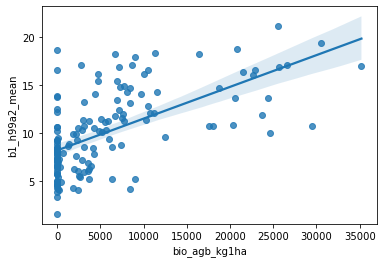

--------------------------------------------------


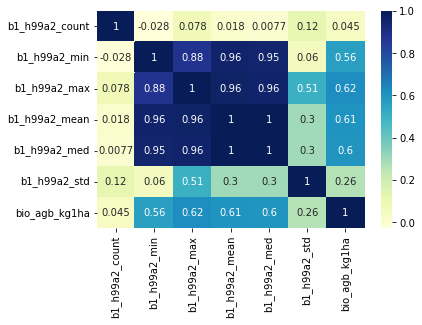

--------------------------------------------------


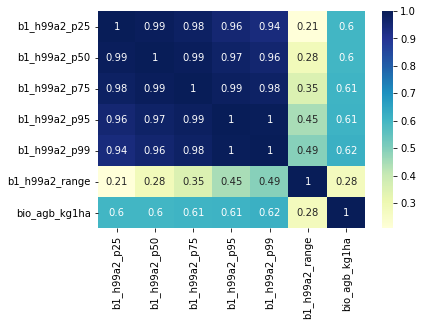

--------------------------------------------------


In [65]:

for df, title in zip([h99a_0112_basal_y],
             ["h99a_0112_basal_y"]):
    df.dropna(inplace=True)
    value_x = 'bio_agb_kg1ha'
    value_y = 'b1_h99a2_mean'
    sns.regplot(x= value_x, y=value_y, data=df)
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[value_x], df[value_y])
    
    print("Comparison relationship: ", title)
    print("*"*50)
    print("slope: ", slope)
    print("intersept: ", intercept)
    print("r2: ", r_value)
    print("P_value: ", p_value)
    print("std error: ", std_err)
    plt.show()
    print('-'*50)
    
    # correlation matrix
    band = 1
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res.append('bio_agb_kg1ha')
    # print(res)
    df1 = df[res]
    # print(df1)

    
    # correlation matrix
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res_ = res[:6]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()

    print('-'*50)
    res_ = res[6:]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()
    print('-'*50)

Comparison relationship:  fpca_0509_basal_y
**************************************************
slope:  0.0009291219821971808
intersept:  6.320421253403619
r2:  0.6753494027966207
P_value:  7.53556779925906e-22
std error:  8.229685175980619e-05


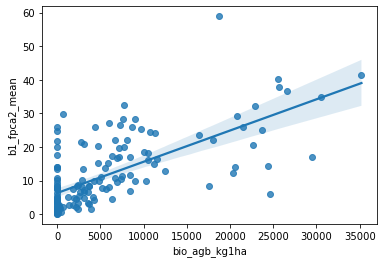

--------------------------------------------------


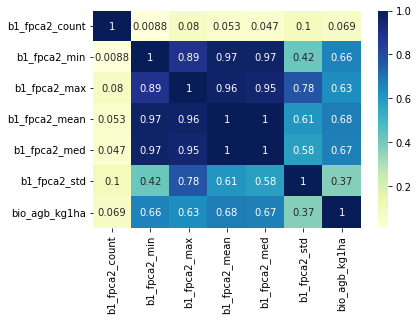

--------------------------------------------------


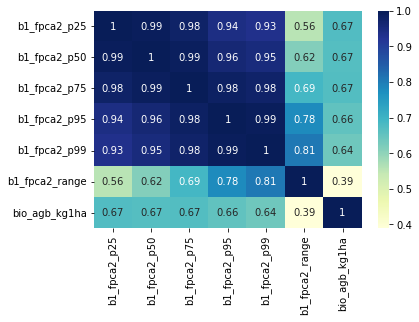

--------------------------------------------------


In [66]:

for df, title in zip([fpca_0509_basal_y],
             ["fpca_0509_basal_y"]):
    df.dropna(inplace=True)
    value_x = 'bio_agb_kg1ha'
    value_y = 'b1_fpca2_mean'
    sns.regplot(x= value_x, y=value_y, data=df)
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[value_x], df[value_y])
    
    print("Comparison relationship: ", title)
    print("*"*50)
    print("slope: ", slope)
    print("intersept: ", intercept)
    print("r2: ", r_value)
    print("P_value: ", p_value)
    print("std error: ", std_err)
    plt.show()
    print('-'*50)
    
    # correlation matrix
    band = 1
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res.append('bio_agb_kg1ha')
    # print(res)
    df1 = df[res]
    # print(df1)

    
    # correlation matrix
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res_ = res[:6]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()

    print('-'*50)
    res_ = res[6:]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()
    print('-'*50)
    

BAND: 1
Comparison relationship: dim_0305_basal_y title, band: 1
**************************************************
slope:  -0.000507429058446286
intersept:  15.100659980330109
r2:  -0.30526887158682314
P_value:  6.03358248706322e-05
std error:  0.00012322794617144559


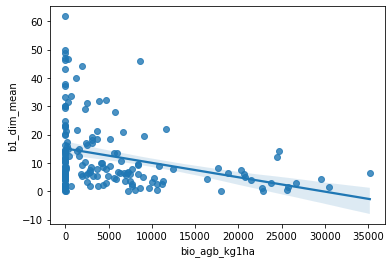

--------------------------------------------------


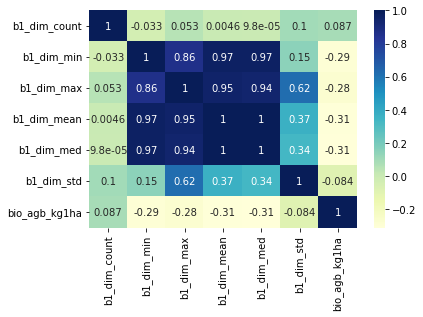

--------------------------------------------------


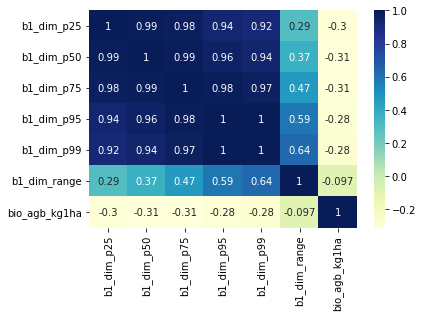

--------------------------------------------------
Comparison relationship: dim_0608_basal_y title, band: 1
**************************************************
slope:  -0.0006248232272690132
intersept:  19.476935479742192
r2:  -0.3402623154189724
P_value:  6.823616758883782e-06
std error:  0.00013442557098747838


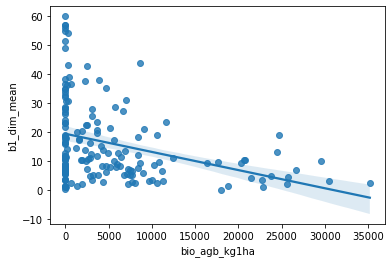

--------------------------------------------------


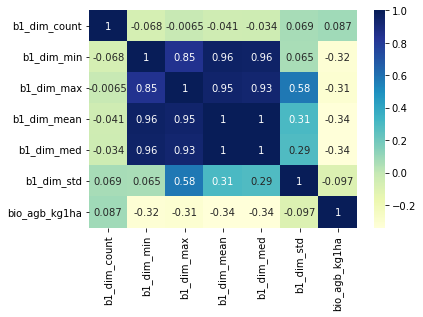

--------------------------------------------------


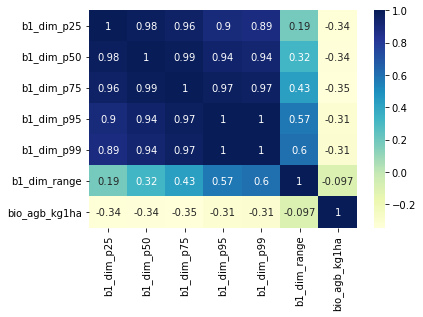

--------------------------------------------------
Comparison relationship: dim_0911_basal_y title, band: 1
**************************************************
slope:  -0.0008250813958474812
intersept:  23.062029741369383
r2:  -0.43955423539270044
P_value:  2.799641019645343e-09
std error:  0.00013125720887874223


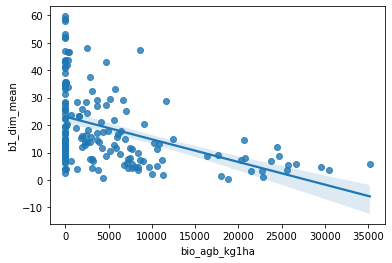

--------------------------------------------------


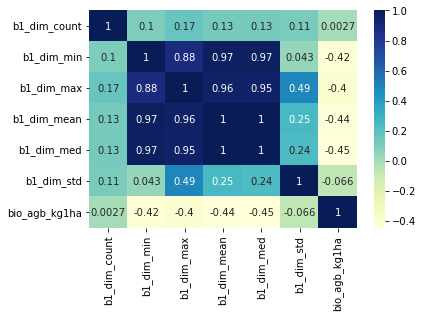

--------------------------------------------------


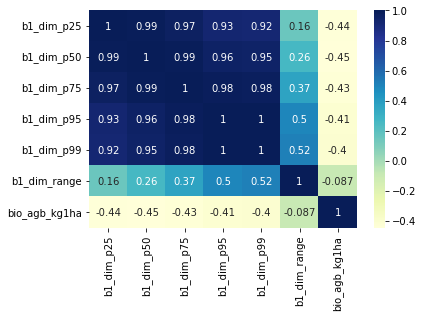

--------------------------------------------------
Comparison relationship: dim_1202_basal_y title, band: 1
**************************************************
slope:  -0.0006624179226571469
intersept:  18.86686927893647
r2:  -0.3610782045494249
P_value:  1.6361752074709798e-06
std error:  0.00013318466402192398


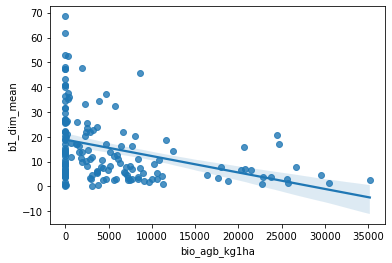

--------------------------------------------------


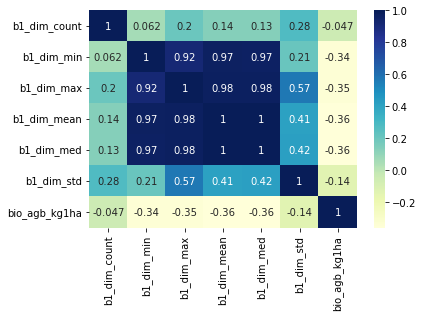

--------------------------------------------------


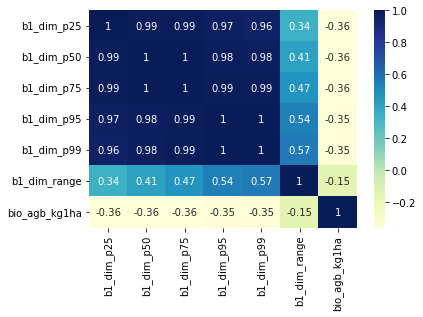

--------------------------------------------------
BAND: 2
Comparison relationship: dim_0305_basal_y title, band: 2
**************************************************
slope:  0.0008094940987881878
intersept:  38.09840383721775
r2:  0.3818168779408386
P_value:  3.5556090391982657e-07
std error:  0.00015254585488985874


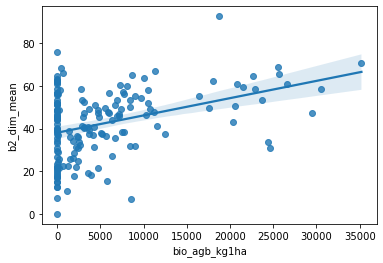

--------------------------------------------------


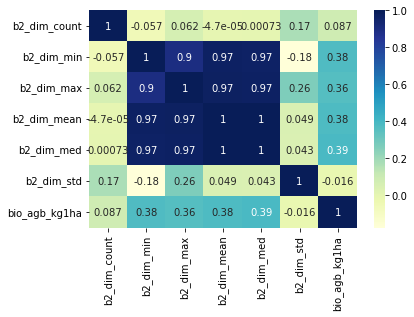

--------------------------------------------------


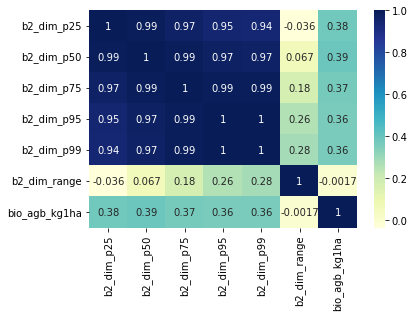

--------------------------------------------------
Comparison relationship: dim_0608_basal_y title, band: 2
**************************************************
slope:  0.0011712515456899827
intersept:  19.53997242937418
r2:  0.6362815757439
P_value:  2.4636164942285727e-20
std error:  0.0001105529988284383


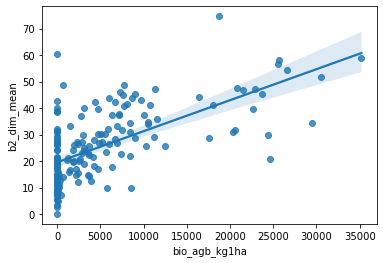

--------------------------------------------------


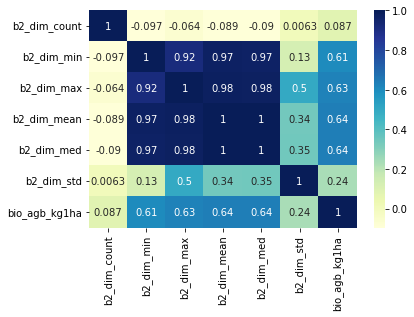

--------------------------------------------------


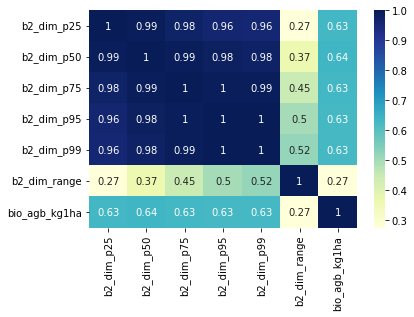

--------------------------------------------------
Comparison relationship: dim_0911_basal_y title, band: 2
**************************************************
slope:  0.001197415333768453
intersept:  16.44642540676253
r2:  0.6855643594554022
P_value:  1.6086731541638592e-24
std error:  9.899041945405489e-05


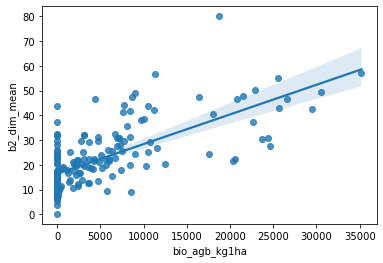

--------------------------------------------------


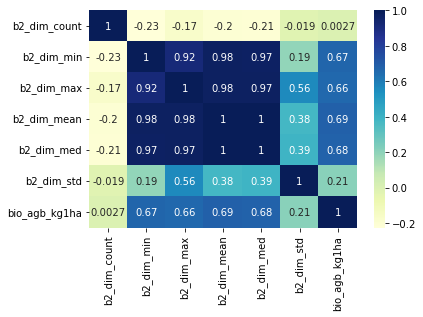

--------------------------------------------------


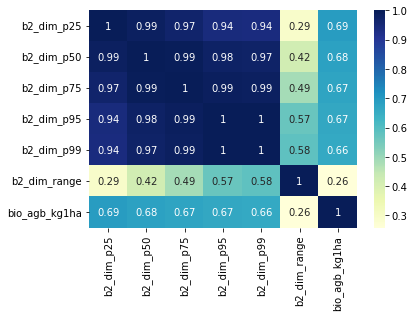

--------------------------------------------------
Comparison relationship: dim_1202_basal_y title, band: 2
**************************************************
slope:  0.0011107008710485463
intersept:  33.01072497761244
r2:  0.4400697389899588
P_value:  2.6697977731706927e-09
std error:  0.0001764380976023817


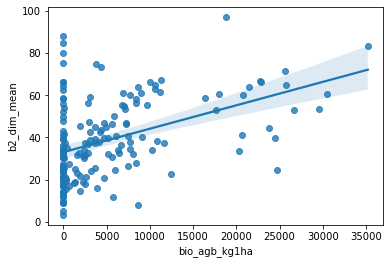

--------------------------------------------------


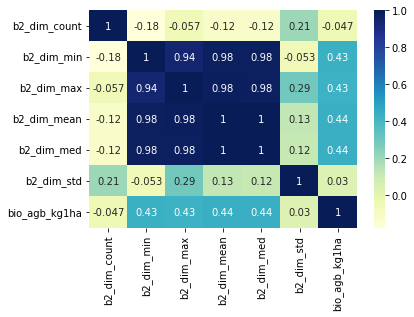

--------------------------------------------------


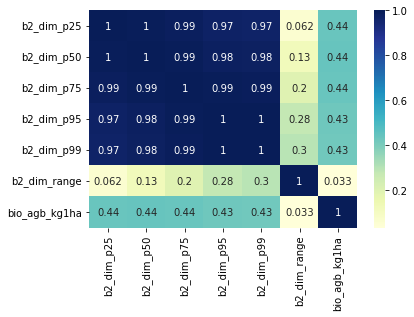

--------------------------------------------------
BAND: 3
Comparison relationship: dim_0305_basal_y title, band: 3
**************************************************
slope:  -0.0003043185761083102
intersept:  45.515986812597006
r2:  -0.22031627457741443
P_value:  0.004223483445587896
std error:  0.00010489030493734757


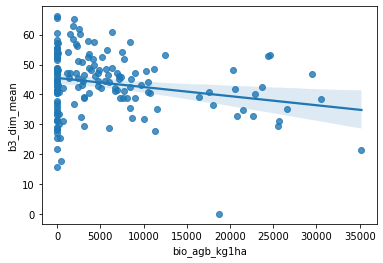

--------------------------------------------------


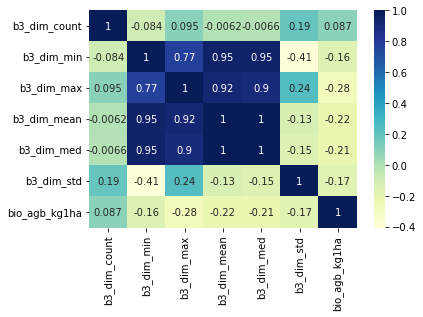

--------------------------------------------------


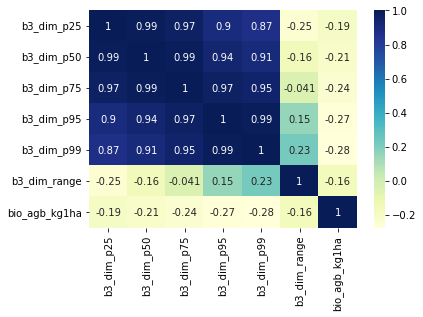

--------------------------------------------------
Comparison relationship: dim_0608_basal_y title, band: 3
**************************************************
slope:  -0.0005467475288265423
intersept:  59.73345653292253
r2:  -0.3235721347215
P_value:  1.9955794614950856e-05
std error:  0.00012446816738138786


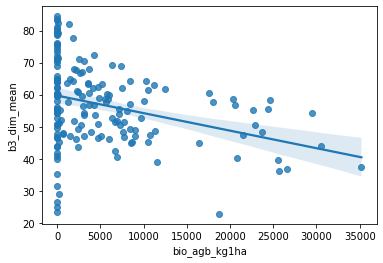

--------------------------------------------------


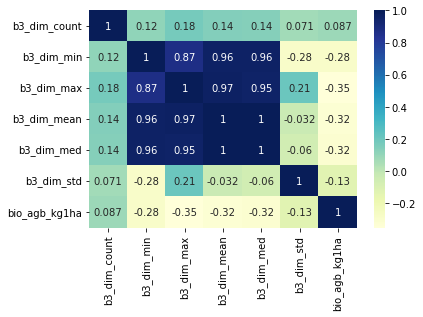

--------------------------------------------------


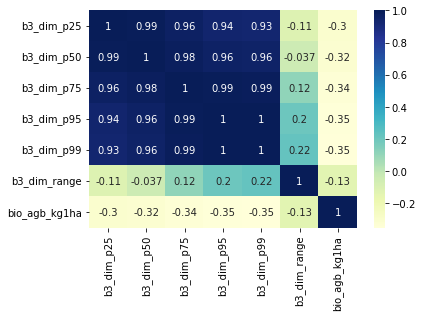

--------------------------------------------------
Comparison relationship: dim_0911_basal_y title, band: 3
**************************************************
slope:  -0.0003648832910138457
intersept:  59.1738729794789
r2:  -0.22410139454820766
P_value:  0.0035981416377299856
std error:  0.0001235317594602946


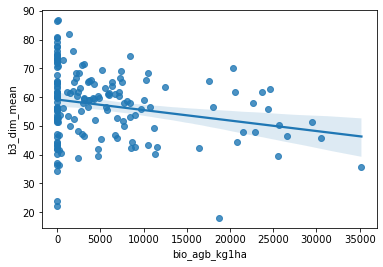

--------------------------------------------------


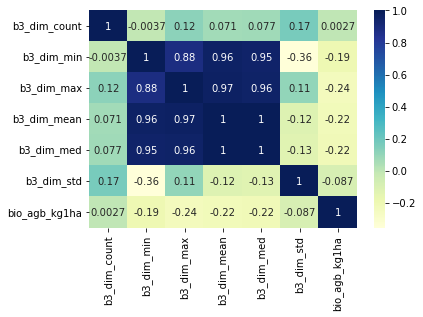

--------------------------------------------------


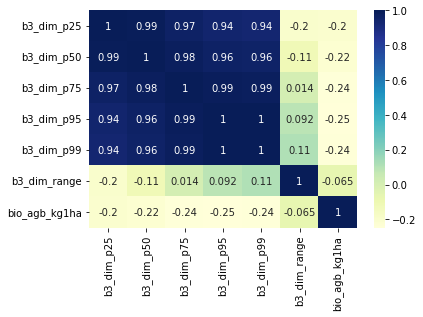

--------------------------------------------------
Comparison relationship: dim_1202_basal_y title, band: 3
**************************************************
slope:  -0.00044967197086475855
intersept:  46.817598530314164
r2:  -0.25662996459329784
P_value:  0.0008147740763840416
std error:  0.00013184167528082347


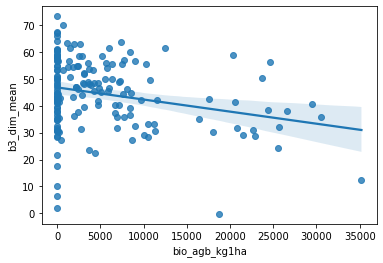

--------------------------------------------------


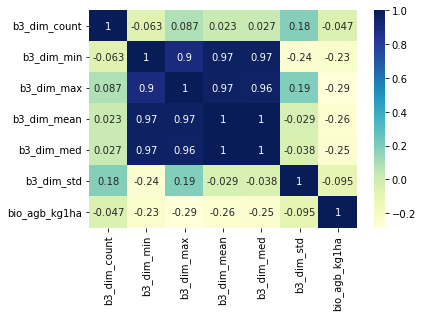

--------------------------------------------------


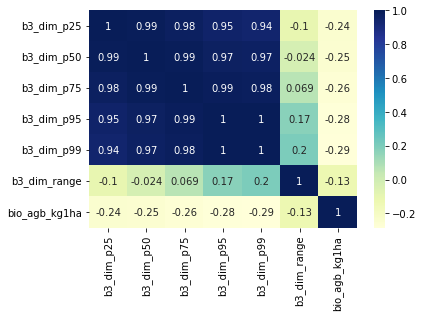

--------------------------------------------------


In [67]:
for band_ in range(0,3):
    print("="*100)
    band = band_+1
    print(f"BAND: {band}")

    for df, title in zip([dim_0305_basal_y, dim_0608_basal_y, dim_0911_basal_y, dim_1202_basal_y],
                 ["dim_0305_basal_y", "dim_0608_basal_y", "dim_0911_basal_y", "dim_1202_basal_y"]):

        value_x = 'bio_agb_kg1ha'
        value_y = f'b{band}_dim_mean'
        sns.regplot(x= value_x, y=value_y, data=df)
        slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[value_x], df[value_y])

        print(f"Comparison relationship: {title} title, band: {band}")
        print("*"*50)
        print("slope: ", slope)
        print("intersept: ", intercept)
        print("r2: ", r_value)
        print("P_value: ", p_value)
        print("std error: ", std_err)
        plt.show()
        print('-'*50)

        # correlation matrix
        col_names = df.columns.tolist()
        res = [i for i in col_names if f"b{band}" in i]
        res_ = res[:6]
        res_.append('bio_agb_kg1ha')
        df1 = df[res_]
        # plotting correlation heatmap
        dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
        plt.show()
        
        print('-'*50)
        res_ = res[6:]
        res_.append('bio_agb_kg1ha')
        df1 = df[res_]
        # plotting correlation heatmap
        dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
        plt.show()
        print('-'*50)

dim_0911 highest r2 value

Comparison relationship:  dja_0305_basal_y
**************************************************
slope:  0.0010715565702903833
intersept:  11.464546055986885
r2:  0.689006634648911
P_value:  7.639050148714844e-25
std error:  8.774875581029399e-05


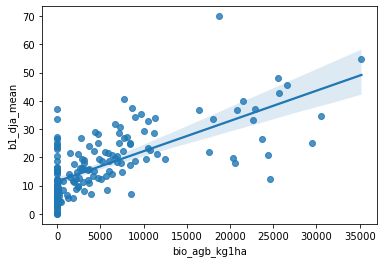

--------------------------------------------------


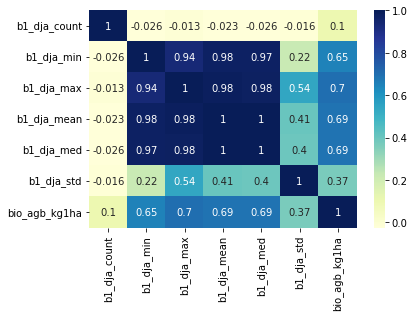

--------------------------------------------------


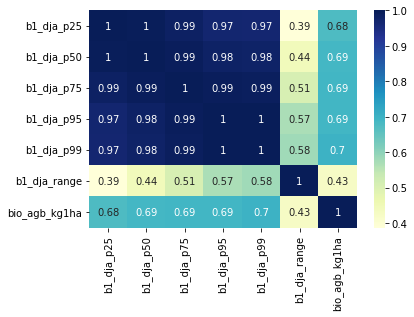

--------------------------------------------------
Comparison relationship:  dja_0608_basal_y
**************************************************
slope:  0.0010696441603508413
intersept:  11.562823513891454
r2:  0.6896320384232031
P_value:  6.6649136847628945e-25
std error:  8.744086252519226e-05


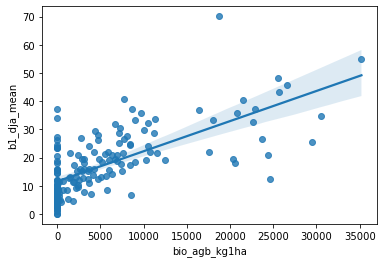

--------------------------------------------------


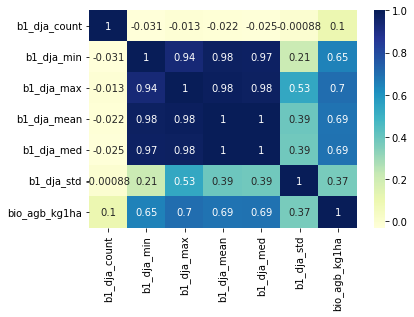

--------------------------------------------------


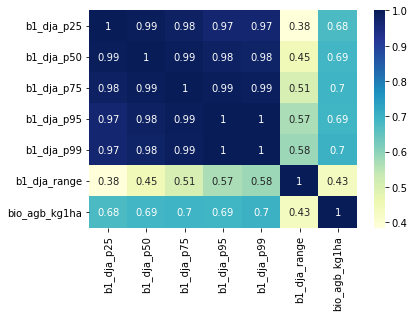

--------------------------------------------------
Comparison relationship:  dja_0911_basal_y
**************************************************
slope:  0.0010767930638308834
intersept:  11.61058953627883
r2:  0.6955161425525092
P_value:  1.8153550448016352e-25
std error:  8.659965543527631e-05


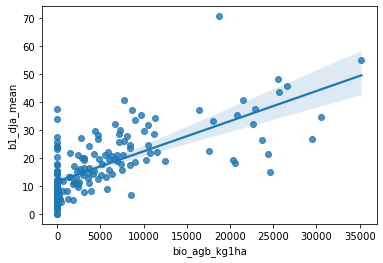

--------------------------------------------------


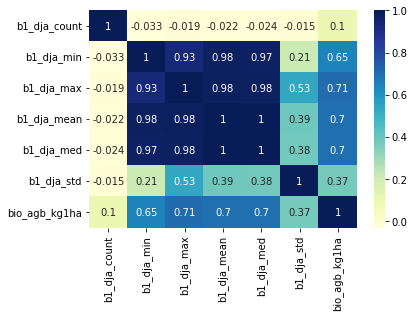

--------------------------------------------------


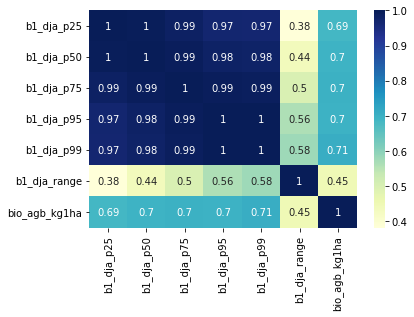

--------------------------------------------------
Comparison relationship:  dja_1202_basal_y
**************************************************
slope:  0.0010814001018213878
intersept:  11.742473390982784
r2:  0.6941995003571387
P_value:  2.435168914453923e-25
std error:  8.728939979179004e-05


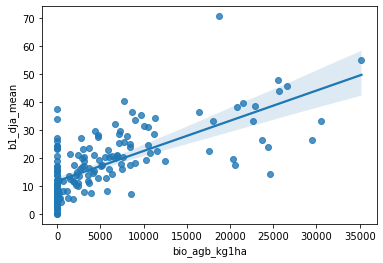

--------------------------------------------------


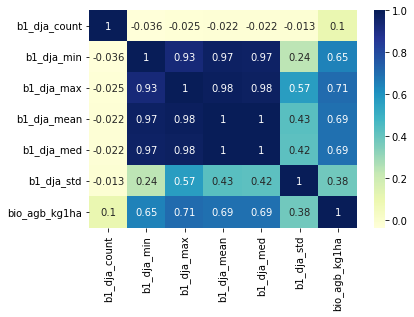

--------------------------------------------------


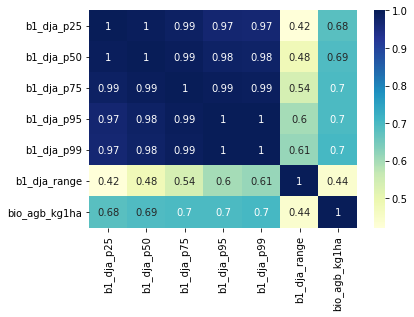

--------------------------------------------------


In [68]:
for df, title in zip([dja_0305_basal_y, dja_0608_basal_y, dja_0911_basal_y, dja_1202_basal_y],
             ["dja_0305_basal_y", "dja_0608_basal_y", "dja_0911_basal_y", "dja_1202_basal_y"]):
    value_x = 'bio_agb_kg1ha'
    value_y = 'b1_dja_mean'
    sns.regplot(x= value_x, y=value_y, data=df)
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[value_x], df[value_y])
    
    print("Comparison relationship: ", title)
    print("*"*50)
    print("slope: ", slope)
    print("intersept: ", intercept)
    print("r2: ", r_value)
    print("P_value: ", p_value)
    print("std error: ", std_err)
    plt.show()
    print('-'*50)
    
    # correlation matrix
    band = 1
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res.append('bio_agb_kg1ha')
    # print(res)
    df1 = df[res]
    # print(df1)

    
    # correlation matrix
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res_ = res[:6]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()

    print('-'*50)
    res_ = res[6:]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()
    print('-'*50)

BAND: 1
Comparison relationship: dp1_0112_basal_y title, band: 1
**************************************************
slope:  -0.0007129972361411722
intersept:  18.902967204329357
r2:  -0.3858195689977264
P_value:  9.960851041624184e-07
std error:  0.00013967278501207797


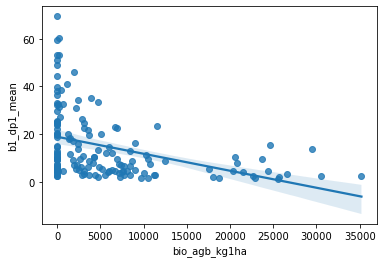

--------------------------------------------------


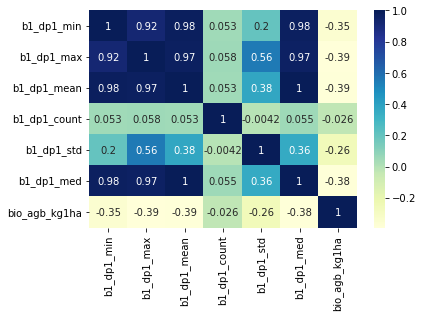

--------------------------------------------------


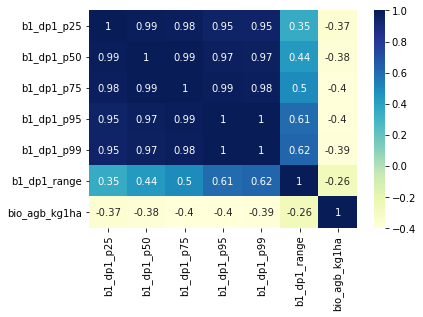

--------------------------------------------------
Comparison relationship: dp1_0509_basal_y title, band: 1
**************************************************
slope:  -0.00048002474542309625
intersept:  14.819426934003246
r2:  -0.30452295427289766
P_value:  0.0006158202353188429
std error:  0.00013649544835420485


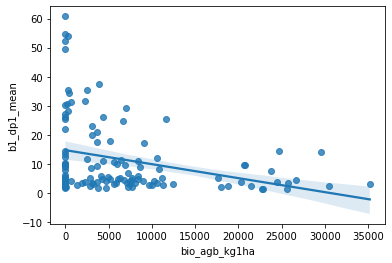

--------------------------------------------------


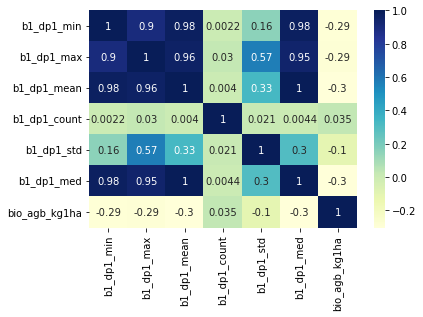

--------------------------------------------------


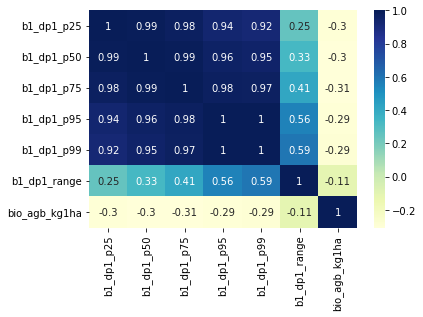

--------------------------------------------------
BAND: 2
Comparison relationship: dp1_0112_basal_y title, band: 2
**************************************************
slope:  0.0014098149271694817
intersept:  19.513447305764444
r2:  0.6071204688460029
P_value:  1.4108501535941408e-16
std error:  0.00015116387379886684


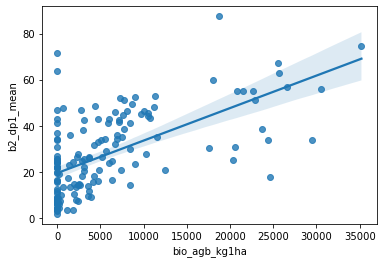

--------------------------------------------------


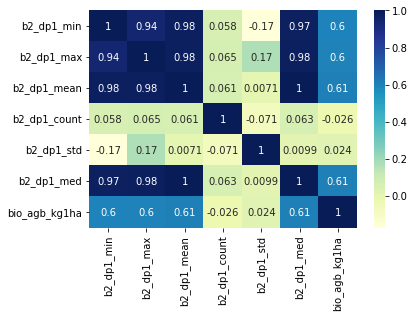

--------------------------------------------------


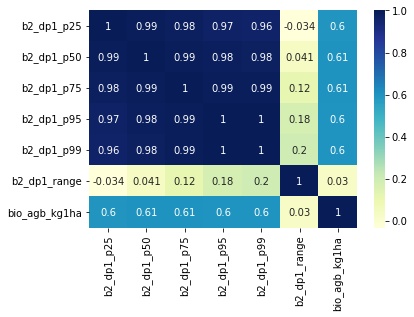

--------------------------------------------------
Comparison relationship: dp1_0509_basal_y title, band: 2
**************************************************
slope:  0.0011915322874649279
intersept:  19.64102373143868
r2:  0.5727499085661678
P_value:  4.45561490987669e-12
std error:  0.00015503116760122505


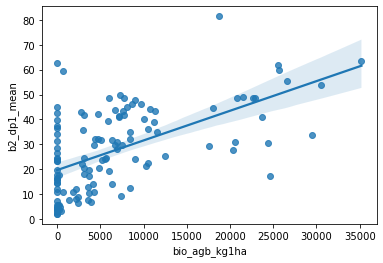

--------------------------------------------------


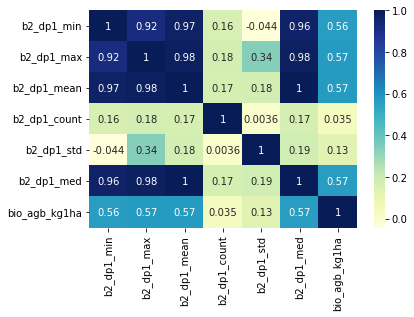

--------------------------------------------------


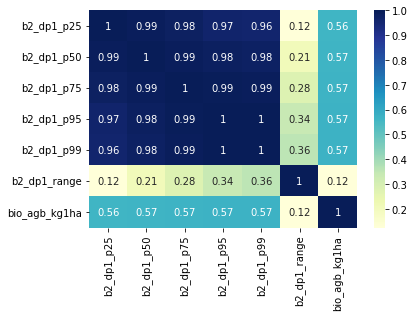

--------------------------------------------------
BAND: 3
Comparison relationship: dp1_0112_basal_y title, band: 3
**************************************************
slope:  -0.0006968403421252062
intersept:  60.09456735421844
r2:  -0.3344608794795083
P_value:  2.701180355706295e-05
std error:  0.00016085499120433358


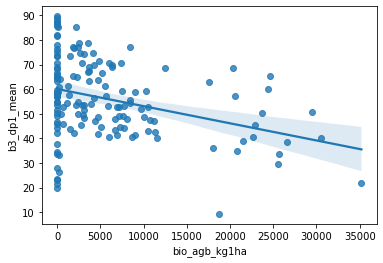

--------------------------------------------------


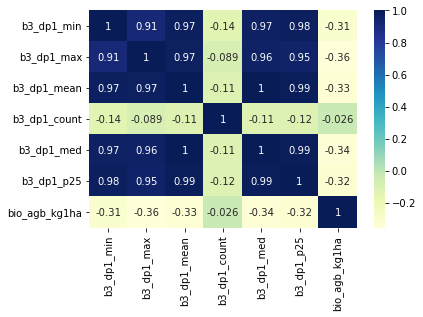

--------------------------------------------------


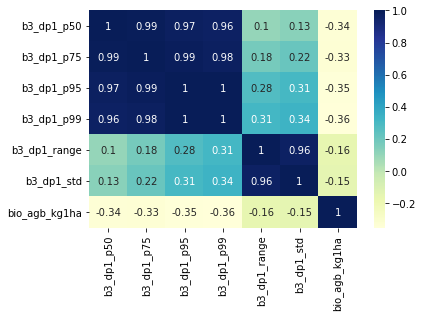

--------------------------------------------------
Comparison relationship: dp1_0509_basal_y title, band: 3
**************************************************
slope:  -0.0007064292444395015
intersept:  64.0109939706048
r2:  -0.3309970188980933
P_value:  0.00018444002088769713
std error:  0.0001830857190575314


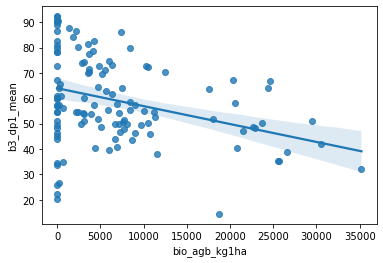

--------------------------------------------------


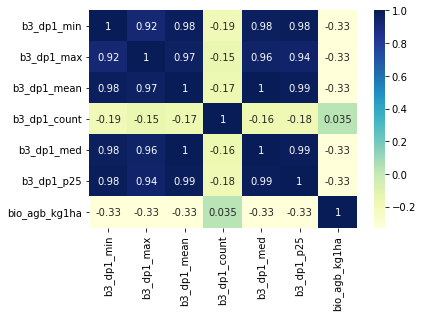

--------------------------------------------------


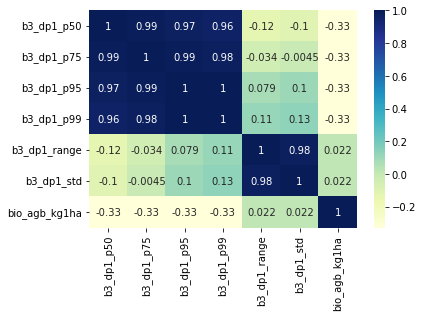

--------------------------------------------------


In [69]:
for band_ in range(0,3):
    print("="*100)
    band = band_+1
    print(f"BAND: {band}")

    for df, title in zip([dp1_0112_basal_y, dp1_0509_basal_y],
                 ["dp1_0112_basal_y", "dp1_0509_basal_y"]):
        
        df.dropna(inplace=True)

        value_x = 'bio_agb_kg1ha'
        value_y = f'b{band}_dp1_mean'
        sns.regplot(x= value_x, y=value_y, data=df)
        slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[value_x], df[value_y])

        print(f"Comparison relationship: {title} title, band: {band}")
        print("*"*50)
        print("slope: ", slope)
        print("intersept: ", intercept)
        print("r2: ", r_value)
        print("P_value: ", p_value)
        print("std error: ", std_err)
        plt.show()
        print('-'*50)
        
        # correlation matrix
        col_names = df.columns.tolist()
        res = [i for i in col_names if f"b{band}" in i]
        res_ = res[:6]
        res_.append('bio_agb_kg1ha')
        df1 = df[res_]
        # plotting correlation heatmap
        dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
        plt.show()
        
        print('-'*50)
        res_ = res[6:]
        res_.append('bio_agb_kg1ha')
        df1 = df[res_]
        # plotting correlation heatmap
        dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
        plt.show()
        print('-'*50)

dp1_0112 highest R2 value

# Fire scars not considered

Comparison relationship:  h99a_0112_basal_nfs
**************************************************
slope:  0.0003584022743731523
intersept:  7.667428587468409
r2:  0.6386477617262482
P_value:  3.245206870936442e-18
std error:  3.5861920259464384e-05


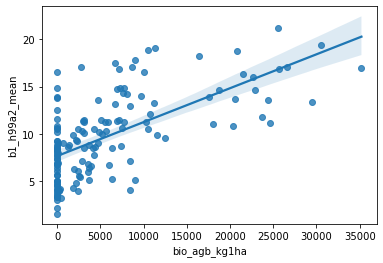

--------------------------------------------------


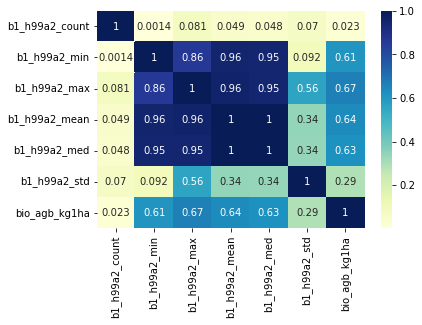

--------------------------------------------------


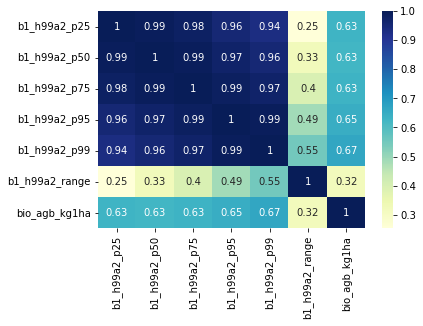

--------------------------------------------------


In [70]:

for df, title in zip([h99a_0112_basal_nfs],
             ["h99a_0112_basal_nfs"]):
    df.dropna(inplace=True)
    value_x = 'bio_agb_kg1ha'
    value_y = 'b1_h99a2_mean'
    sns.regplot(x= value_x, y=value_y, data=df)
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[value_x], df[value_y])
    
    print("Comparison relationship: ", title)
    print("*"*50)
    print("slope: ", slope)
    print("intersept: ", intercept)
    print("r2: ", r_value)
    print("P_value: ", p_value)
    print("std error: ", std_err)
    plt.show()
    print('-'*50)
    
    # correlation matrix
    band = 1
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res.append('bio_agb_kg1ha')
    # print(res)
    df1 = df[res]
    # print(df1)

    
    # correlation matrix
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res_ = res[:6]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()

    print('-'*50)
    res_ = res[6:]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()
    print('-'*50)

Comparison relationship:  fpca_0509_basal_nfs
**************************************************
slope:  0.0009470132649498341
intersept:  5.953867160704653
r2:  0.6994413343706549
P_value:  6.145378707624462e-24
std error:  7.848753503211821e-05


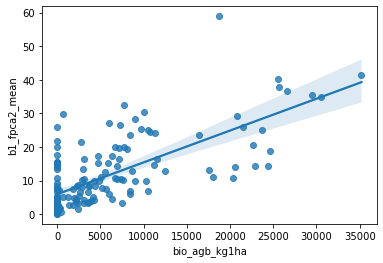

--------------------------------------------------


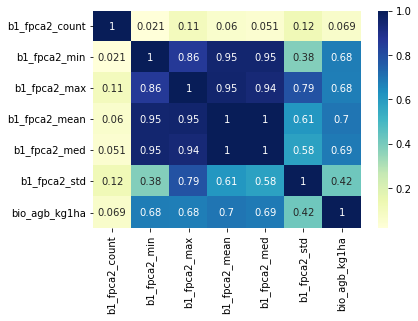

--------------------------------------------------


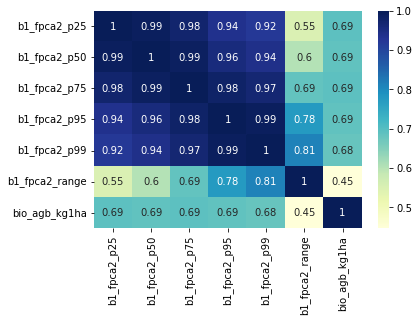

--------------------------------------------------


In [71]:

for df, title in zip([fpca_0509_basal_nfs],
             ["fpca_0509_basal_nfs"]):
    df.dropna(inplace=True)
    value_x = 'bio_agb_kg1ha'
    value_y = 'b1_fpca2_mean'
    sns.regplot(x= value_x, y=value_y, data=df)
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[value_x], df[value_y])
    
    print("Comparison relationship: ", title)
    print("*"*50)
    print("slope: ", slope)
    print("intersept: ", intercept)
    print("r2: ", r_value)
    print("P_value: ", p_value)
    print("std error: ", std_err)
    plt.show()
    print('-'*50)
    
    # correlation matrix
    band = 1
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res.append('bio_agb_kg1ha')
    # print(res)
    df1 = df[res]
    # print(df1)

    
    # correlation matrix
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res_ = res[:6]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()

    print('-'*50)
    res_ = res[6:]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()
    print('-'*50)
    

BAND: 1
Comparison relationship: dim_0305_basal_nfs title, band: 1
**************************************************
slope:  -0.0007522730366449666
intersept:  19.385762877890514
r2:  -0.4121954319181744
P_value:  3.429765691225616e-08
std error:  0.00012984172510182966


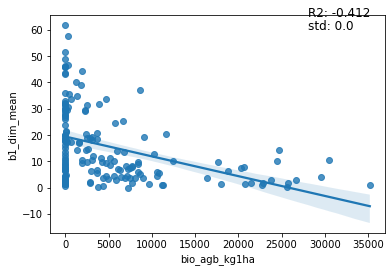

--------------------------------------------------


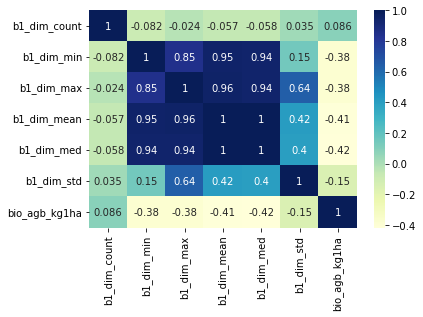

--------------------------------------------------


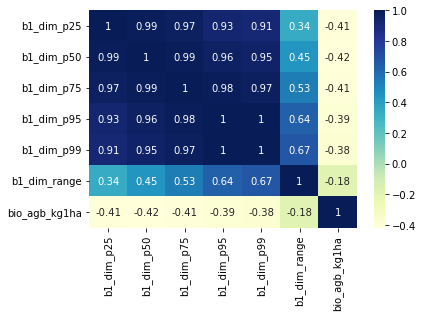

--------------------------------------------------
Comparison relationship: dim_0608_basal_nfs title, band: 1
**************************************************
slope:  -0.0007106325372432784
intersept:  24.321375849134874
r2:  -0.38255044455293374
P_value:  3.649294821552542e-07
std error:  0.00013402187439707144


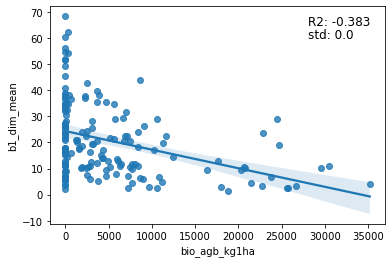

--------------------------------------------------


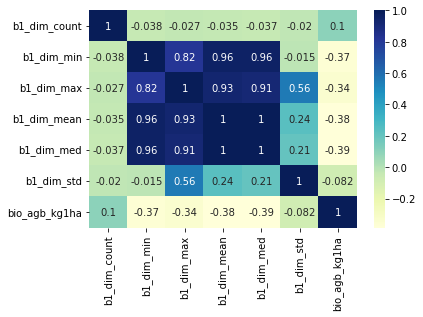

--------------------------------------------------


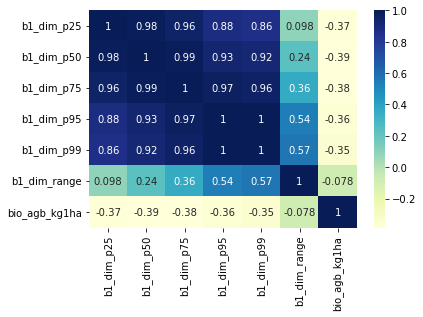

--------------------------------------------------
Comparison relationship: dim_0911_basal_nfs title, band: 1
**************************************************
slope:  -0.0009000632906376992
intersept:  27.92166940549112
r2:  -0.45257044698274856
P_value:  8.235294593818787e-10
std error:  0.00013806309591752298


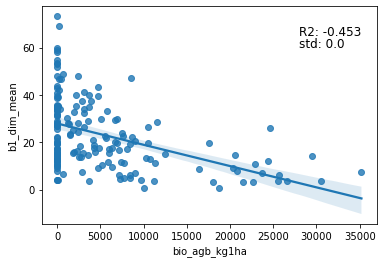

--------------------------------------------------


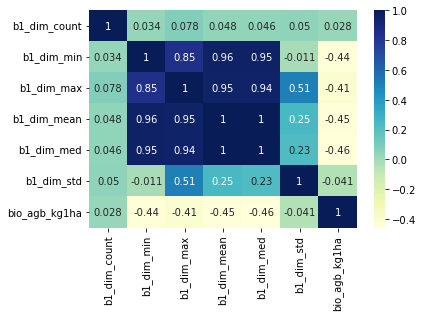

--------------------------------------------------


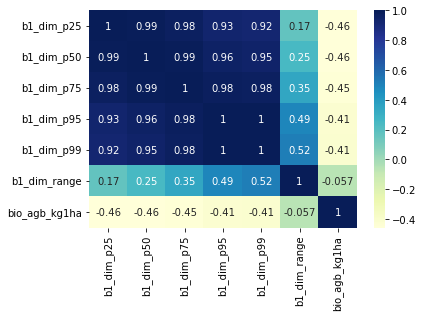

--------------------------------------------------
Comparison relationship: dim_1202_basal_nfs title, band: 1
**************************************************
slope:  -0.0006979722732550588
intersept:  20.85820194884837
r2:  -0.3839172765574169
P_value:  3.571976802844802e-07
std error:  0.00013148653871085096


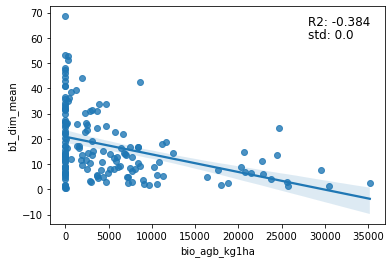

--------------------------------------------------


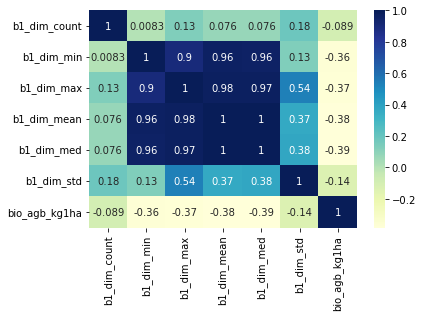

--------------------------------------------------


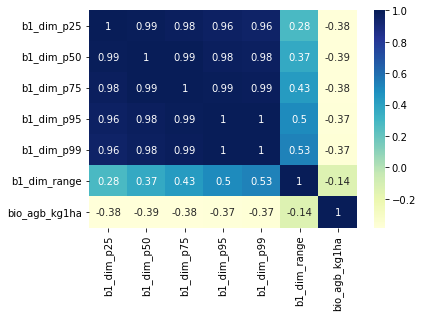

--------------------------------------------------
BAND: 2
Comparison relationship: dim_0305_basal_nfs title, band: 2
**************************************************
slope:  0.0012637068236292885
intersept:  29.66145649003074
r2:  0.5312666585838313
P_value:  1.7873596881519737e-13
std error:  0.00015736211418094714


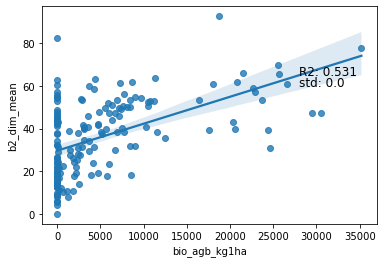

--------------------------------------------------


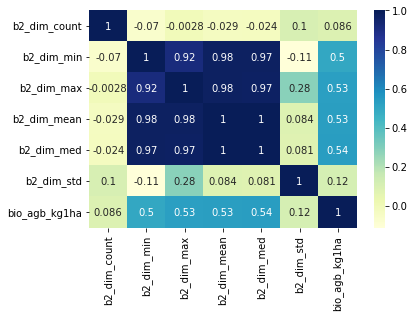

--------------------------------------------------


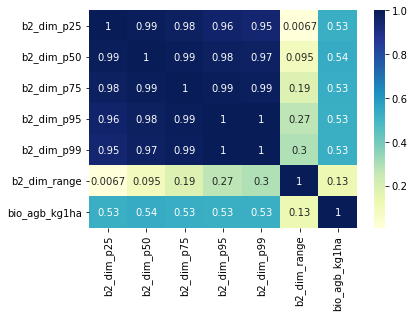

--------------------------------------------------
Comparison relationship: dim_0608_basal_nfs title, band: 2
**************************************************
slope:  0.0012442638504058128
intersept:  16.274761043887263
r2:  0.6545965312064188
P_value:  1.1220224363377186e-21
std error:  0.00011220863060476026


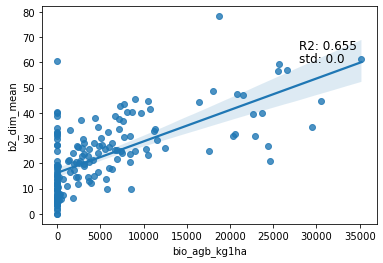

--------------------------------------------------


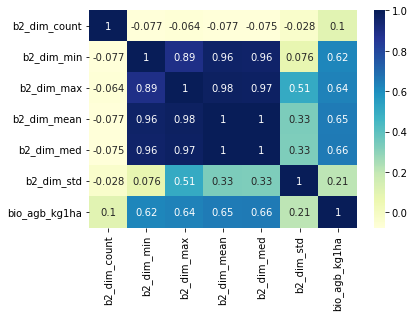

--------------------------------------------------


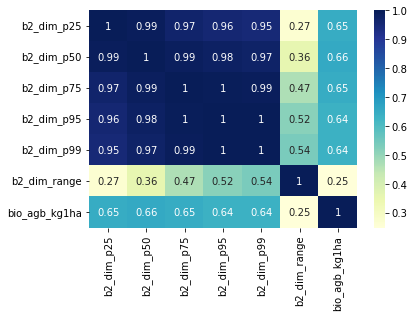

--------------------------------------------------
Comparison relationship: dim_0911_basal_nfs title, band: 2
**************************************************
slope:  0.0012136821566943452
intersept:  14.541272092961647
r2:  0.6923439405376658
P_value:  3.674099695318789e-25
std error:  9.847322274748947e-05


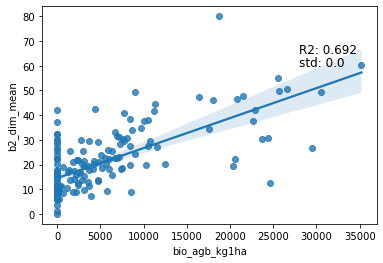

--------------------------------------------------


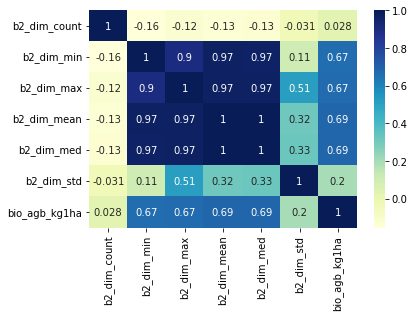

--------------------------------------------------


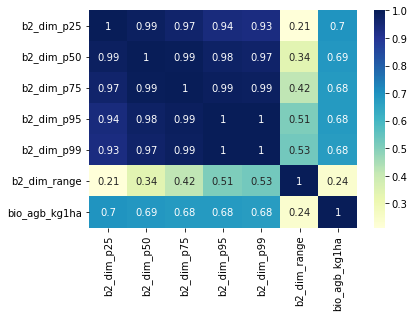

--------------------------------------------------
Comparison relationship: dim_1202_basal_nfs title, band: 2
**************************************************
slope:  0.0010937675858989384
intersept:  31.63973123918909
r2:  0.43775063575007106
P_value:  4.110531960407432e-09
std error:  0.0001759586947621797


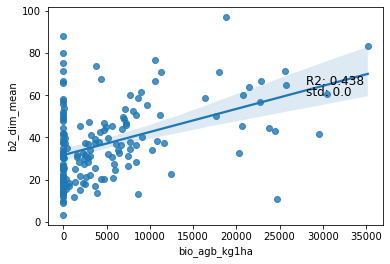

--------------------------------------------------


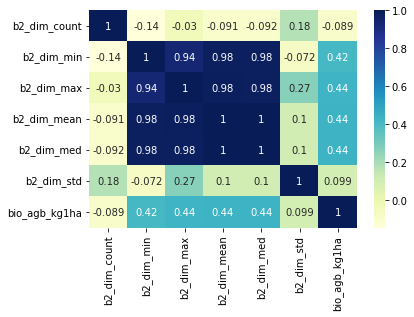

--------------------------------------------------


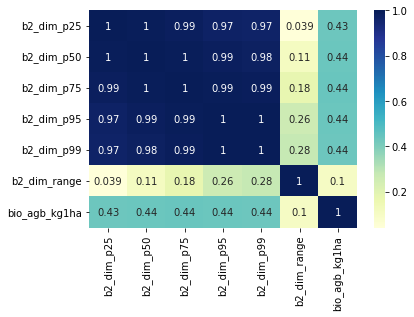

--------------------------------------------------
BAND: 3
Comparison relationship: dim_0305_basal_nfs title, band: 3
**************************************************
slope:  -0.0005129825393730768
intersept:  49.6502213248895
r2:  -0.3689761671653604
P_value:  9.99554175751047e-07
std error:  0.00010090278857844667


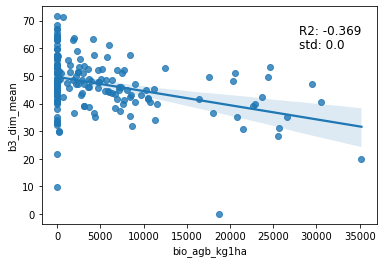

--------------------------------------------------


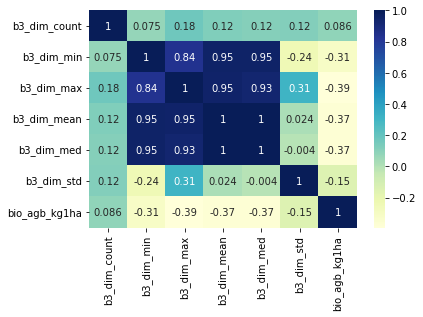

--------------------------------------------------


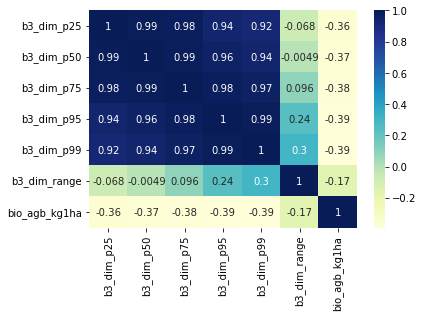

--------------------------------------------------
Comparison relationship: dim_0608_basal_nfs title, band: 3
**************************************************
slope:  -0.0005374428635263626
intersept:  58.10294330399596
r2:  -0.33272229795755565
P_value:  1.1874478986931908e-05
std error:  0.00011894648368694362


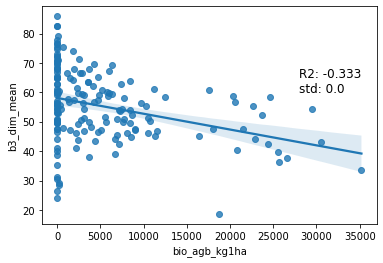

--------------------------------------------------


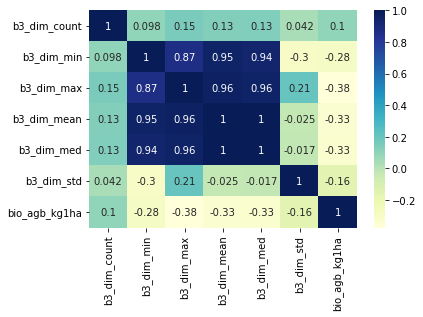

--------------------------------------------------


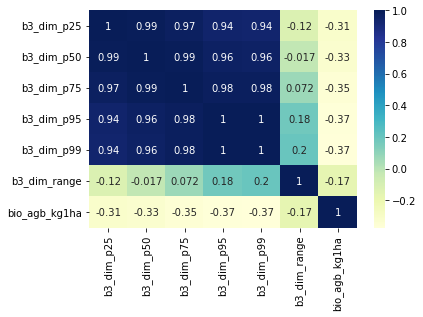

--------------------------------------------------
Comparison relationship: dim_0911_basal_nfs title, band: 3
**************************************************
slope:  -0.00030941886895796683
intersept:  56.18290833586581
r2:  -0.18821547380145018
P_value:  0.014858005117253855
std error:  0.00012569484974213598


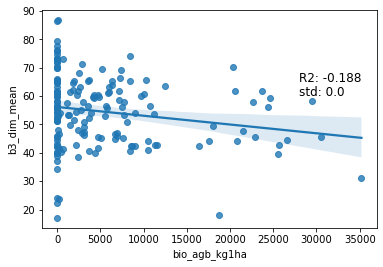

--------------------------------------------------


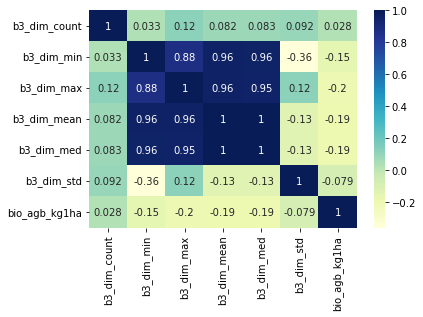

--------------------------------------------------


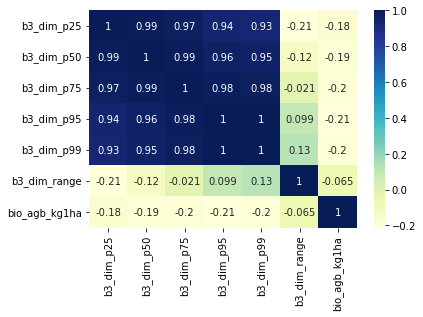

--------------------------------------------------
Comparison relationship: dim_1202_basal_nfs title, band: 3
**************************************************
slope:  -0.0003948701015094757
intersept:  46.148108278447864
r2:  -0.2185014597796486
P_value:  0.004809612861335449
std error:  0.00013812847558423508


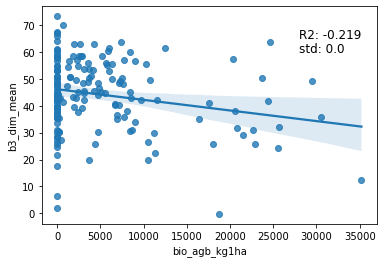

--------------------------------------------------


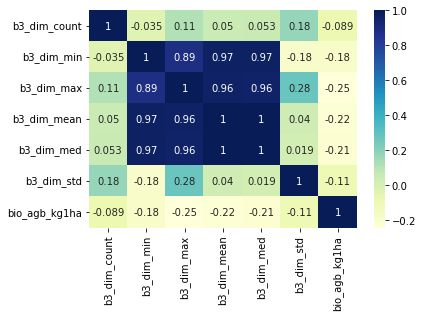

--------------------------------------------------


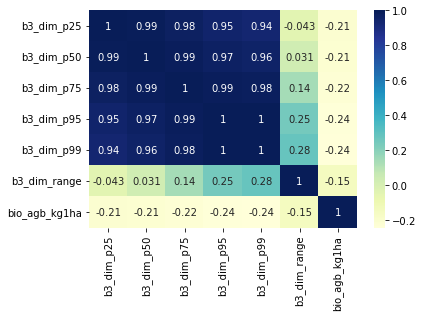

--------------------------------------------------


In [72]:
for band_ in range(0,3):
    print("="*100)
    band = band_+1
    print(f"BAND: {band}")

    for df, title in zip([dim_0305_basal_nfs, dim_0608_basal_nfs, dim_0911_basal_nfs, dim_1202_basal_nfs],
                 ["dim_0305_basal_nfs", "dim_0608_basal_nfs", "dim_0911_basal_nfs", "dim_1202_basal_nfs"]):

        df.dropna(inplace=True)
        value_x = 'bio_agb_kg1ha'
        value_y = f'b{band}_dim_mean'
        sns.regplot(x= value_x, y=value_y, data=df)
        slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[value_x], df[value_y])

        print(f"Comparison relationship: {title} title, band: {band}")
        print("*"*50)
        print("slope: ", slope)
        print("intersept: ", intercept)
        print("r2: ", r_value)
        print("P_value: ", p_value)
        print("std error: ", std_err)
        plt.text(28000, 65, f"R2: {r_value.round(3)}", {'color': 'black', 'fontsize': 12})
        plt.text(28000, 60, f"std: {std_err.round(3)}", {'color': 'black', 'fontsize': 12})
        plt.show()
        print('-'*50)

        # correlation matrix
        col_names = df.columns.tolist()
        res = [i for i in col_names if f"b{band}" in i]
        res_ = res[:6]
        res_.append('bio_agb_kg1ha')
        df1 = df[res_]
        # plotting correlation heatmap
        dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
        plt.show()
        
        print('-'*50)
        res_ = res[6:]
        res_.append('bio_agb_kg1ha')
        df1 = df[res_]
        # plotting correlation heatmap
        dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
        plt.show()
        print('-'*50)

dim_1911 highest R2

Comparison relationship:  dja_0305_basal_nfs
**************************************************
slope:  0.0010597320478884856
intersept:  11.495442787054325
r2:  0.6914955390495898
P_value:  6.150429434819919e-25
std error:  8.644719658372148e-05


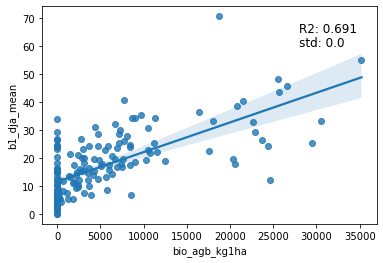

--------------------------------------------------


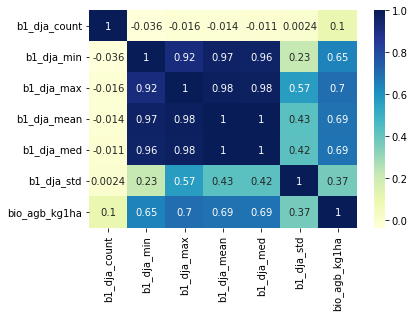

--------------------------------------------------


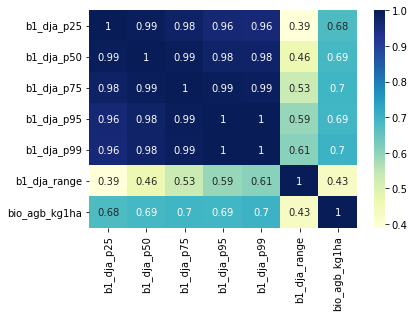

--------------------------------------------------
Comparison relationship:  dja_0608_basal_nfs
**************************************************
slope:  0.0010597320478884856
intersept:  11.495442787054325
r2:  0.6914955390495898
P_value:  6.150429434819919e-25
std error:  8.644719658372148e-05


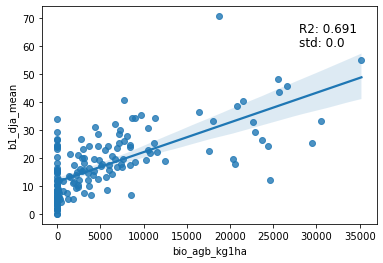

--------------------------------------------------


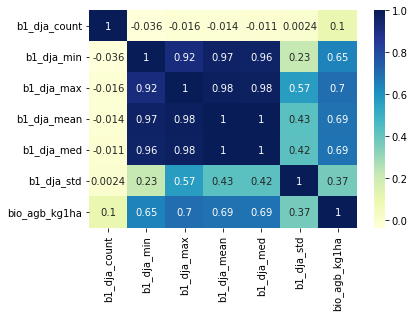

--------------------------------------------------


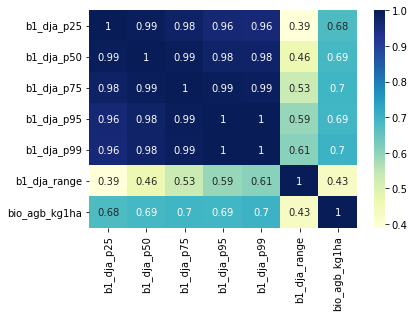

--------------------------------------------------
Comparison relationship:  dja_0911_basal_nfs
**************************************************
slope:  0.0010597320478884856
intersept:  11.495442787054325
r2:  0.6914955390495898
P_value:  6.150429434819919e-25
std error:  8.644719658372148e-05


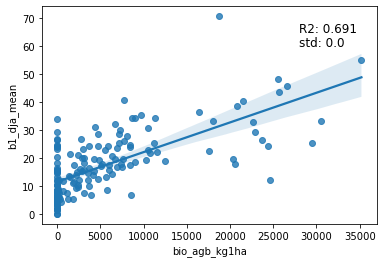

--------------------------------------------------


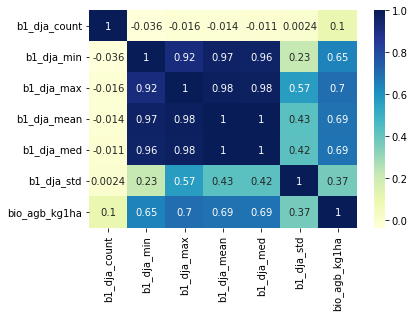

--------------------------------------------------


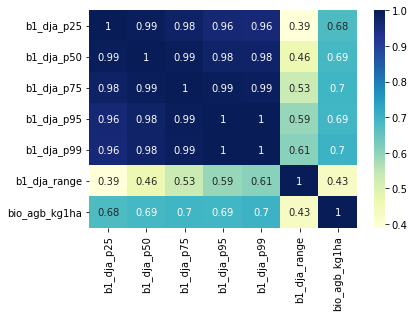

--------------------------------------------------
Comparison relationship:  dja_1202_basal_nfs
**************************************************
slope:  0.0010597320478884856
intersept:  11.495442787054325
r2:  0.6914955390495898
P_value:  6.150429434819919e-25
std error:  8.644719658372148e-05


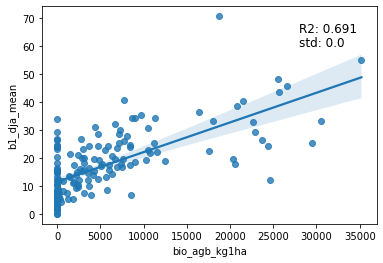

--------------------------------------------------


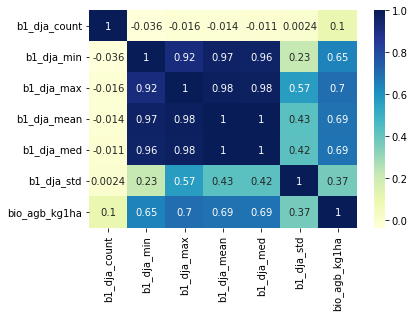

--------------------------------------------------


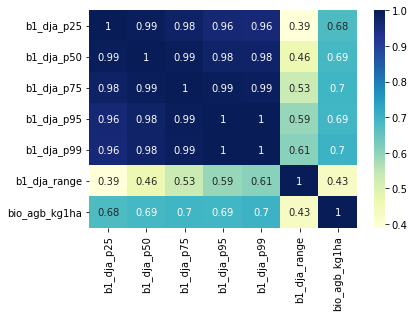

--------------------------------------------------


In [73]:
for df, title in zip([dja_0305_basal_nfs, dja_0608_basal_nfs, dja_0911_basal_nfs, dja_1202_basal_nfs],
             ["dja_0305_basal_nfs", "dja_0608_basal_nfs", "dja_0911_basal_nfs", "dja_1202_basal_nfs"]):
    df.dropna(inplace=True)
    
    value_x = 'bio_agb_kg1ha'
    value_y = 'b1_dja_mean'
    sns.regplot(x= value_x, y=value_y, data=df)
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[value_x], df[value_y])
    
    print("Comparison relationship: ", title)
    print("*"*50)
    print("slope: ", slope)
    print("intersept: ", intercept)
    print("r2: ", r_value)
    print("P_value: ", p_value)
    print("std error: ", std_err)
    plt.text(28000, 65, f"R2: {r_value.round(3)}", {'color': 'black', 'fontsize': 12})
    plt.text(28000, 60, f"std: {std_err.round(3)}", {'color': 'black', 'fontsize': 12})
    plt.show()
    print('-'*50)
    
    # correlation matrix
    band = 1
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res.append('bio_agb_kg1ha')
    # print(res)
    df1 = df[res]
    # print(df1)

    
    # correlation matrix
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res_ = res[:6]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()

    print('-'*50)
    res_ = res[6:]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()
    print('-'*50)

BAND: 1
Comparison relationship: dp1_0112_basal_nfs title, band: 1
**************************************************
slope:  -0.0006911527892717091
intersept:  20.974057746780034
r2:  -0.3610626585424551
P_value:  9.415834251953994e-06
std error:  0.00015033154741763376


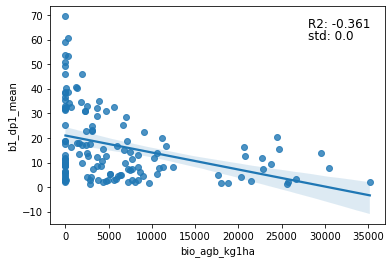

--------------------------------------------------


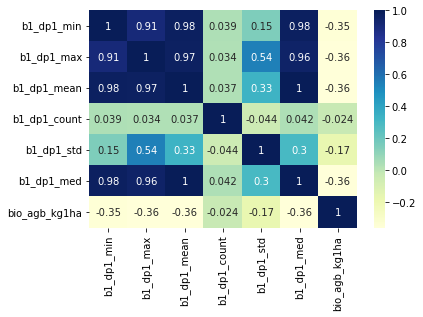

--------------------------------------------------


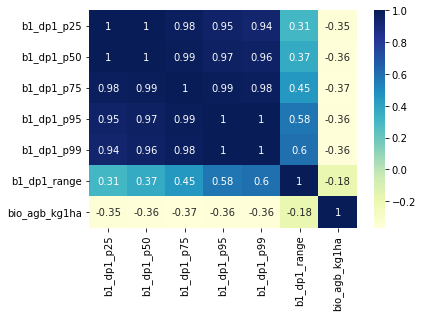

--------------------------------------------------
Comparison relationship: dp1_0509_basal_nfs title, band: 1
**************************************************
slope:  -0.000577812614925314
intersept:  19.734339484263955
r2:  -0.3324241670478321
P_value:  0.00025043122380109166
std error:  0.00015286816892156897


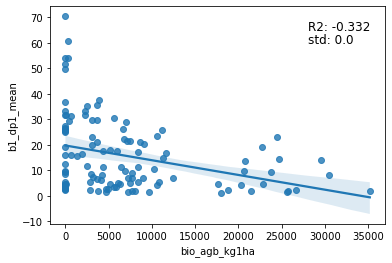

--------------------------------------------------


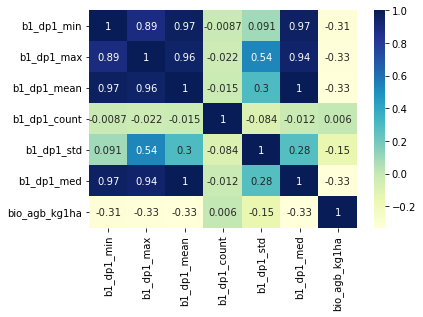

--------------------------------------------------


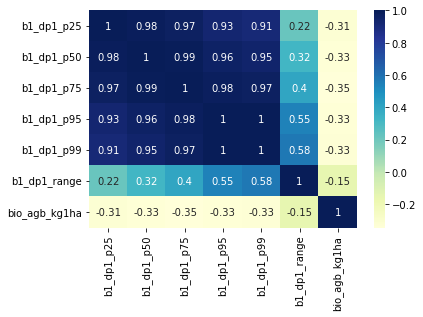

--------------------------------------------------


In [74]:
for band_ in range(0,1):
    print("="*100)
    band = band_+1
    print(f"BAND: {band}")

    for df, title in zip([dp1_0112_basal_nfs, dp1_0509_basal_nfs],
                 ["dp1_0112_basal_nfs", "dp1_0509_basal_nfs"]):

        df.dropna(inplace=True)
        value_x = 'bio_agb_kg1ha'
        value_y = f'b{band}_dp1_mean'
        sns.regplot(x= value_x, y=value_y, data=df)
        slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[value_x], df[value_y])

        print(f"Comparison relationship: {title} title, band: {band}")
        print("*"*50)
        print("slope: ", slope)
        print("intersept: ", intercept)
        print("r2: ", r_value)
        print("P_value: ", p_value)
        print("std error: ", std_err)
        plt.text(28000, 65, f"R2: {r_value.round(3)}", {'color': 'black', 'fontsize': 12})
        plt.text(28000, 60, f"std: {std_err.round(3)}", {'color': 'black', 'fontsize': 12})
        plt.show()
        print('-'*50)
        
        # correlation matrix
        col_names = df.columns.tolist()
        res = [i for i in col_names if f"b{band}" in i]
        res_ = res[:6]
        res_.append('bio_agb_kg1ha')
        df1 = df[res_]
        # plotting correlation heatmap
        dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
        plt.show()
        
        print('-'*50)
        res_ = res[6:]
        res_.append('bio_agb_kg1ha')
        df1 = df[res_]
        # plotting correlation heatmap
        dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
        plt.show()
        print('-'*50)

Comparison relationship:  dja_0305_basal_y
**************************************************
slope:  0.0010715565702903833
intersept:  11.464546055986885
r2:  0.689006634648911
P_value:  7.639050148714844e-25
std error:  8.774875581029399e-05


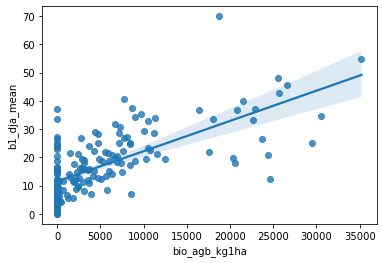

--------------------------------------------------


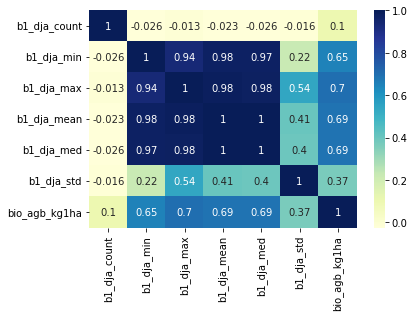

--------------------------------------------------


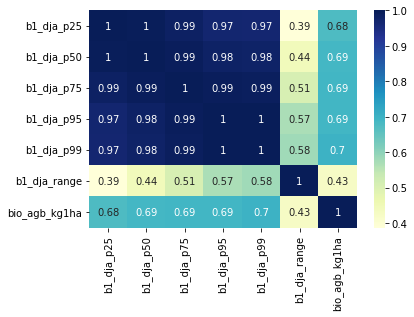

--------------------------------------------------
Comparison relationship:  dja_0608_basal_y
**************************************************
slope:  0.0010696441603508413
intersept:  11.562823513891454
r2:  0.6896320384232031
P_value:  6.6649136847628945e-25
std error:  8.744086252519226e-05


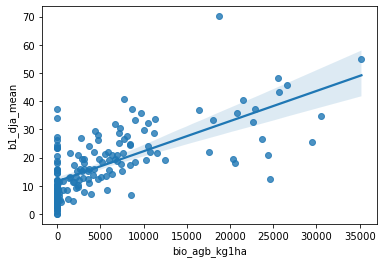

--------------------------------------------------


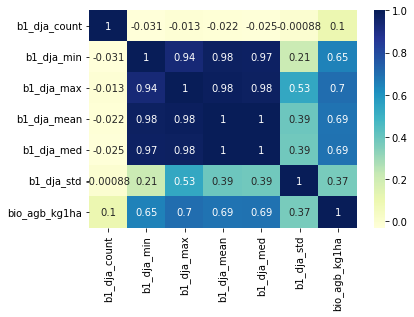

--------------------------------------------------


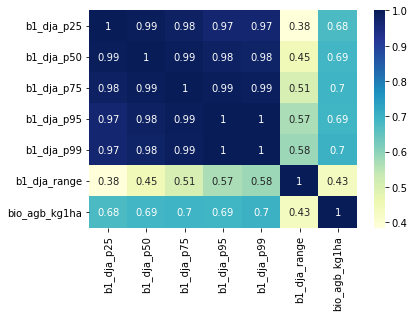

--------------------------------------------------
Comparison relationship:  dja_0911_basal_y
**************************************************
slope:  0.0010767930638308834
intersept:  11.61058953627883
r2:  0.6955161425525092
P_value:  1.8153550448016352e-25
std error:  8.659965543527631e-05


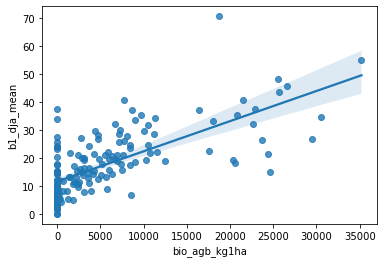

--------------------------------------------------


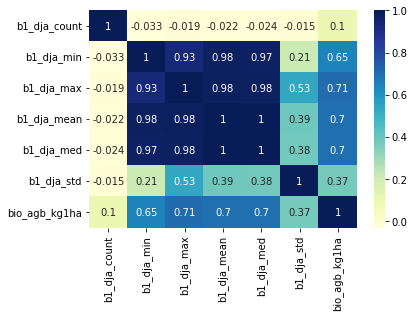

--------------------------------------------------


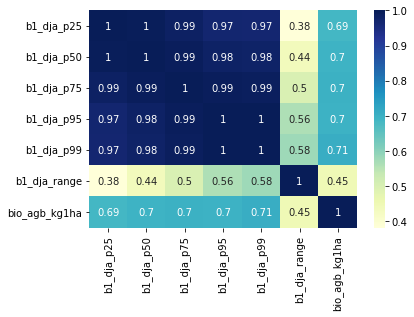

--------------------------------------------------
Comparison relationship:  dja_1202_basal_y
**************************************************
slope:  0.0010814001018213878
intersept:  11.742473390982784
r2:  0.6941995003571387
P_value:  2.435168914453923e-25
std error:  8.728939979179004e-05


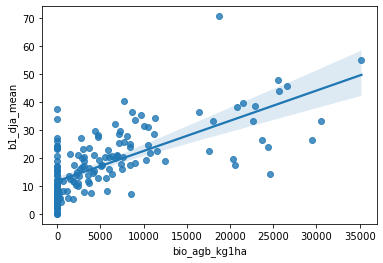

--------------------------------------------------


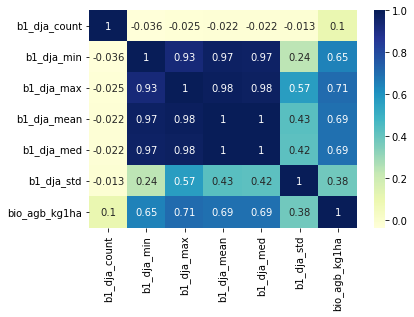

--------------------------------------------------


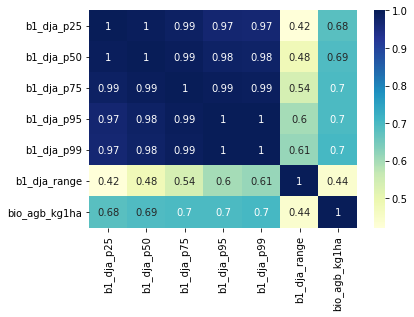

--------------------------------------------------


In [75]:
for df, title in zip([dja_0305_basal_y, dja_0608_basal_y, dja_0911_basal_y, dja_1202_basal_y],
             ["dja_0305_basal_y", "dja_0608_basal_y", "dja_0911_basal_y", "dja_1202_basal_y"]):
    value_x = 'bio_agb_kg1ha'
    value_y = 'b1_dja_mean'
    sns.regplot(x= value_x, y=value_y, data=df)
    slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df[value_x], df[value_y])
    
    print("Comparison relationship: ", title)
    print("*"*50)
    print("slope: ", slope)
    print("intersept: ", intercept)
    print("r2: ", r_value)
    print("P_value: ", p_value)
    print("std error: ", std_err)
    plt.show()
    print('-'*50)
    
    # correlation matrix
    band = 1
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res.append('bio_agb_kg1ha')
    # print(res)
    df1 = df[res]
    # print(df1)

    
    # correlation matrix
    col_names = df.columns.tolist()
    res = [i for i in col_names if f"b{band}" in i]
    res_ = res[:6]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()

    print('-'*50)
    res_ = res[6:]
    res_.append('bio_agb_kg1ha')
    df1 = df[res_]
    # plotting correlation heatmap
    dataplot = sns.heatmap(df1.corr(), cmap="YlGnBu", annot=True)
    plt.show()
    print('-'*50)

https://builtin.com/data-science/poisson-process

https://pyshark.com/poisson-distribution-and-poisson-process-in-python/#:~:text=A%20Poisson%20point%20process%20(or,stochastic)%20process%20in%20one%20dimension.


https://timeseriesreasoning.com/contents/poisson-process/